In [1]:
import numpy as np
import pickle
from copy import deepcopy
from itertools import chain
from collections import OrderedDict
from sklearn.model_selection import train_test_split
import matplotlib.pylab as plt
import torch
import torch.nn as nn
import torch.optim as optim
from torch.autograd import Variable
import matplotlib.pyplot as plt
import pandas as pd
pd.options.display.max_columns = 50
pd.options.display.max_colwidth = 300
from IPython.display import display, HTML
import sys, os
sys.path.append(os.path.join(os.path.dirname("__file__"), '..', '..', '..'))
from mela.prepare_dataset import Dataset_Gen
from mela.util import plot_matrices, make_dir, get_struct_str, get_args, Early_Stopping, record_data, manifold_embedding, get_args, make_dir, sort_two_lists
from mela.settings.filepath import variational_model_PATH
from mela.settings.global_param import COLOR_LIST
from mela.pytorch.net import Net, load_model_dict_net
from mela.pytorch.util_pytorch import to_Variable, to_np_array
from mela.variational.util_variational import sort_datapoints
from mela.variational.variational_meta_learning import Master_Model, Statistics_Net, Generative_Net, load_model_dict
from mela.variational.variational_meta_learning import VAE_Loss, sample_Gaussian, clone_net, get_nets, get_tasks, evaluate, get_reg, load_trained_models, get_relevance
from mela.variational.variational_meta_learning import plot_task_ensembles, plot_individual_tasks, plot_statistics_vs_z, plot_data_record
from mela.variational.variational_meta_learning import plot_few_shot_loss, plot_individual_tasks_bounce
from mela.variational.variational_meta_learning import get_latent_model_data, get_polynomial_class, get_Legendre_class, get_master_function
import torch
import torch.nn as nn
from torch.autograd import Variable

In [5]:
def parse_dict(filename):
    filename_split = filename.split("_")
    data_dict = {}
    filename_split = filename.split("_")
    data_dict["input_size"] = filename_split[filename_split.index("input") + 1]
    data_dict["exp_mode"] = filename_split[1]
    data_dict["statistics_output_neurons"] = filename_split[filename_split.index("stat") + 1]
    data_dict["pre_pooling_neurons"] = filename_split[filename_split.index("pre") + 1]
    data_dict["num_context_neurons"] = filename_split[filename_split.index("context") + 1]
    data_dict["statistics_pooling"] = filename_split[filename_split.index("pool") + 1]
    data_dict["batch_size_task"] = filename_split[filename_split.index("batch") + 1]
    data_dict["num_backwards"] = filename_split[filename_split.index("back") + 1]
    data_dict["is_VAE"] = filename_split[filename_split.index("VAE") + 1]
    data_dict["VAE_beta"] = filename_split[filename_split.index("VAE") + 2]
    data_dict["lr"] = filename_split[filename_split.index("lr") + 1]
    data_dict["reg_amp"] = filename_split[filename_split.index("reg") + 1]
    data_dict["activation_gen"] = filename_split[filename_split.index("actgen") + 1]
    data_dict["activation_model"] = filename_split[filename_split.index("actmodel") + 1]
    data_dict["struct_string"] = filename_split[filename_split.index("struct") + 1]
    data_dict["loss_core"] = filename_split[filename_split.index("core") + 1]
    data_dict["main_hidden_neurons"] = eval(filename_split[filename_split.index("hid") + 1])
    if "uncertainty" in filename_split:
        data_dict["is_uncertainty"] = eval(filename_split[filename_split.index("uncer") + 1])
    optim_mode = filename_split[filename_split.index("struct") + 2]
    if optim_mode in ["sum", "indi"]:
        data_dict["optim_mode"] = optim_mode
    data_dict["exp_id"] = filename_split[filename_split.index("core") + 2]
    data_dict["filename"] = filename
    return data_dict


def load_file(exp_id, filename):
    dirname = variational_model_PATH + "/trained_models/{0}_good/".format(exp_id)
    info_dict = pickle.load(open(dirname + filename, "rb"))
    data_record = info_dict["data_record"]
    data_dict = parse_dict(filename)
    master_model = load_model_dict(info_dict["model_dict"][-1])
    print("\n{0}".format(filename))

    data_dict["mse_few_shot"] = plot_few_shot_loss(master_model, tasks_test)
    plot_data_record(info_dict["data_record"], is_VAE = is_VAE)
    data_dict["mean_last"] = np.mean(data_record['mse_mean_test'][-6:-1])
    data_dict["median_last"] = np.mean(data_record['mse_median_test'][-6:-1])
    data_dict["mean_min"] = np.min(data_record['mse_mean_test'])
    data_dict["median_min"] = np.min(data_record['mse_median_test'])
    print("mean_last: {0:6f}\tmean_min: {1:.6f}\tmedian_last: {2:.6f}\tmedian_min: {3:.6f}".format(data_dict["mean_last"], data_dict["mean_min"], data_dict["median_last"], data_dict["median_min"]))
    statistics_list_test, z_list_test = plot_task_ensembles(tasks_test, master_model.statistics_Net, master_model.generative_Net, is_VAE = is_VAE, title = "y_pred_test vs. y_test")
    print("test statistics vs. z:")
    data_dict["corr_info"] = plot_statistics_vs_z(z_list_test, statistics_list_test)
    if "bounce" in task_id_list[0]:
        plot_individual_tasks_bounce(tasks_test, num_examples_show = 40, num_tasks_show = 9, master_model = master_model, num_shots = 200)
    else:
        _ = plot_individual_tasks(tasks_test, master_model.statistics_Net, master_model.generative_Net, is_VAE = is_VAE, xlim = task_settings["xlim"])
    return master_model, info_dict, data_dict


# See the general performance of all
def load_df(exp_id, min_shots = None):
    dirname = variational_model_PATH + "/trained_models/{0}_good/".format(exp_id)
    data_dict_list = []
    for filename in os.listdir(dirname):
        if "info" not in filename:
            continue
        try:
            info_dict = pickle.load(open(dirname + filename, "rb"))
        except:
            print("Cannot load {0}".format(filename))
        data_record = info_dict["data_record"]
        data_dict = parse_dict(filename)
        if data_dict["exp_mode"] == "meta": 
            model = load_model_dict(info_dict["model_dict"][-1])
            data_dict["mse_few_shot"] = plot_few_shot_loss(model, tasks_test, min_shots = min_shots)
        elif data_dict["exp_mode"] == "baseline":
            print(filename)
            model = load_model_dict_net(info_dict["model_dict"][-1])
            data_dict["mse_few_shot"] = [None]
        print("\n{0}".format(filename))

        
        plot_data_record(info_dict["data_record"], is_VAE = is_VAE)
        data_dict["mean_last"] = np.mean(data_record['mse_mean_test'][-4:-1])
        data_dict["median_last"] = np.mean(data_record['mse_median_test'][-4:-1])
        data_dict["mean_min"] = np.min(data_record['mse_mean_test'])
        data_dict["median_min"] = np.min(data_record['mse_median_test'])
        print("mean_last: {0:6f}\tmean_min: {1:.6f}\tmedian_last: {2:.6f}\tmedian_min: {3:.6f}".format(data_dict["mean_last"], data_dict["mean_min"], data_dict["median_last"], data_dict["median_min"]))
        if data_dict["exp_mode"] == "meta": 
            statistics_list_test, z_list_test = plot_task_ensembles(tasks_test, model.statistics_Net, model.generative_Net, is_VAE = is_VAE, title = "y_pred_test vs. y_test")
            print("test statistics vs. z:")
            data_dict["corr_info"] = plot_statistics_vs_z(z_list_test, statistics_list_test)
        if "bounce" in task_id_list[0]:
            if data_dict["exp_mode"] == "meta": 
                plot_individual_tasks_bounce(tasks_test, num_examples_show = 40, num_tasks_show = 9, master_model = model, num_shots = 200)
            elif data_dict["exp_mode"] == "baseline":
                plot_individual_tasks_bounce(tasks_test, num_examples_show = 40, num_tasks_show = 9, model = model, num_shots = 200)
        else:
            _ = plot_individual_tasks(tasks_test, master_model.statistics_Net, master_model.generative_Net, is_VAE = is_VAE, xlim = task_settings["xlim"])
        data_dict_list.append(data_dict)
    df = pd.DataFrame(data_dict_list)
    df = df.sort_values(by = "median_last")
    return df

## New test tasks with step_dt = 1

In [ ]:
task_id_list = [
# "latent-linear",
# "polynomial-3",
# "Legendre-3",
# "M-sawtooth",
# "M-sin",
# "M-Gaussian",
# "M-tanh",
# "M-softplus",
"bounce-states",
# "bounce-images",
]
input_size = 6
task_settings = {
    "num_examples": 1000,
    "test_size": 0.5
}
is_VAE = False
print("task_settings:\n", task_settings)
num_test_tasks = 10
tasks_train, tasks_test = get_tasks(task_id_list, 1, num_test_tasks, task_settings = task_settings, 
                                    is_flatten = True, bounce_focus = False, normalize = False,
                                    translation = None)

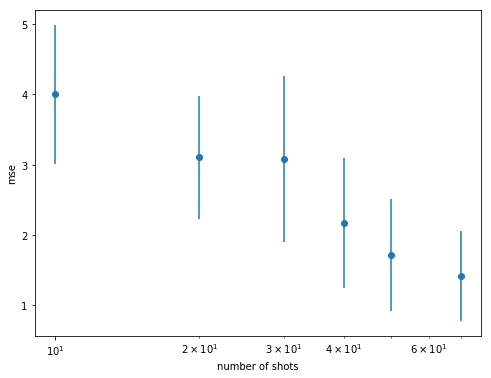

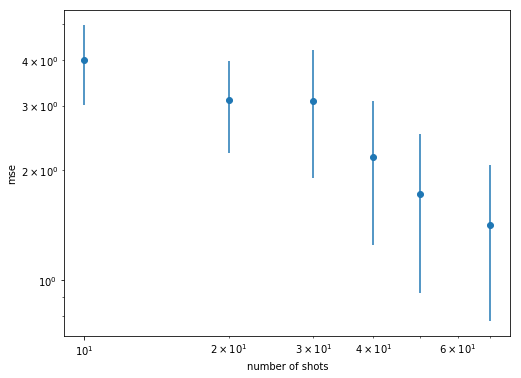


Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_relu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p


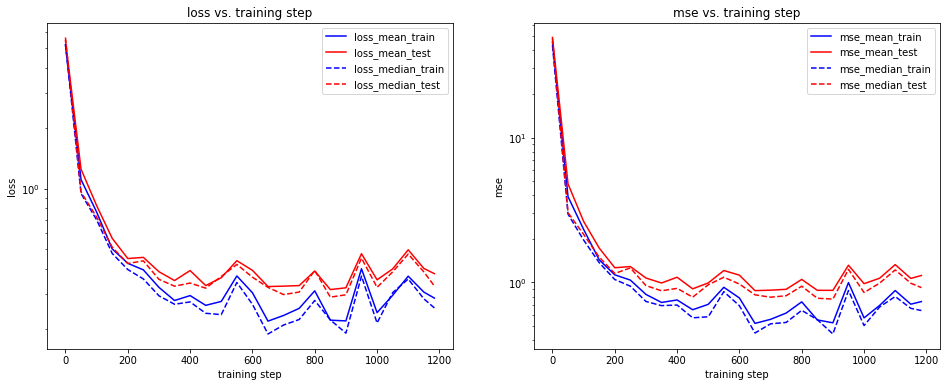

mean_last: 1.154874	mean_min: 0.878365	median_last: 1.066271	median_min: 0.767482


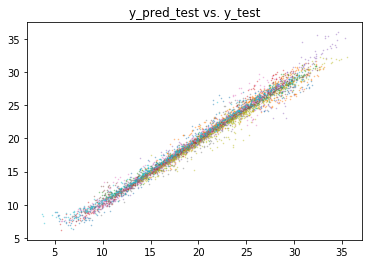

test statistics vs. z:


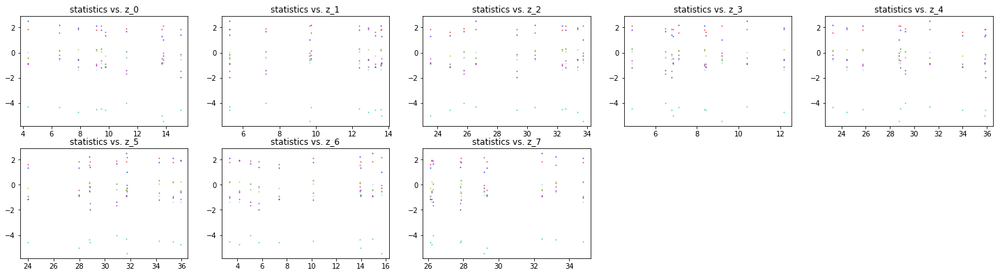

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


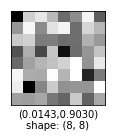


statistics correlation matrix:


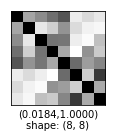


pca explained variance ratio:
[ 0.41102916  0.28534123  0.14437833  0.09733899  0.02329544  0.02097904
  0.01274518  0.00489262]


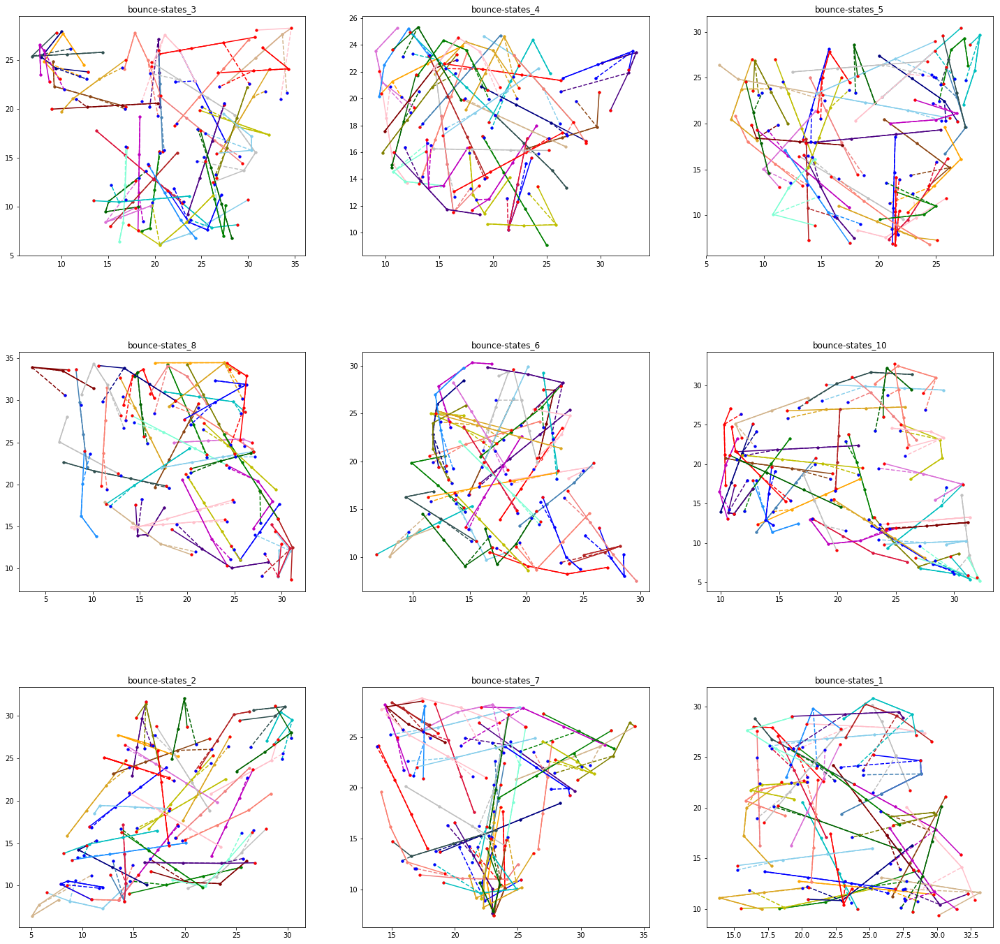

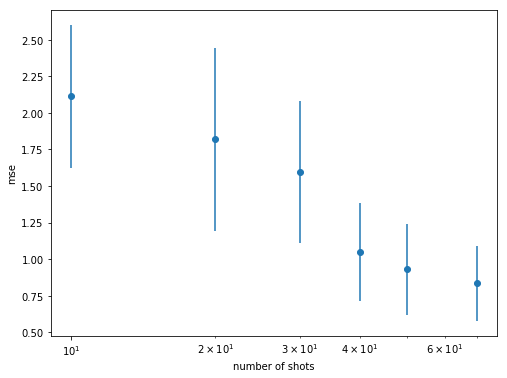

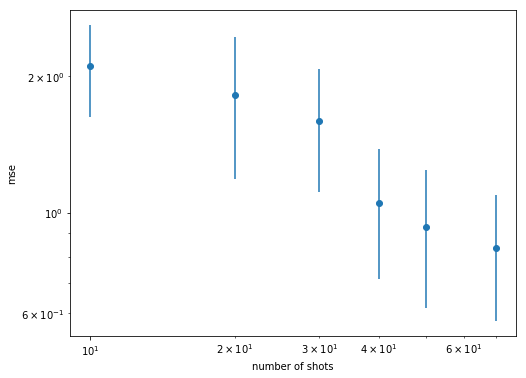


Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_relu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p


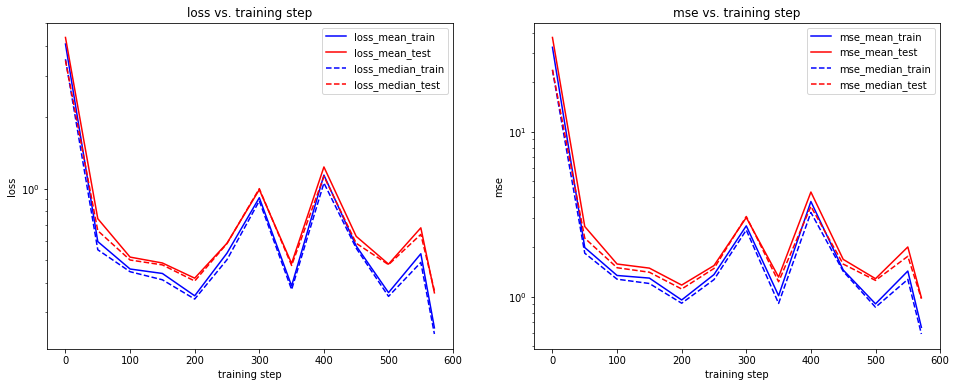

mean_last: 1.657191	mean_min: 0.985669	median_last: 1.529774	median_min: 0.973898


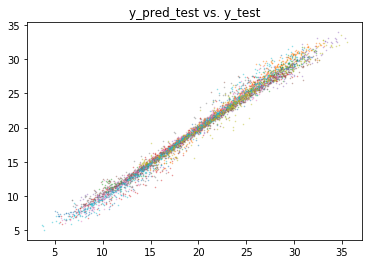

test statistics vs. z:


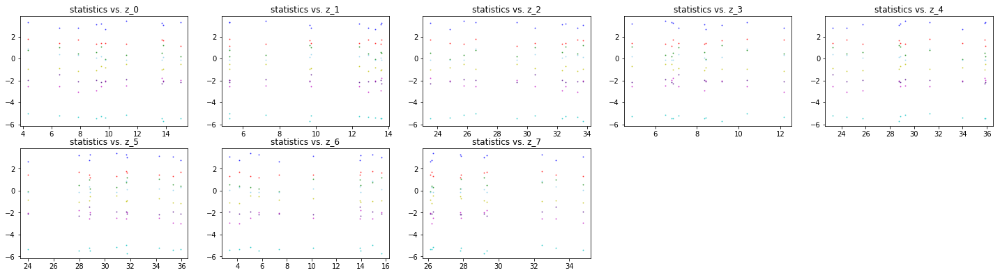

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


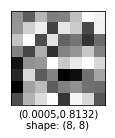


statistics correlation matrix:


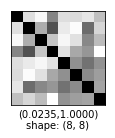


pca explained variance ratio:
[ 0.41632059  0.23105466  0.1336035   0.09884853  0.08179785  0.01959401
  0.0135316   0.00524929]


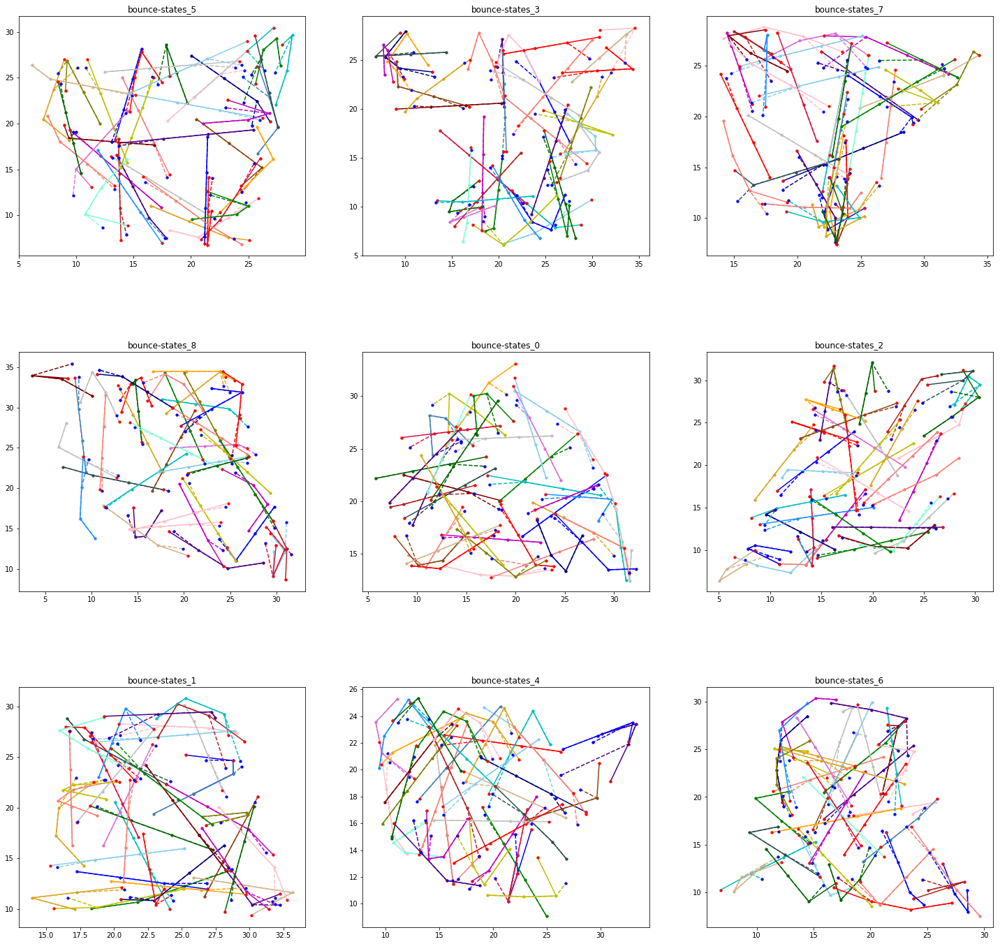

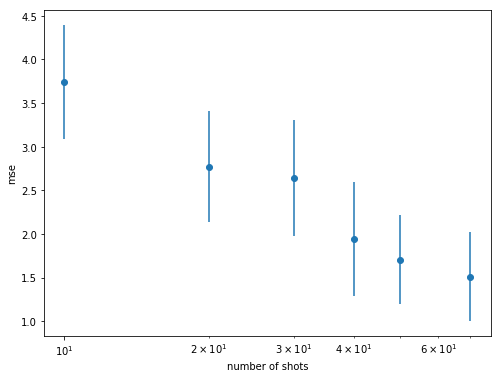

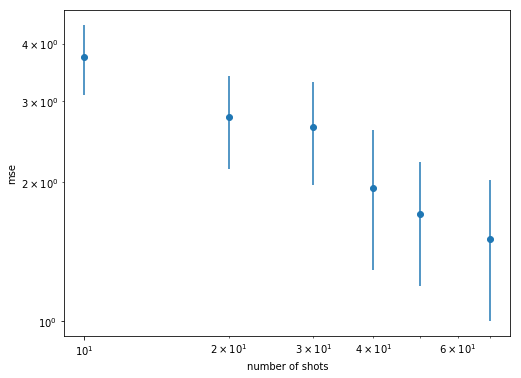


Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_mse_comparisonMay7_info.p


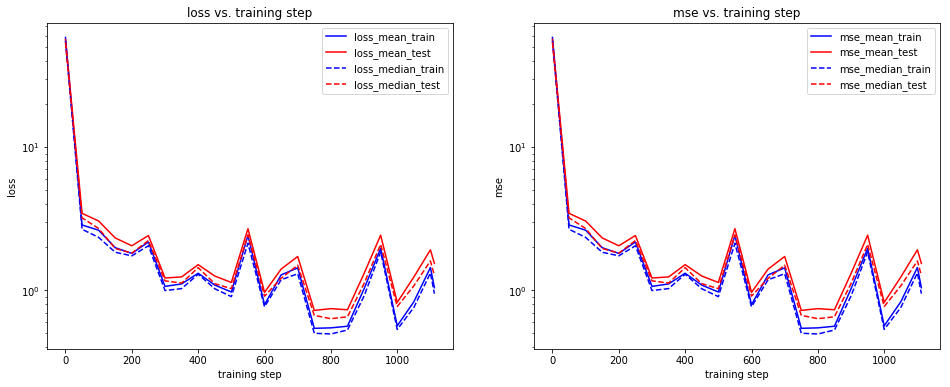

mean_last: 1.326242	mean_min: 0.724036	median_last: 1.149550	median_min: 0.633975


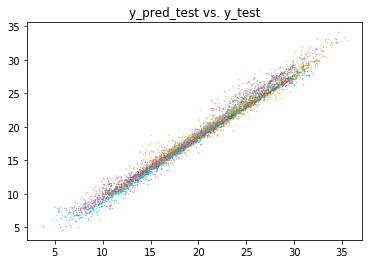

test statistics vs. z:


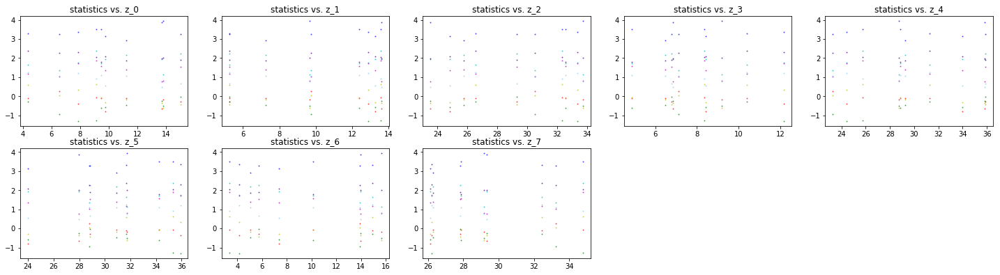

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


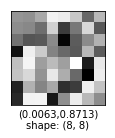


statistics correlation matrix:


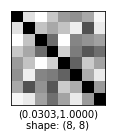


pca explained variance ratio:
[ 0.44338647  0.25283539  0.12336636  0.07707011  0.05997374  0.03024233
  0.00965495  0.00347064]


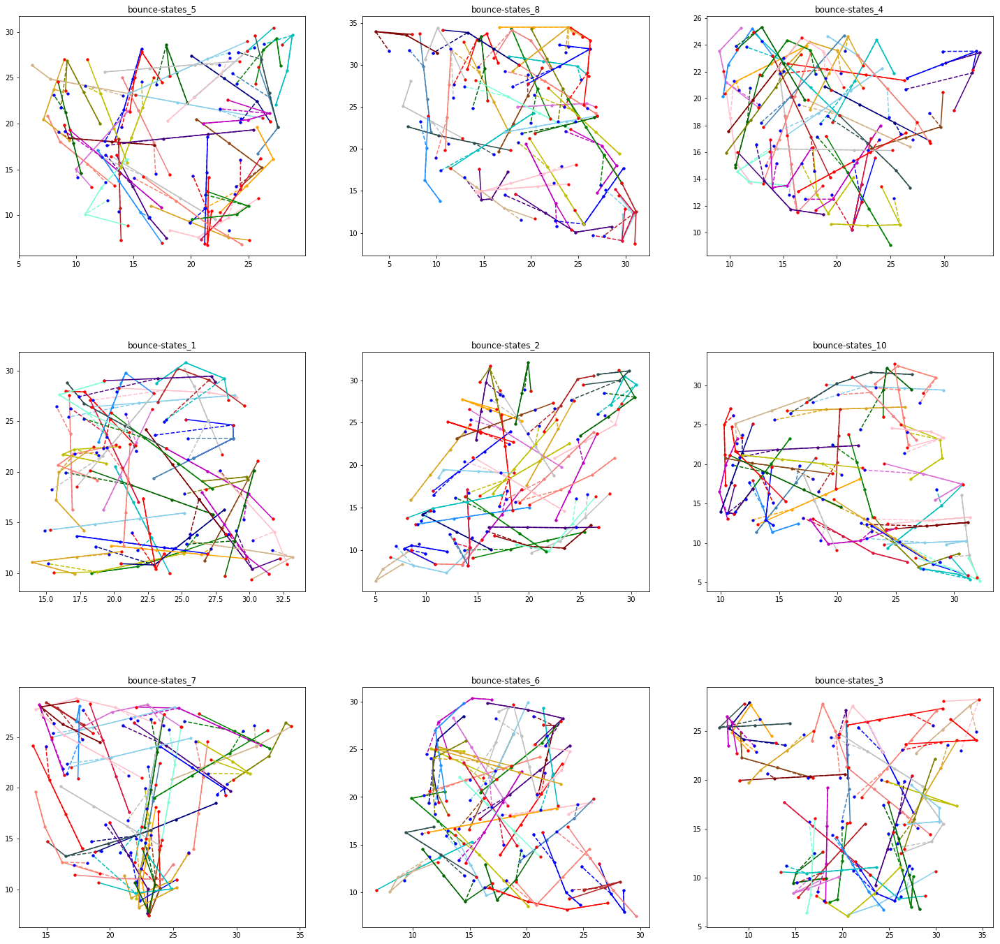

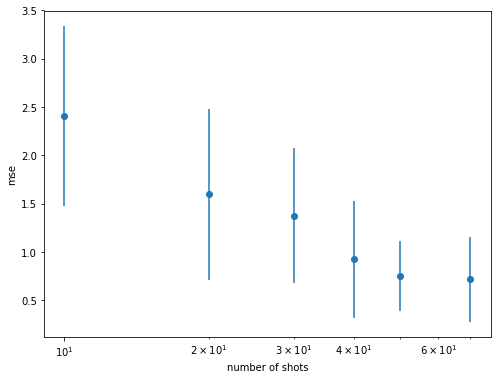

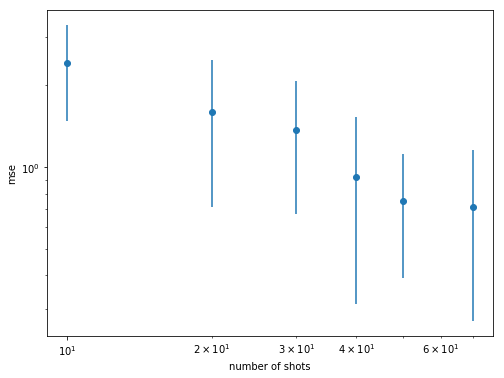


Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p


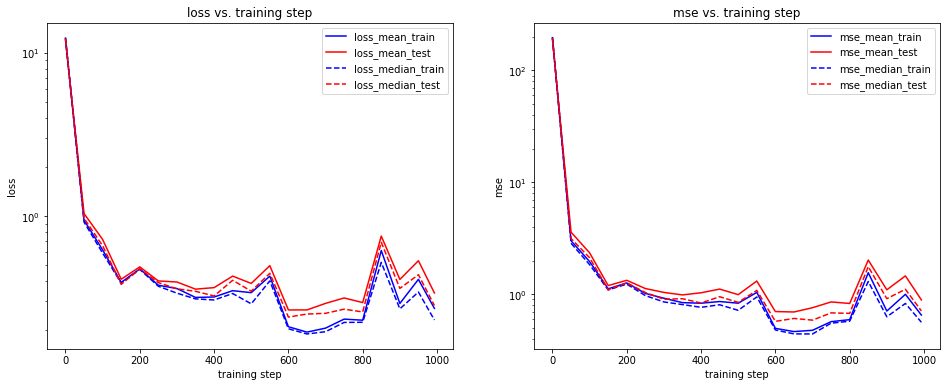

mean_last: 1.525427	mean_min: 0.694665	median_last: 1.262143	median_min: 0.573012


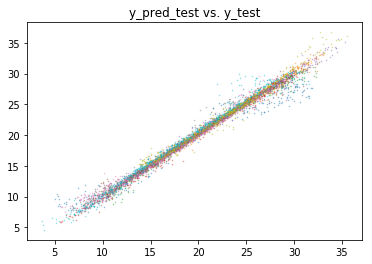

test statistics vs. z:


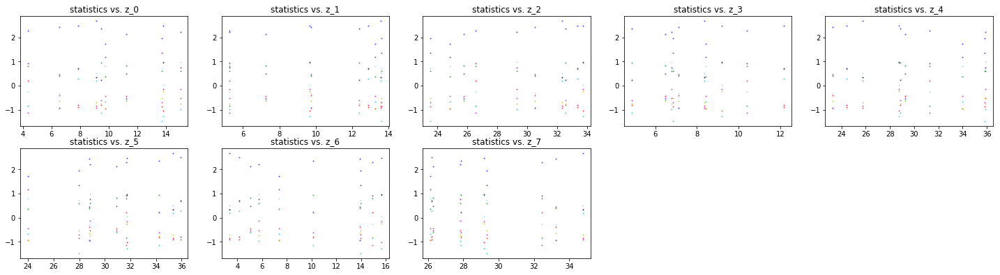

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


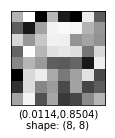


statistics correlation matrix:


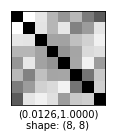


pca explained variance ratio:
[ 0.39059705  0.28944573  0.13374896  0.09198296  0.04244138  0.02453538
  0.02181198  0.00543662]


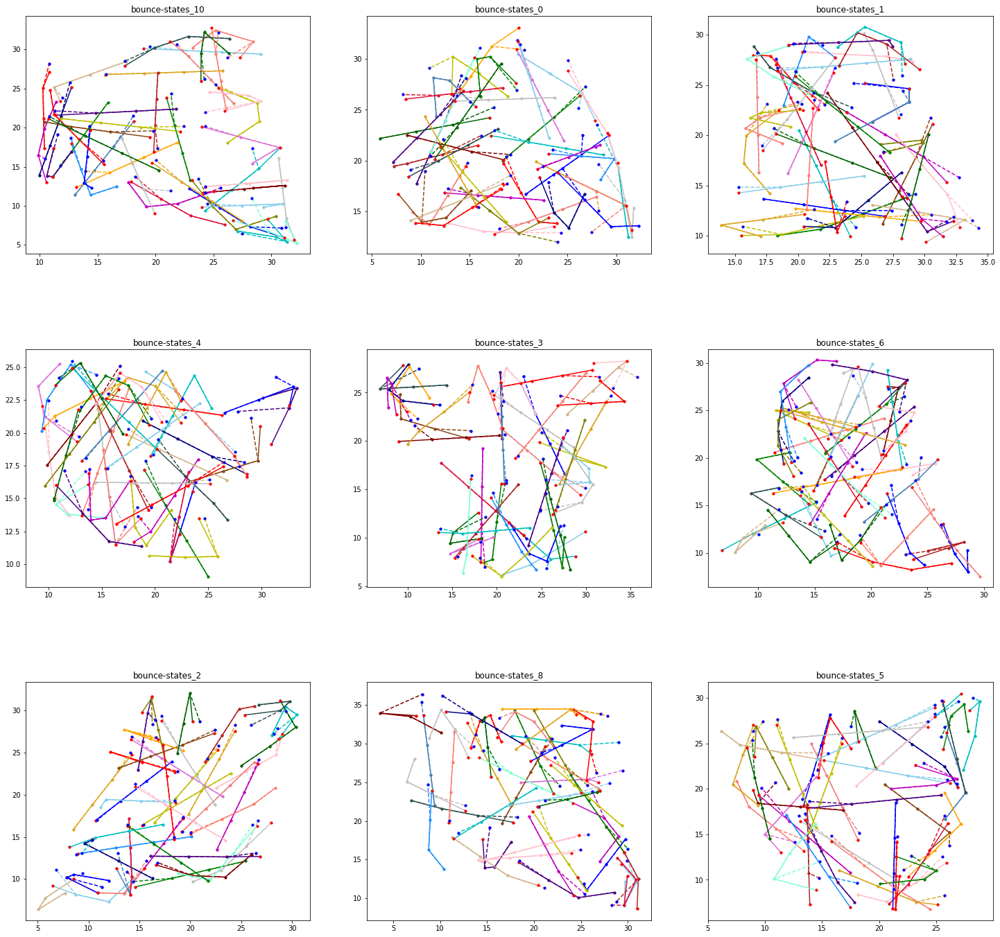

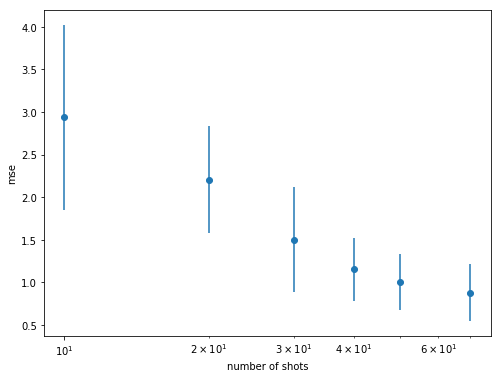

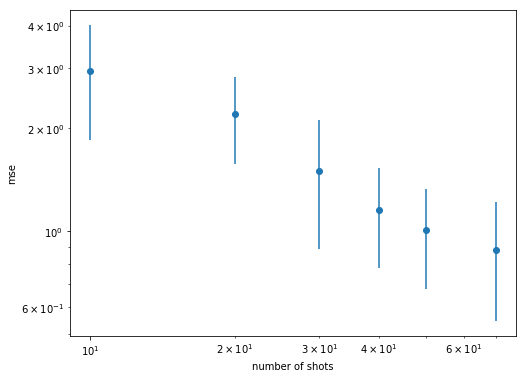


Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p


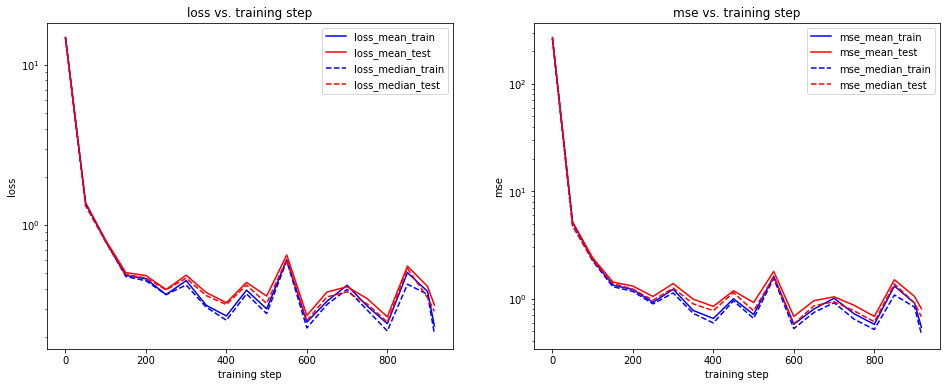

mean_last: 1.078724	mean_min: 0.683999	median_last: 0.965813	median_min: 0.583130


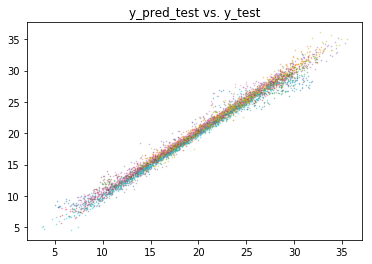

test statistics vs. z:


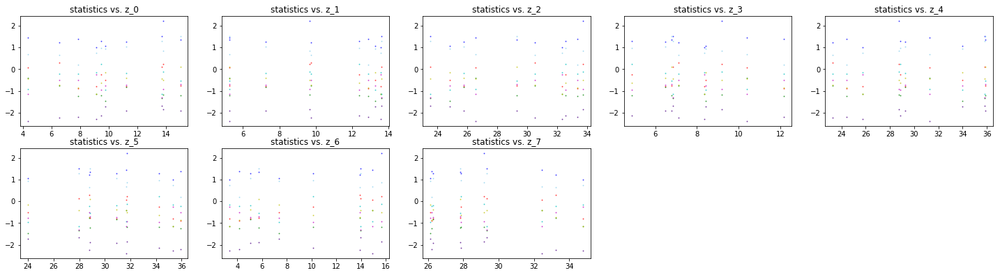

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


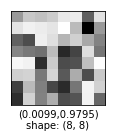


statistics correlation matrix:


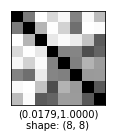


pca explained variance ratio:
[ 0.38769296  0.26758313  0.14096674  0.08753633  0.05874531  0.02849612
  0.02117455  0.00780489]


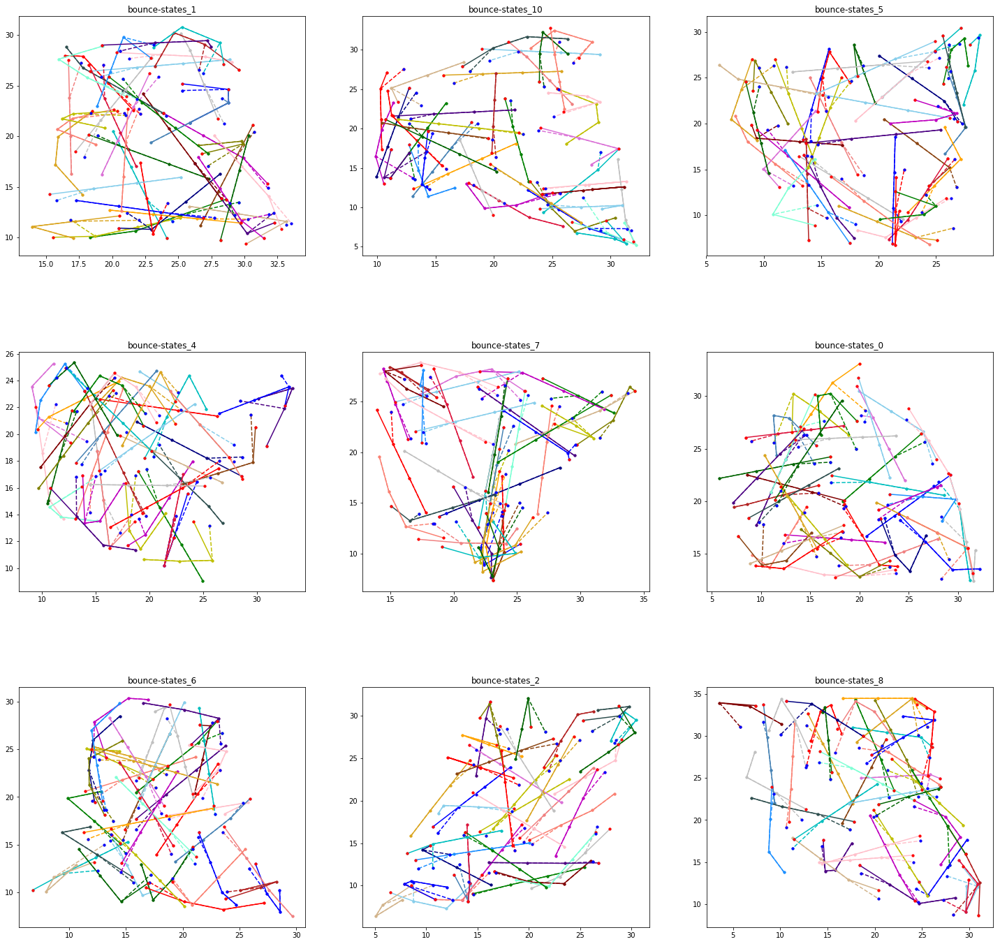

Net_baseline_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p

Net_baseline_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p


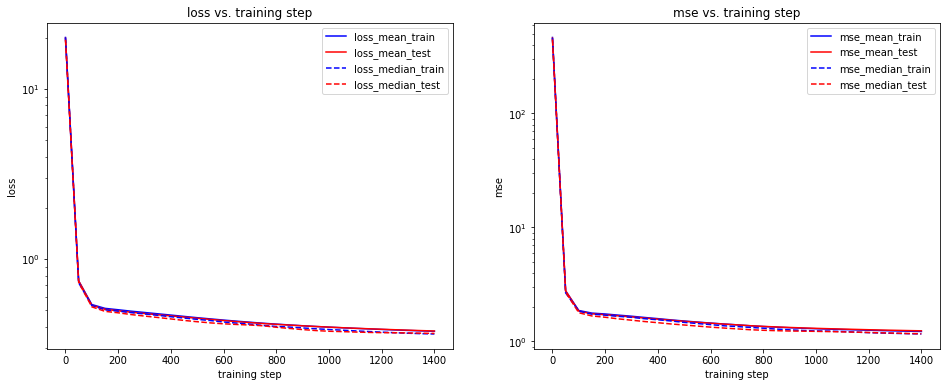

mean_last: 1.252277	mean_min: 1.239611	median_last: 1.182145	median_min: 1.168309


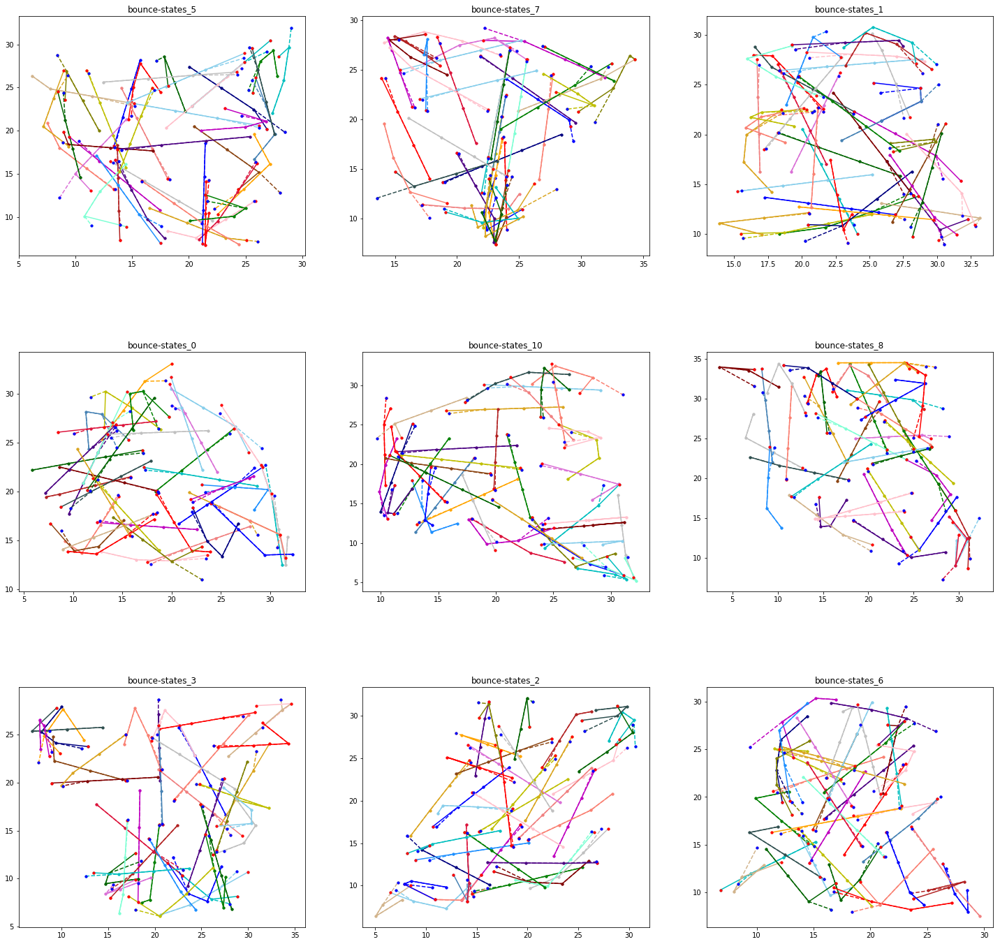

Net_baseline_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_relu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p

Net_baseline_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_relu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p


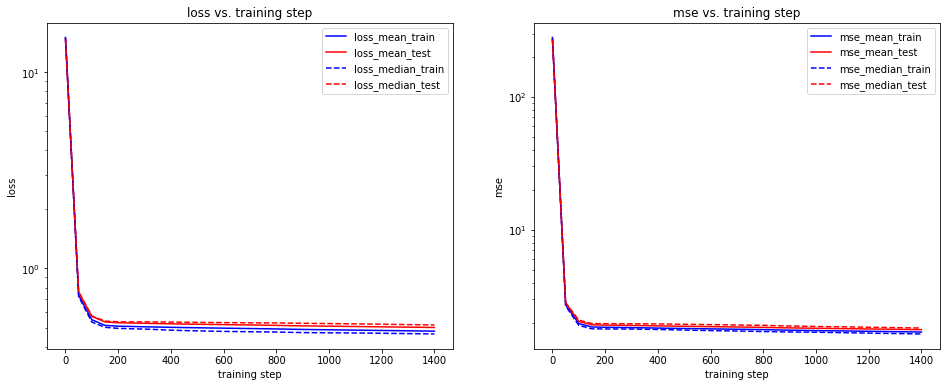

mean_last: 1.781114	mean_min: 1.769869	median_last: 1.832587	median_min: 1.820343


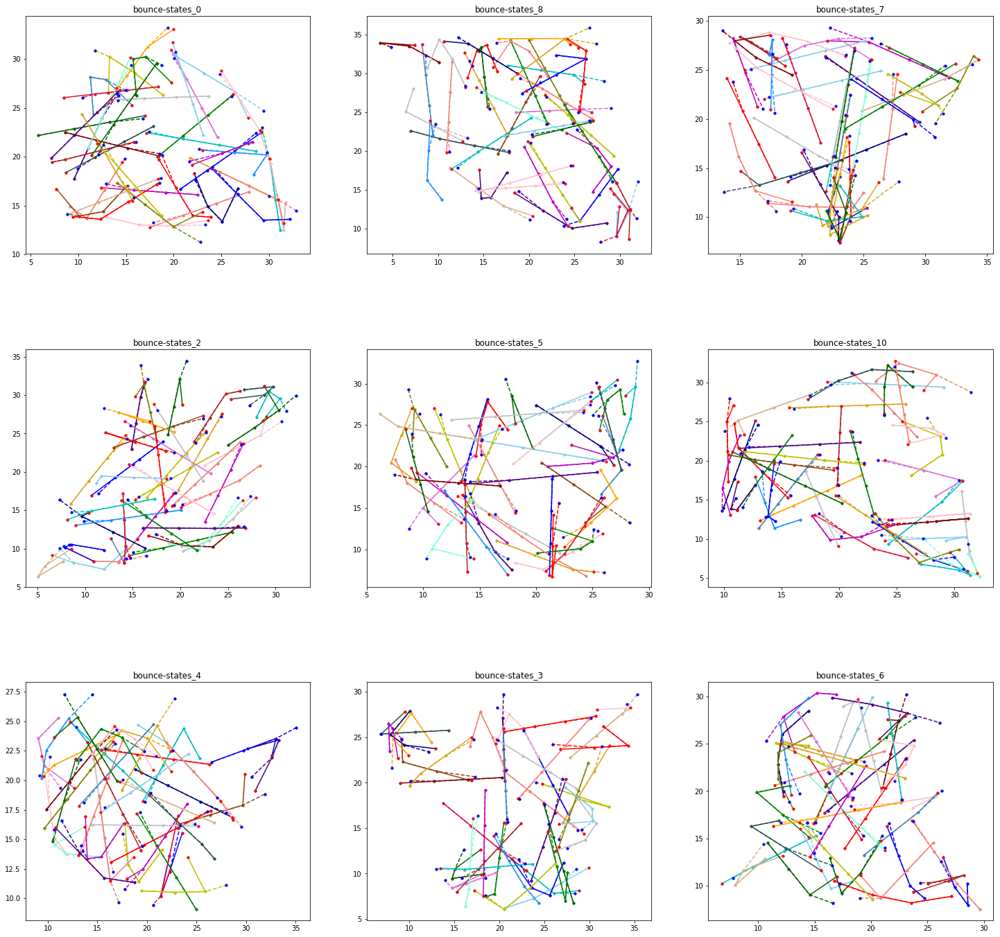

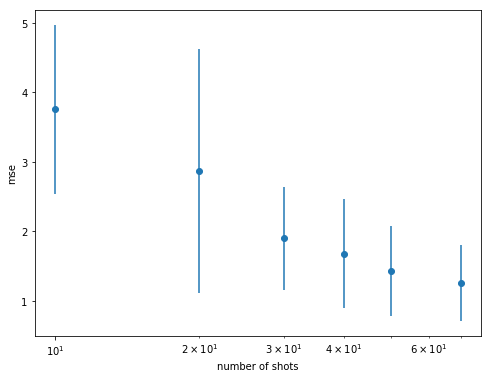

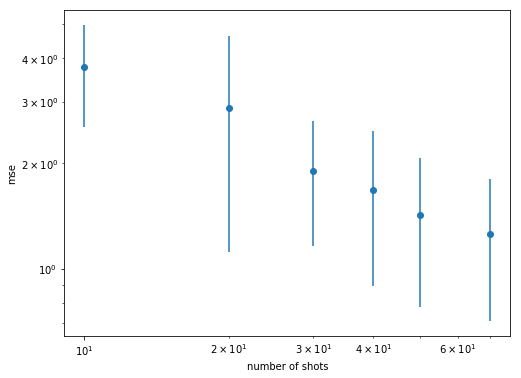


Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(80, 80, 80)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_2e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p


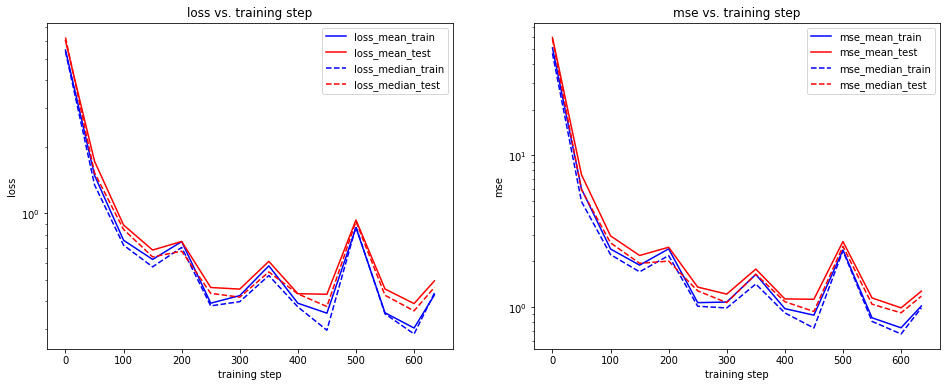

mean_last: 1.612917	mean_min: 0.988116	median_last: 1.491544	median_min: 0.917082


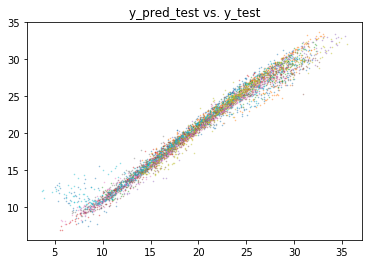

test statistics vs. z:


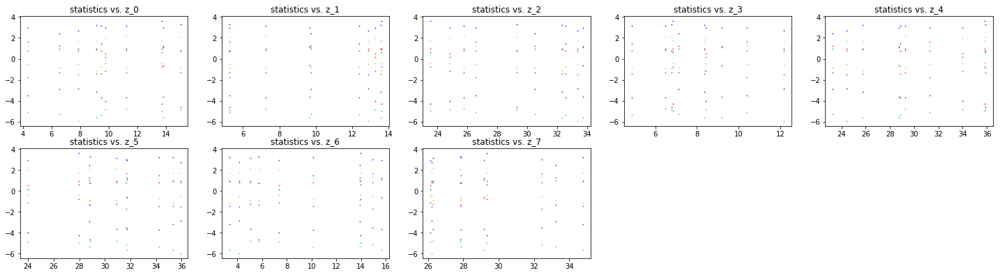

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


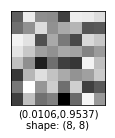


statistics correlation matrix:


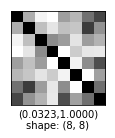


pca explained variance ratio:
[ 0.54155862  0.12689997  0.11675747  0.10355469  0.05171466  0.02807917
  0.02054402  0.01089136]


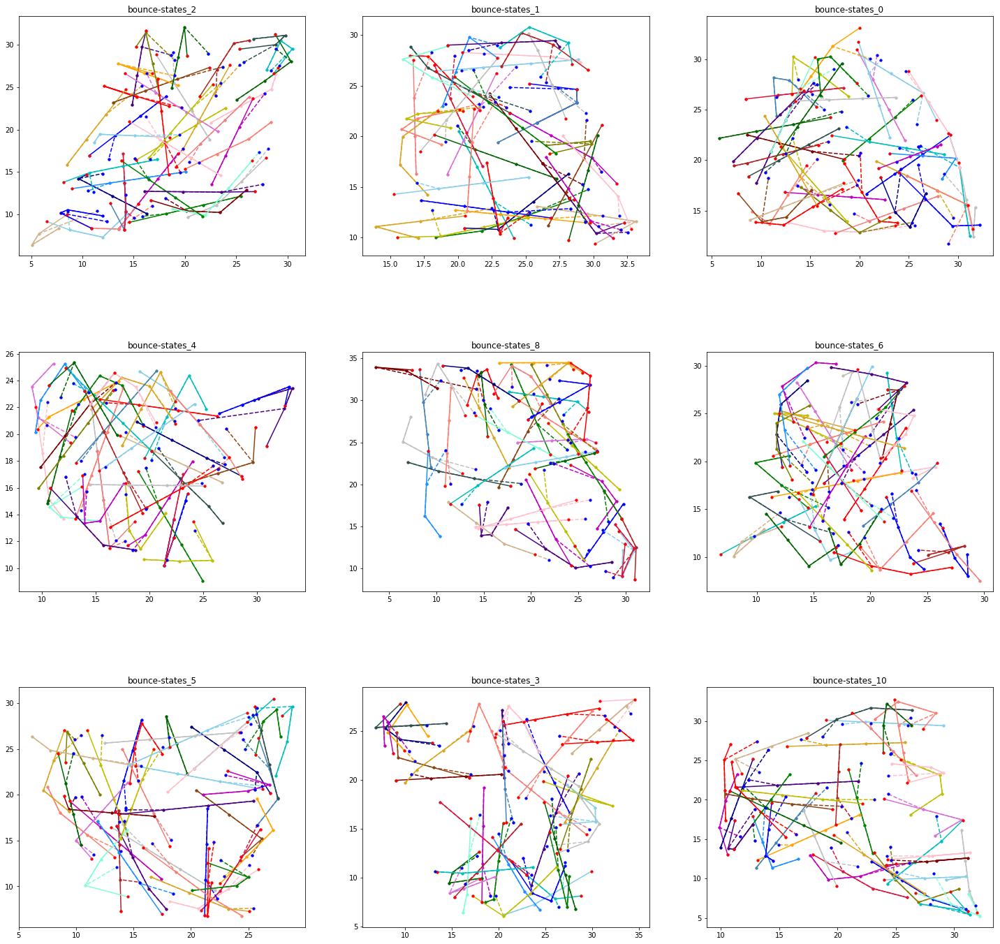

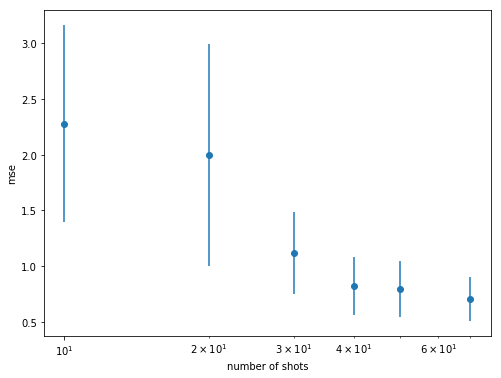

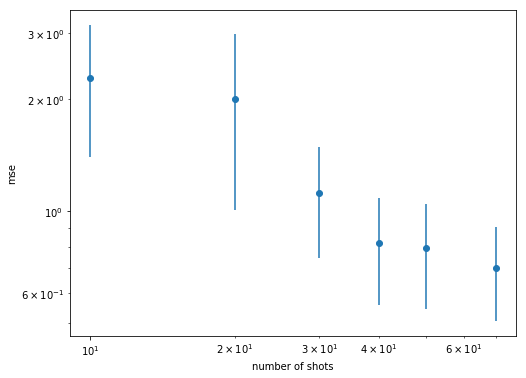


Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_8_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p


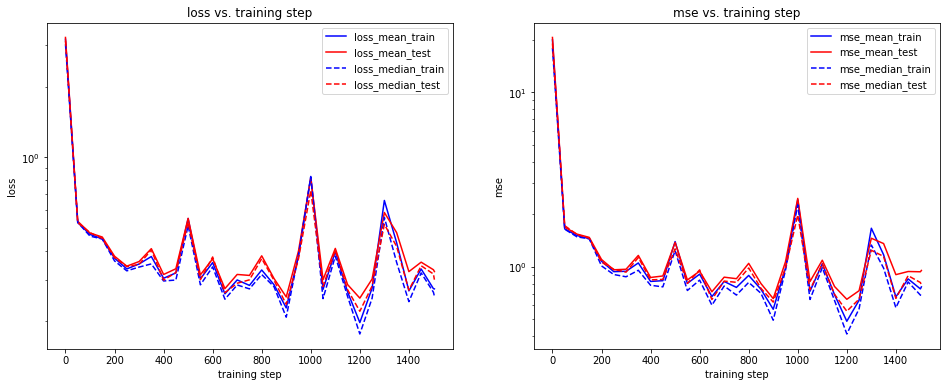

mean_last: 0.924285	mean_min: 0.650016	median_last: 0.785512	median_min: 0.555196


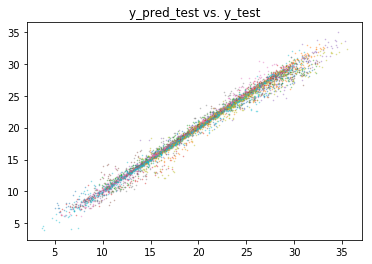

test statistics vs. z:


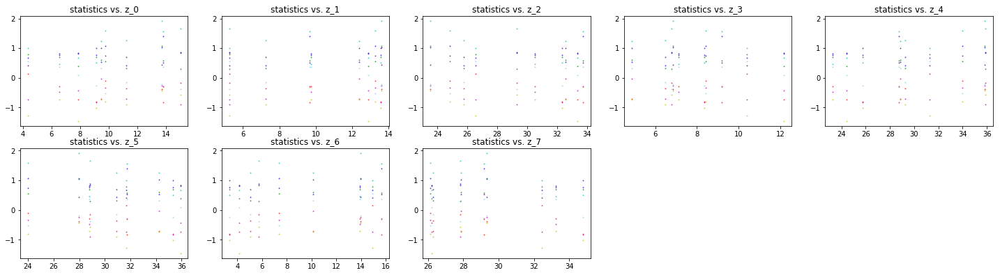

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


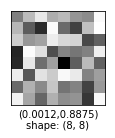


statistics correlation matrix:


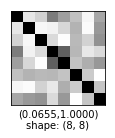


pca explained variance ratio:
[ 0.43496364  0.19733413  0.15719944  0.07069274  0.05607126  0.04701864
  0.02973791  0.00698222]


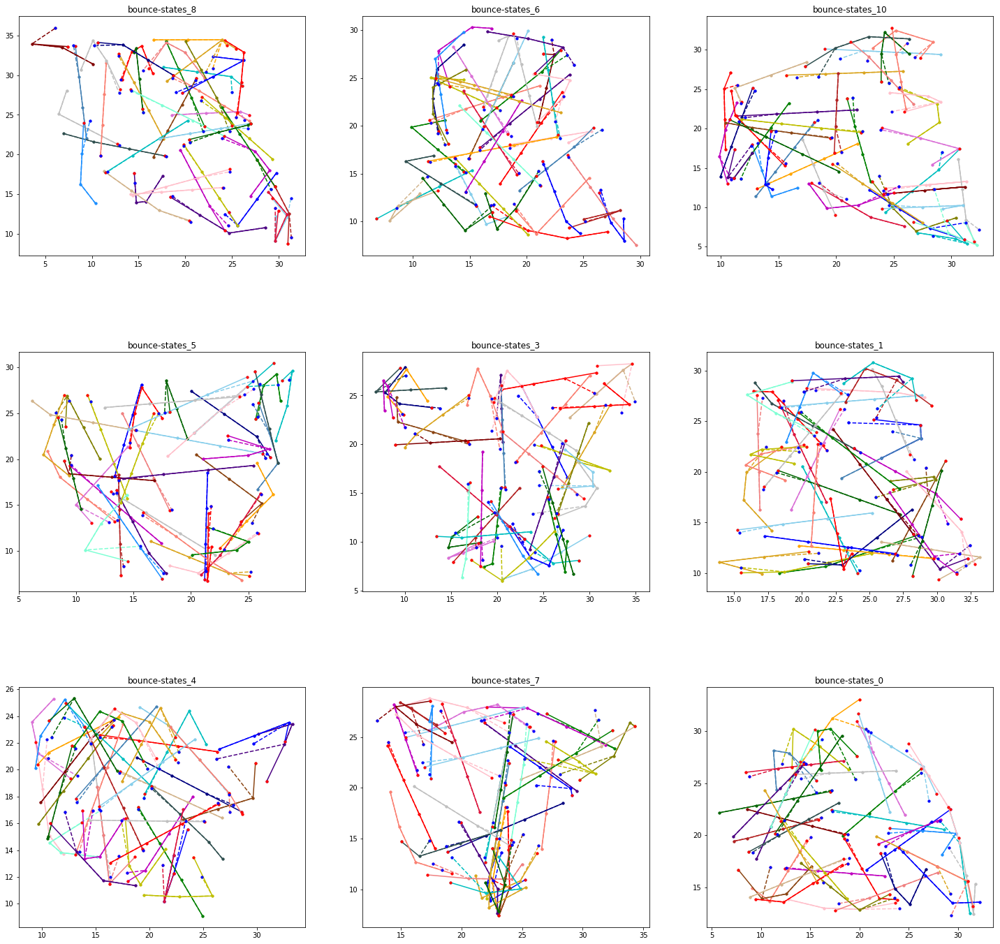

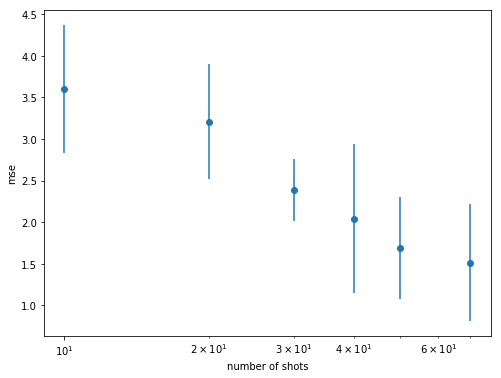

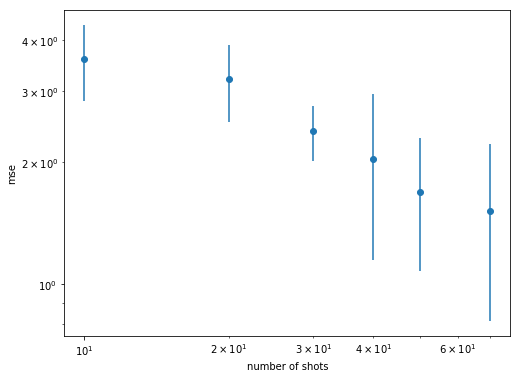


Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p


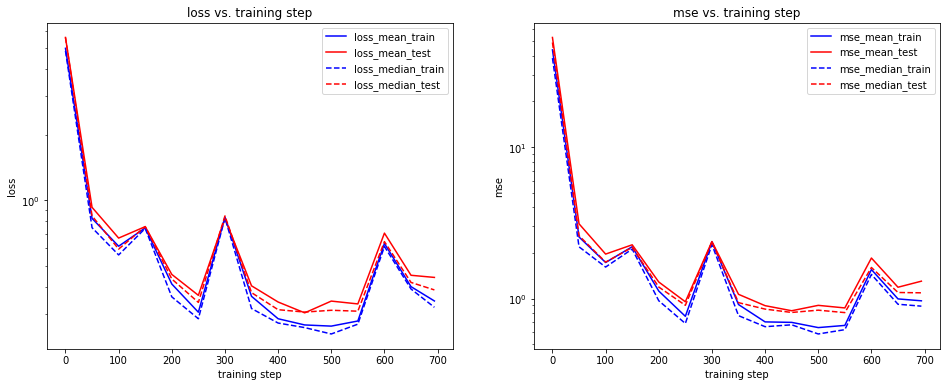

mean_last: 1.301608	mean_min: 0.830543	median_last: 1.168854	median_min: 0.807290


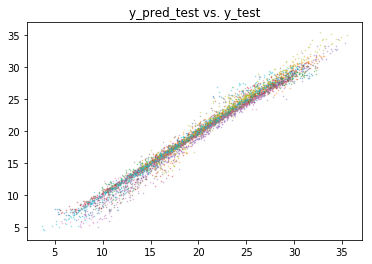

test statistics vs. z:


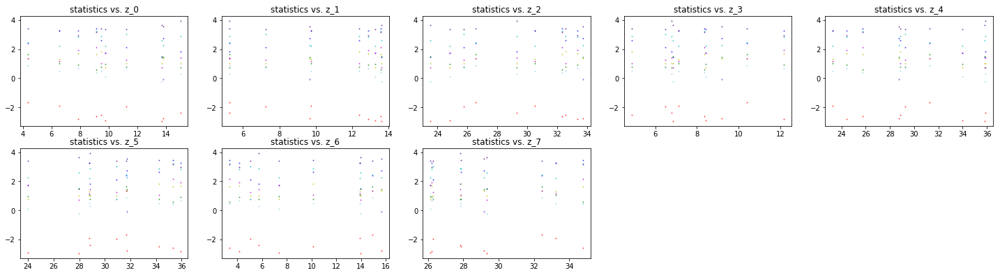

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


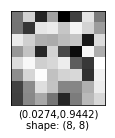


statistics correlation matrix:


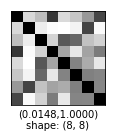


pca explained variance ratio:
[ 0.46253192  0.24256392  0.15708262  0.07388891  0.03523891  0.01401732
  0.01142604  0.00325033]


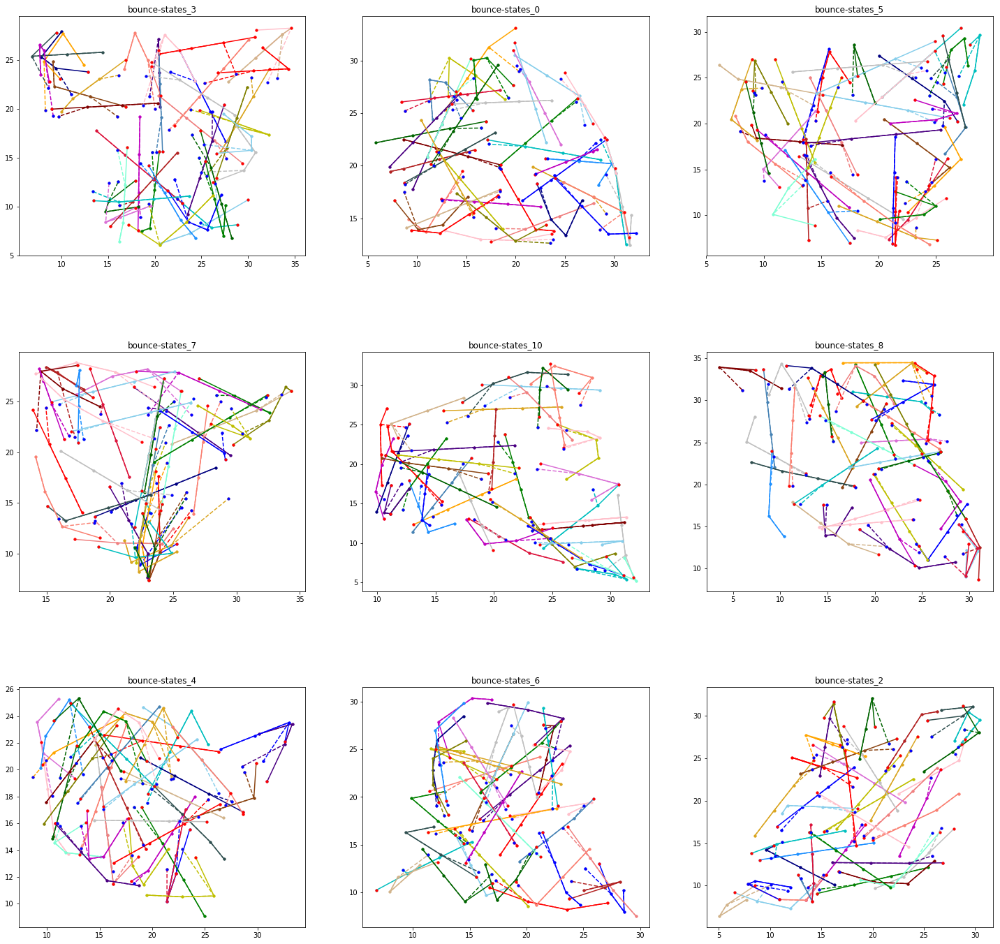

Cannot load Net_baseline_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_8_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_1e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p
Net_baseline_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_8_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_1e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p


Exception: net_type Master_Model not recognized!

In [6]:
exp_id = "May7bounce"  # First experiment
df = load_df(exp_id, min_shots = 50)

In [ ]:
filename = "Net_baseline_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_mse_comparisonMay7_info.p"
A = load_file(exp_id , filename)

## Obtain testing tasks:

In [ ]:
# exp_id = "May2"
# filename = "Net_['master_tanh']_input_1_(100,100)_statistics-neurons_4_pre_100_pooling_max_context_0_batch_100_backward_1_VAE_False_0.2_uncertainty_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_individual_core_huber_test2_info"

# exp_id = "May3"
# filename = "Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info"

# dirname = variational_model_PATH + "/trained_models/{0}_good/".format(exp_id)
# filename = dirname + filename
# is_model_dict = True
# if is_model_dict:
#     info_dict = pickle.load(open(filename + ".p", "rb"))
#     master_model = load_model_dict(info_dict["model_dict"][-1])
#     data_record = info_dict["data_record"]
# else:
#     statistics_Net, generative_Net, data_record = load_trained_models(filename)

task_id_list = [
# "latent-linear",
# "polynomial-3",
# "Legendre-3",
# "M-sawtooth",
# "M-sin",
# "M-Gaussian",
# "M-tanh",
# "M-softplus",
"bounce-states",
# "bounce-images",
]
input_size = 6
task_settings = {
    "zdim": 1,
    "z_settings": ["Gaussian", (0, 1)],
    "num_layers": 1,
    "xlim": (-4, 4),
    "activation": "softplus",
    "input_size": input_size,
    "num_examples": 2000,
}
print("task_settings:\n", task_settings)
is_VAE = False
is_uncertainty_net = False
num_test_tasks = 10
task_settings["num_examples"] = 2000
task_settings["test_size"] = 0.2
tasks_train, tasks_test = get_tasks(task_id_list, 1, num_test_tasks, task_settings = task_settings, step_dt = 0.5, is_flatten = True, bounce_focus = False, normalize = False)

## General performance:


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


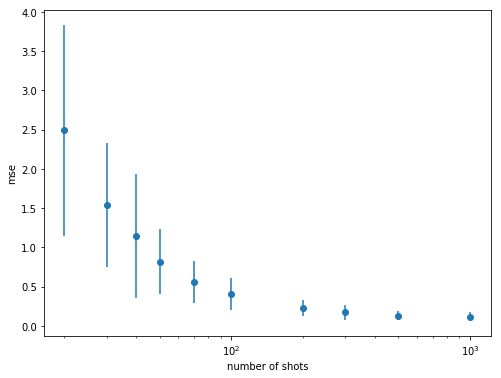

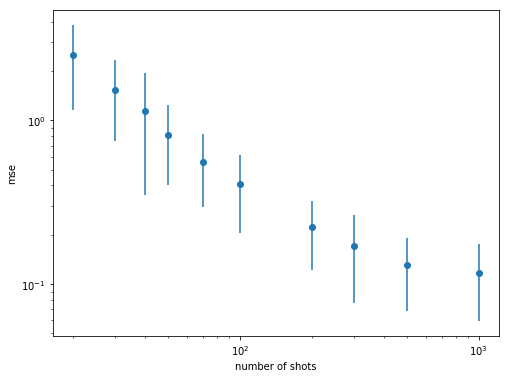

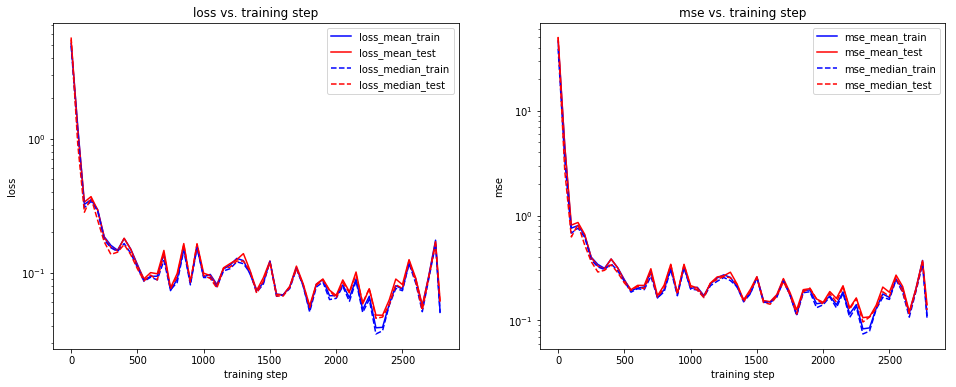

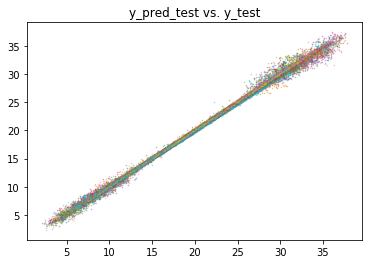

test statistics vs. z:


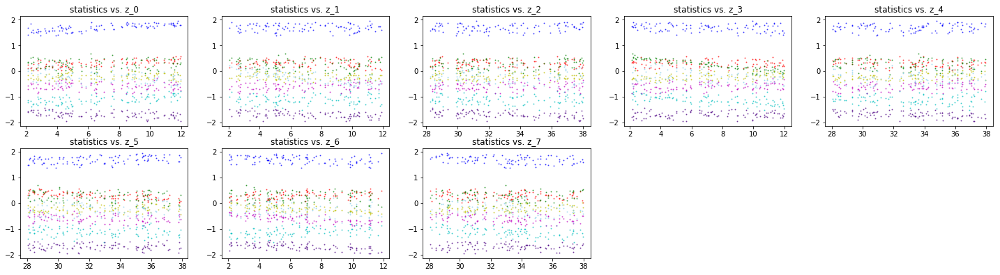

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


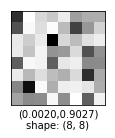


statistics correlation matrix:


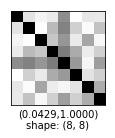


pca explained variance ratio:
[ 0.34906667  0.25864589  0.12558416  0.09799621  0.06532655  0.04728382
  0.04128087  0.01481584]


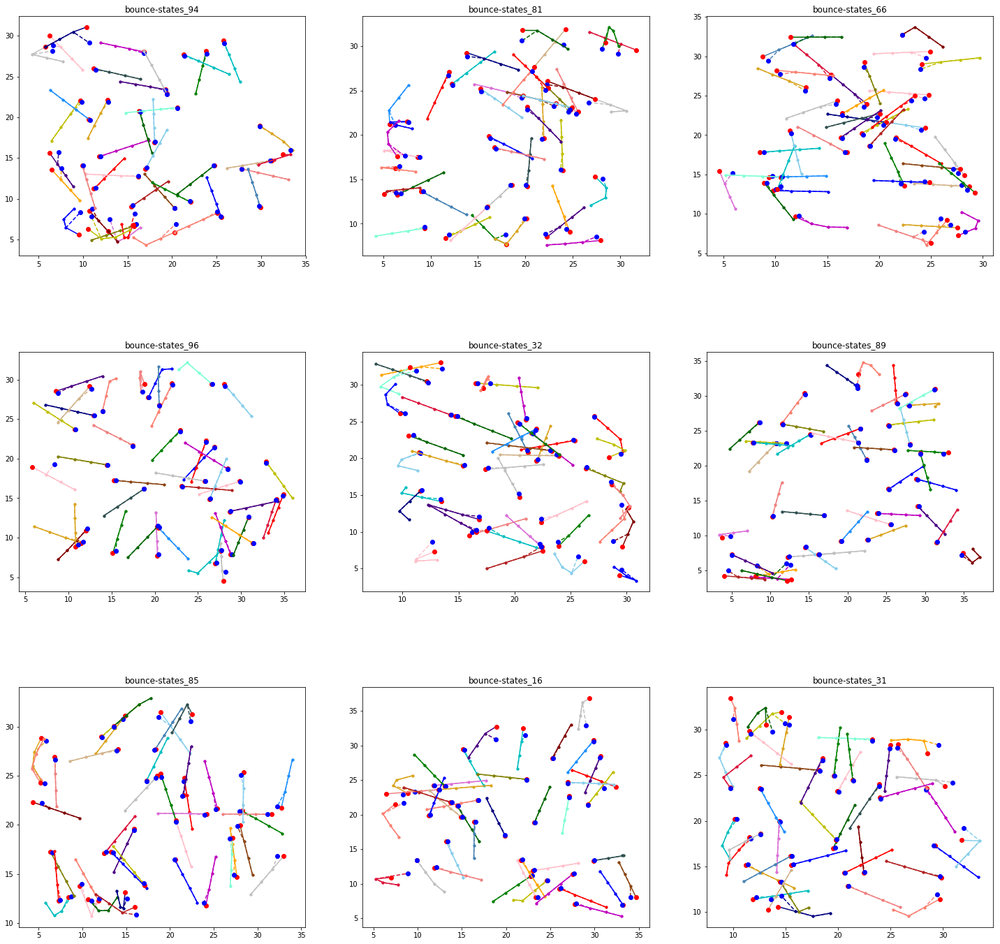


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(20, 20)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


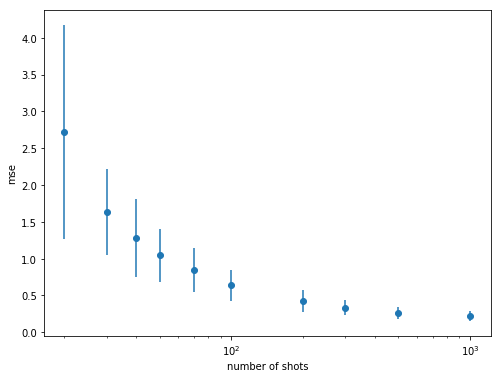

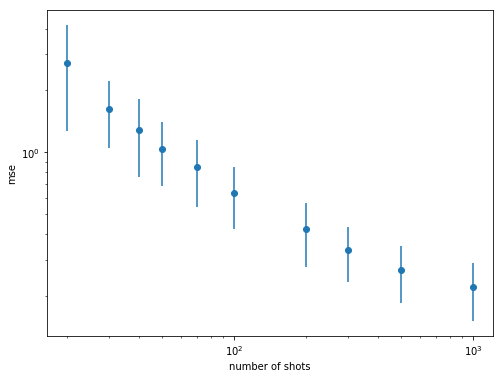

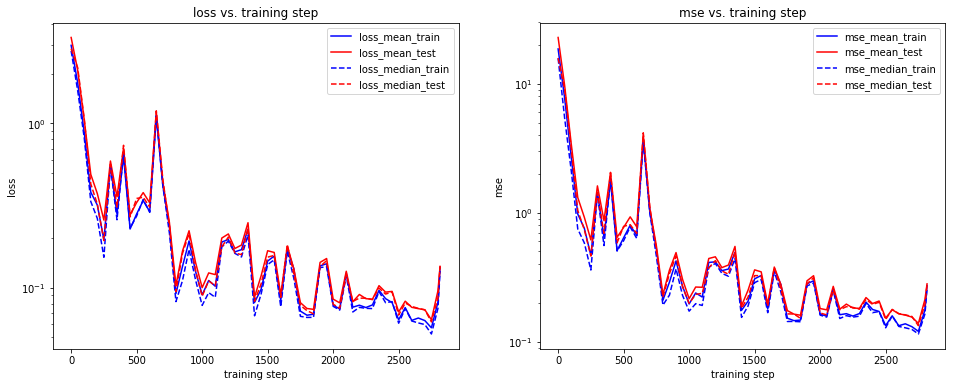

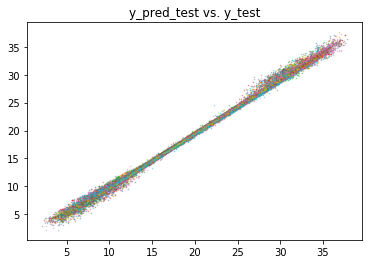

test statistics vs. z:


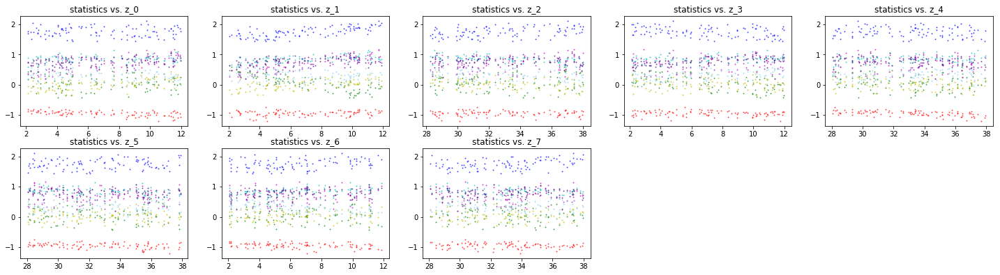

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


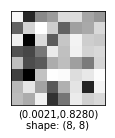


statistics correlation matrix:


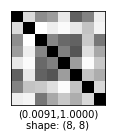


pca explained variance ratio:
[ 0.54555076  0.18559052  0.08559372  0.0579704   0.04690348  0.04571519
  0.02773691  0.004939  ]


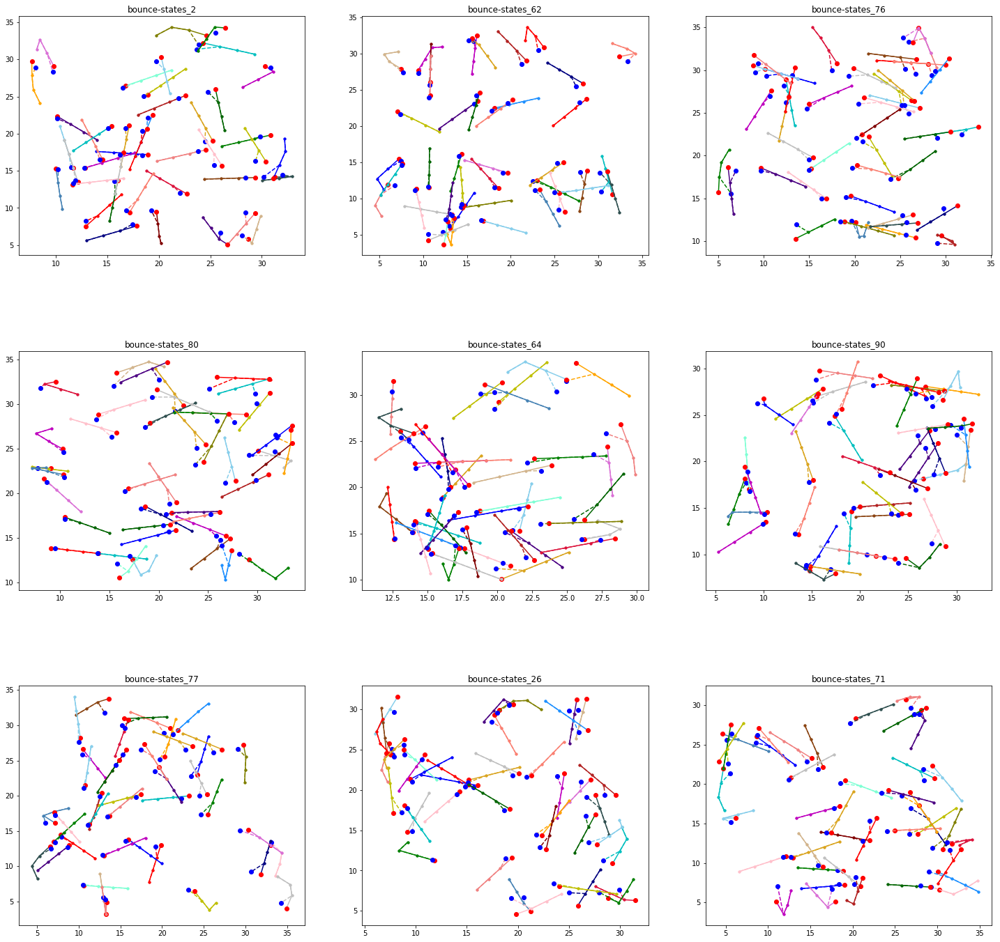


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


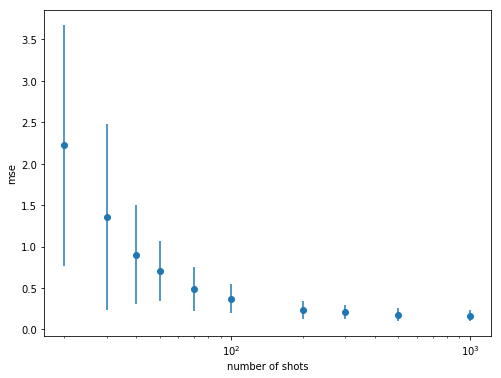

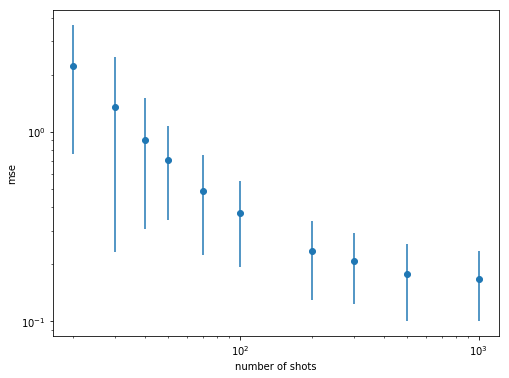

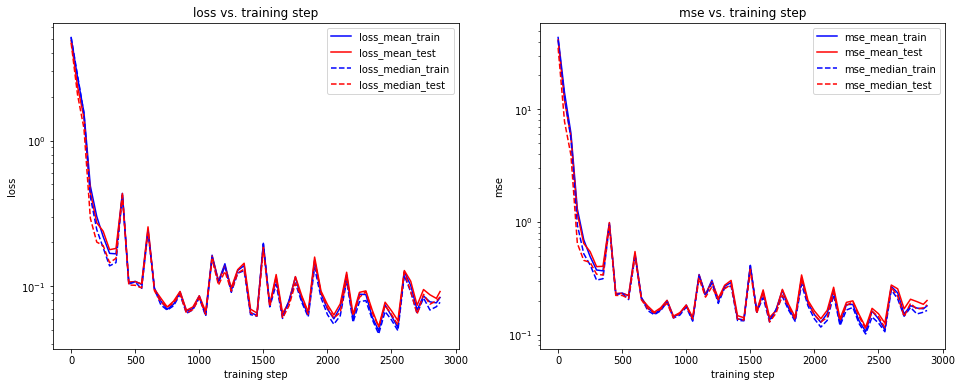

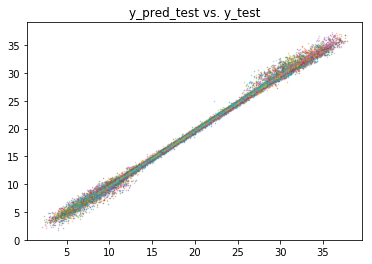

test statistics vs. z:


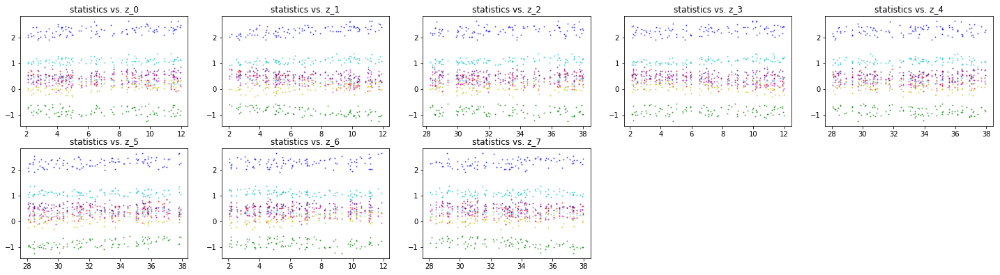

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


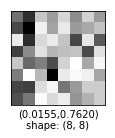


statistics correlation matrix:


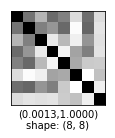


pca explained variance ratio:
[ 0.40399829  0.22847404  0.12773329  0.10355953  0.05965722  0.0401534
  0.02370862  0.01271559]


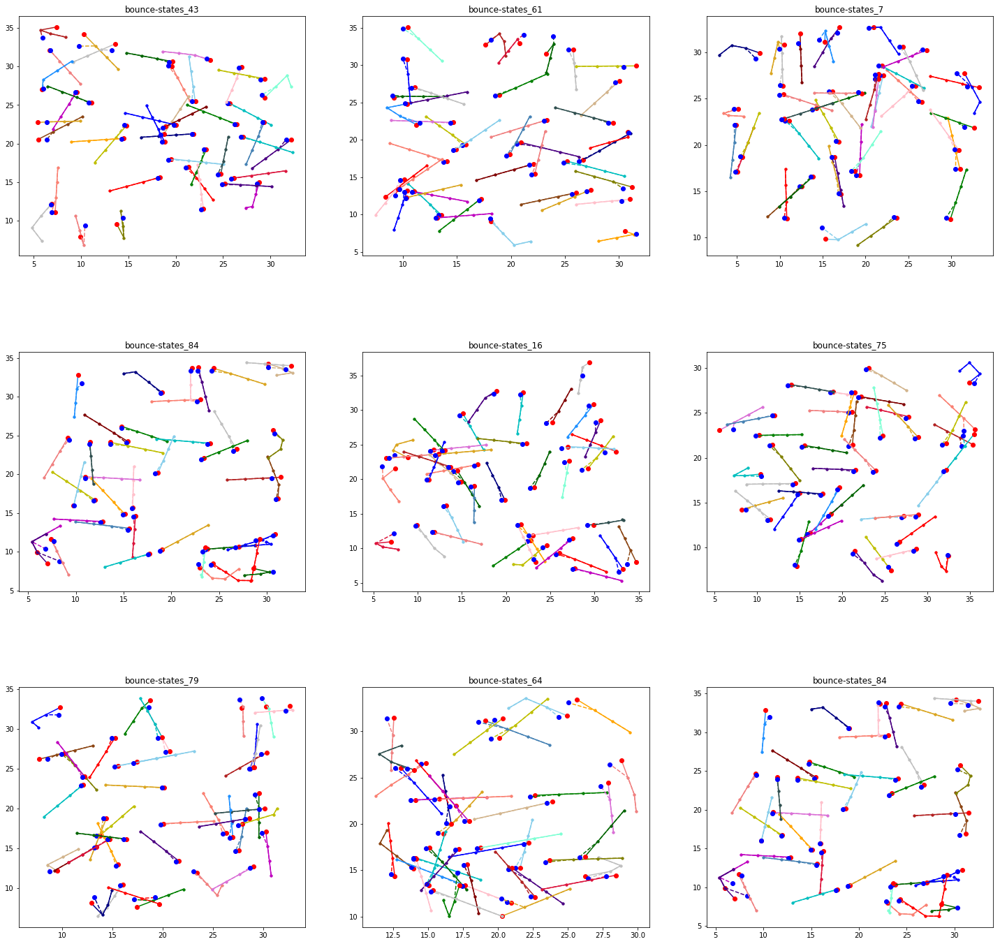


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


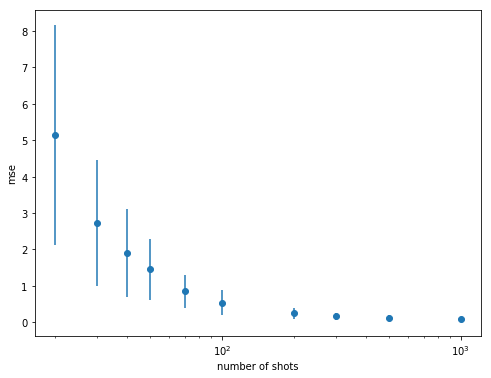

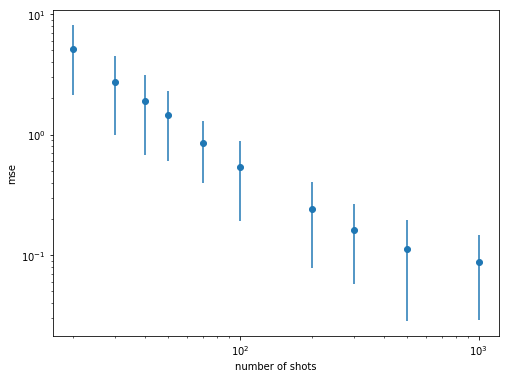

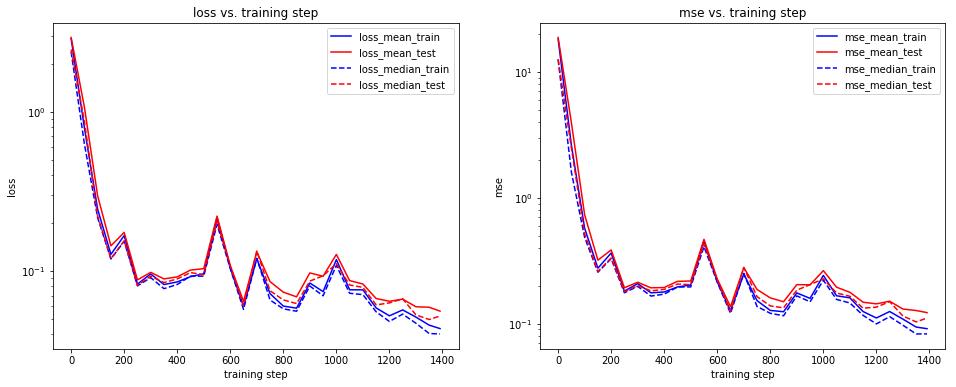

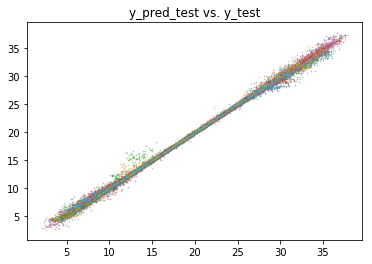

test statistics vs. z:


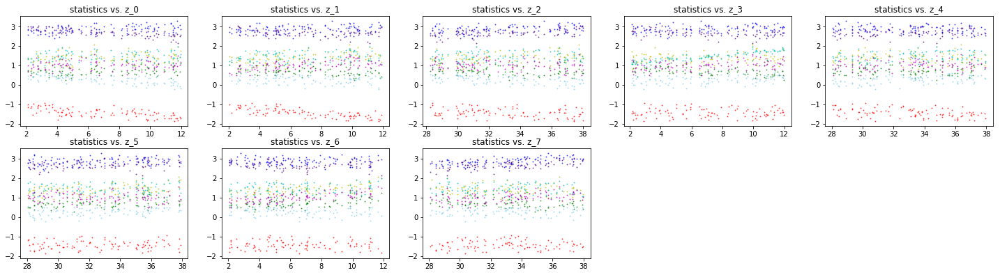

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


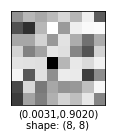


statistics correlation matrix:


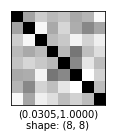


pca explained variance ratio:
[ 0.35815534  0.19262555  0.14766225  0.10549045  0.06293569  0.0527109
  0.04388097  0.03653881]


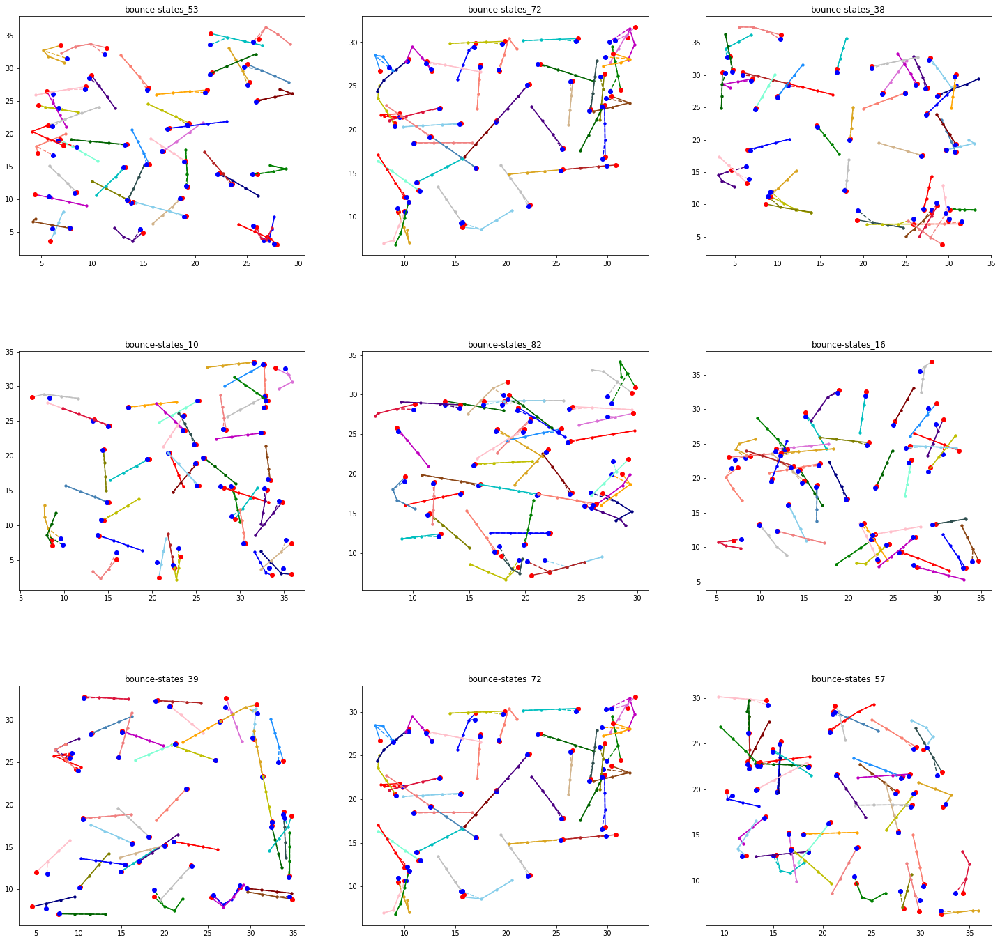


Net_('bounce-states',)_input_6_(100,50)_stat_16_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


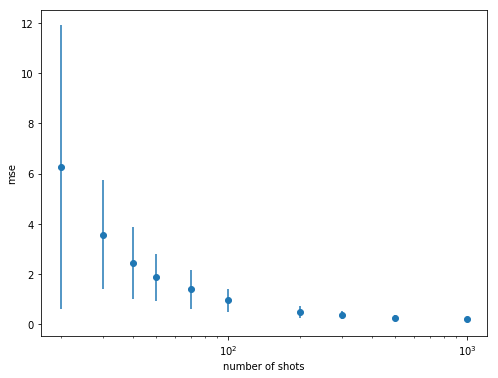

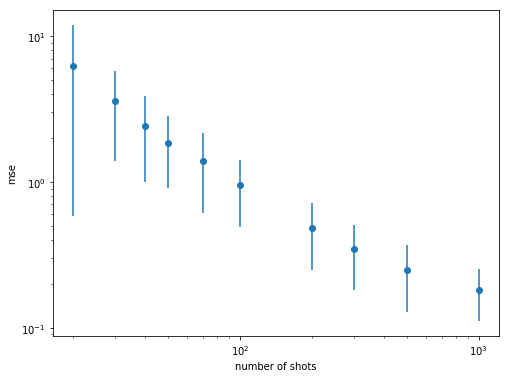

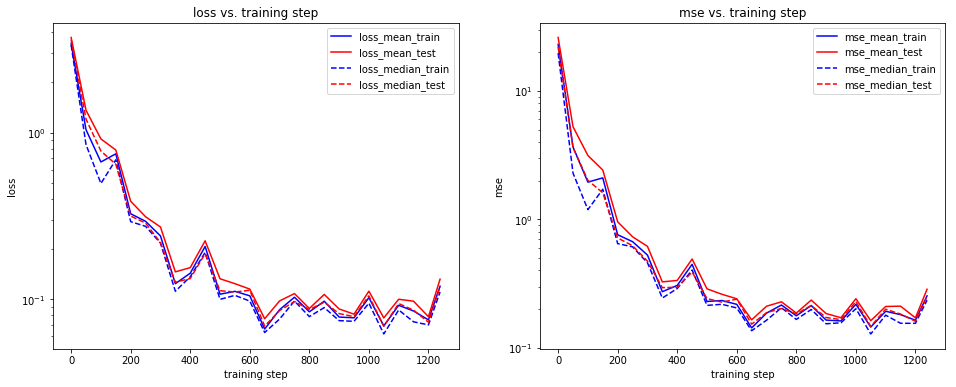

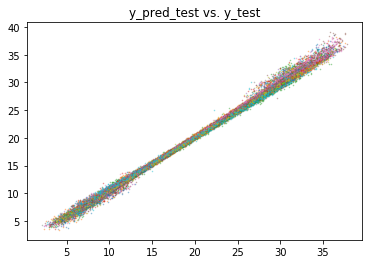

test statistics vs. z:


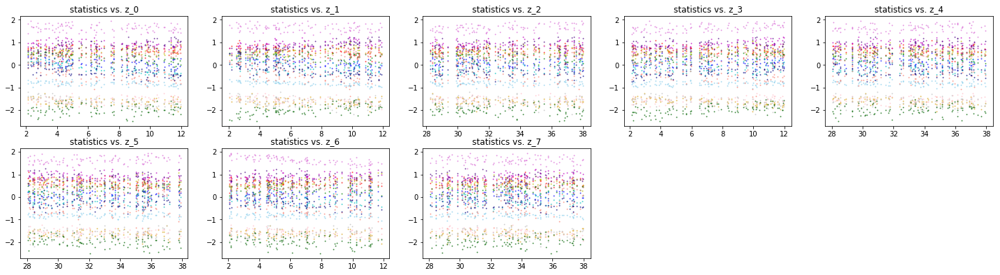

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


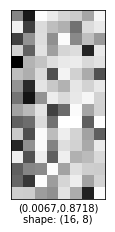


statistics correlation matrix:


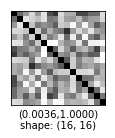


pca explained variance ratio:
[ 0.44981998  0.15083797  0.14413935  0.08680777  0.05371247  0.04016669
  0.02951929  0.01997921  0.01352546  0.00606491  0.00199419  0.00117087
  0.00070296  0.00060056  0.00050836  0.00044991]


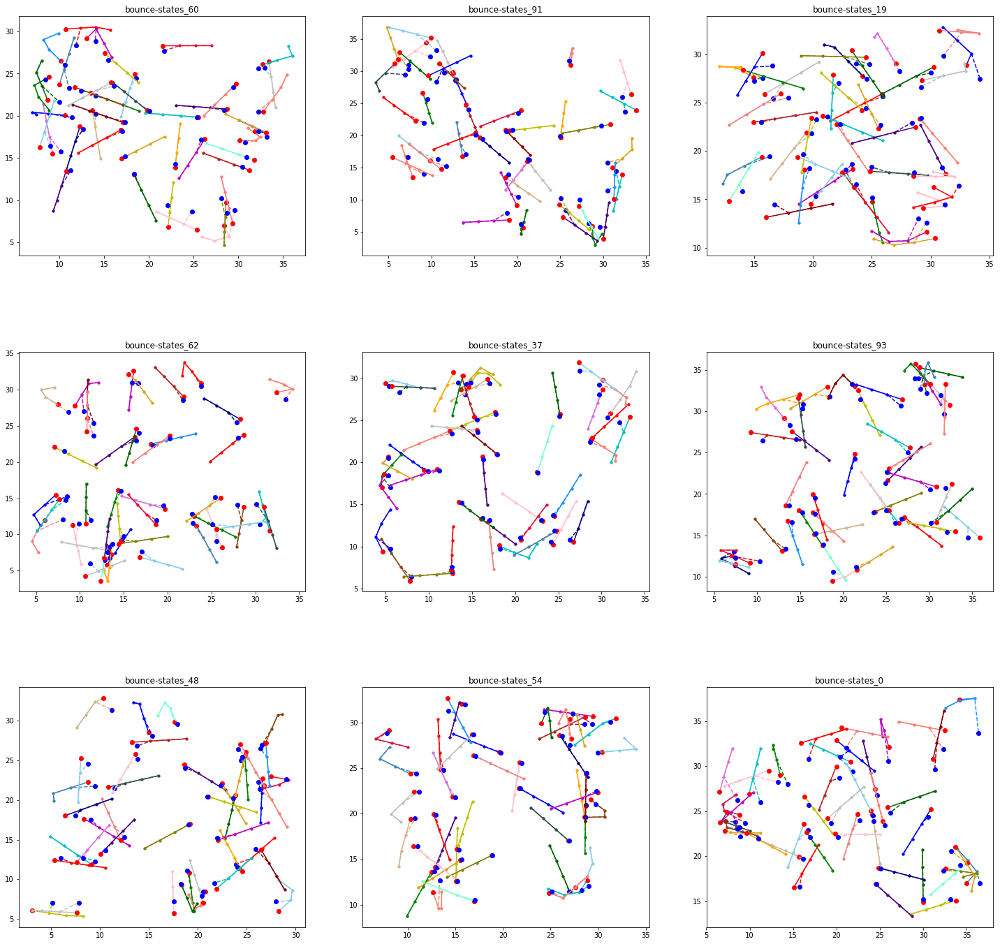


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


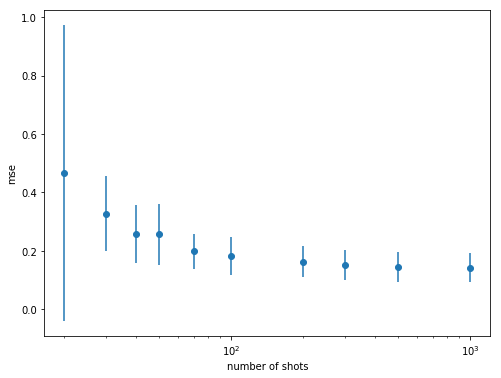

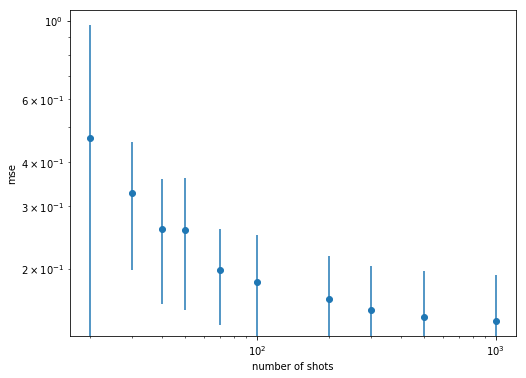

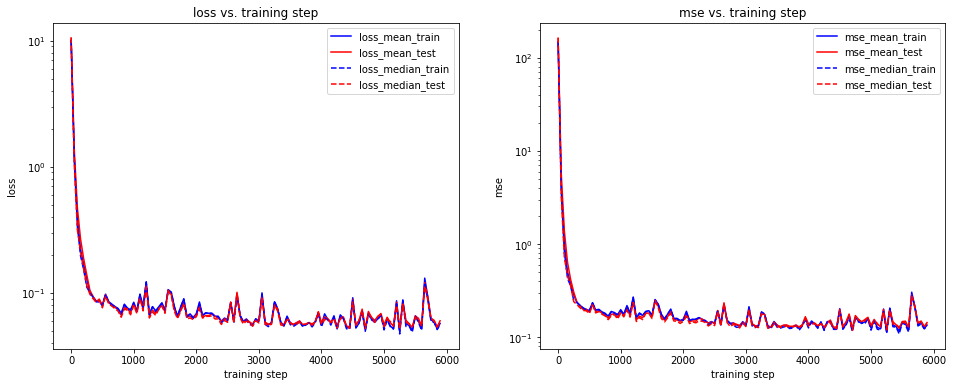

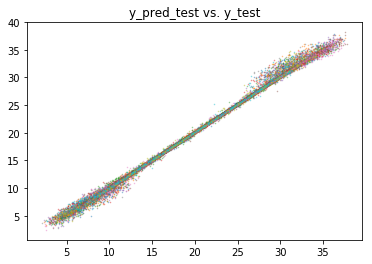

test statistics vs. z:


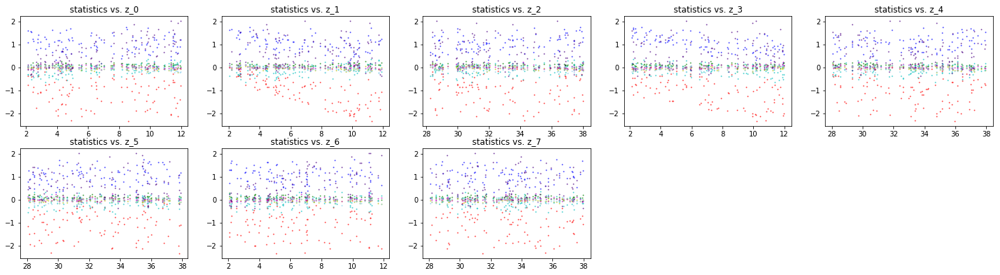

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


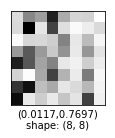


statistics correlation matrix:


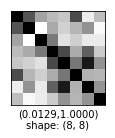


pca explained variance ratio:
[  4.98311669e-01   3.77697676e-01   1.01989485e-01   1.73986685e-02
   2.61373771e-03   1.07209967e-03   6.00266969e-04   3.16366612e-04]


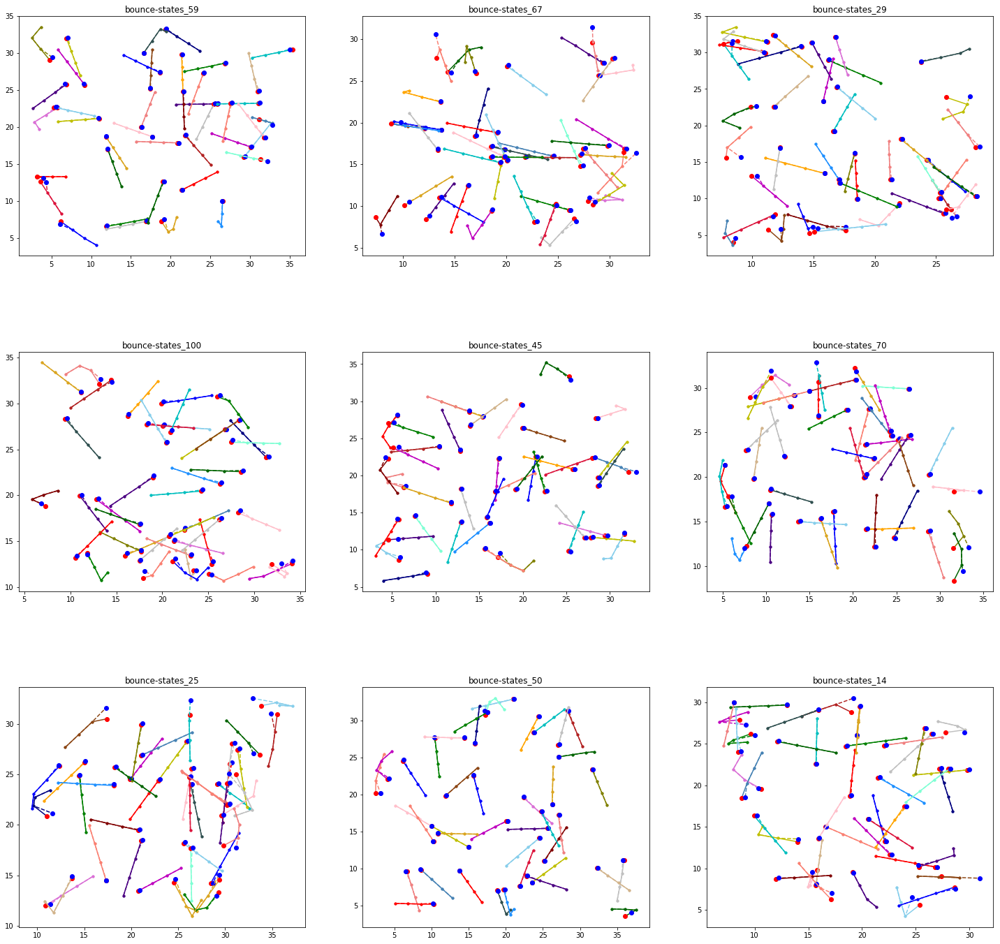


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_mse_May3_info.p


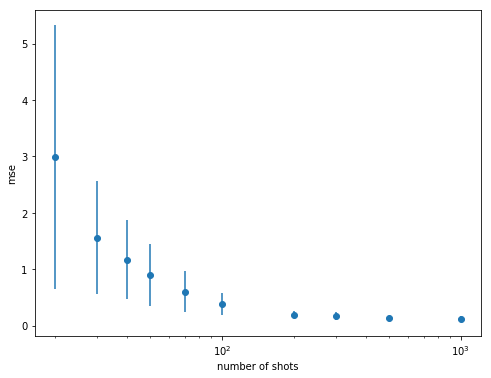

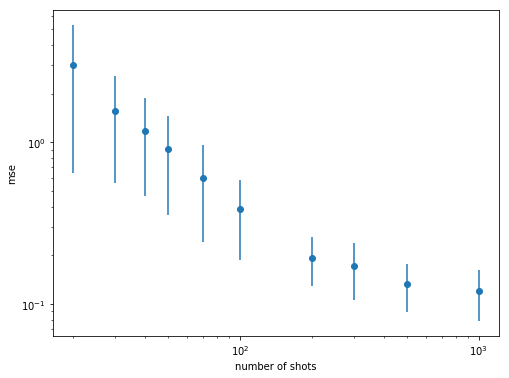

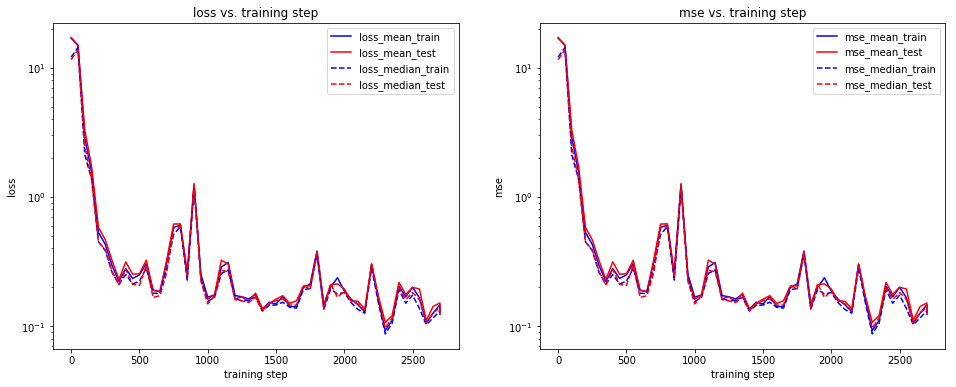

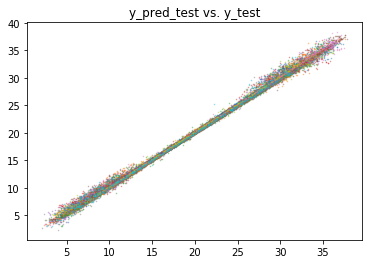

test statistics vs. z:


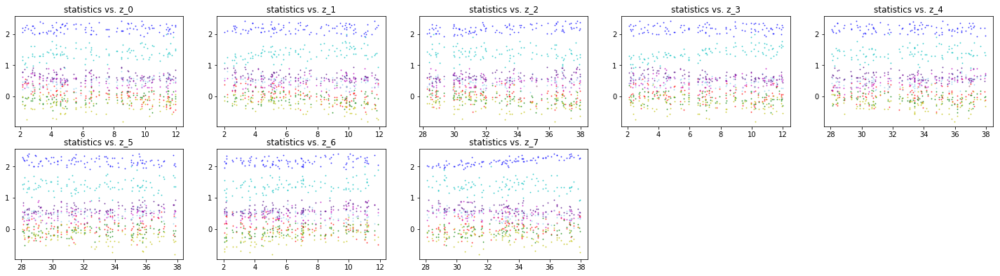

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


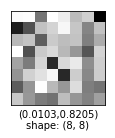


statistics correlation matrix:


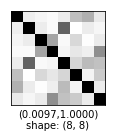


pca explained variance ratio:
[ 0.29888132  0.23776209  0.13742754  0.12151533  0.08212283  0.05864735
  0.04224028  0.02140329]


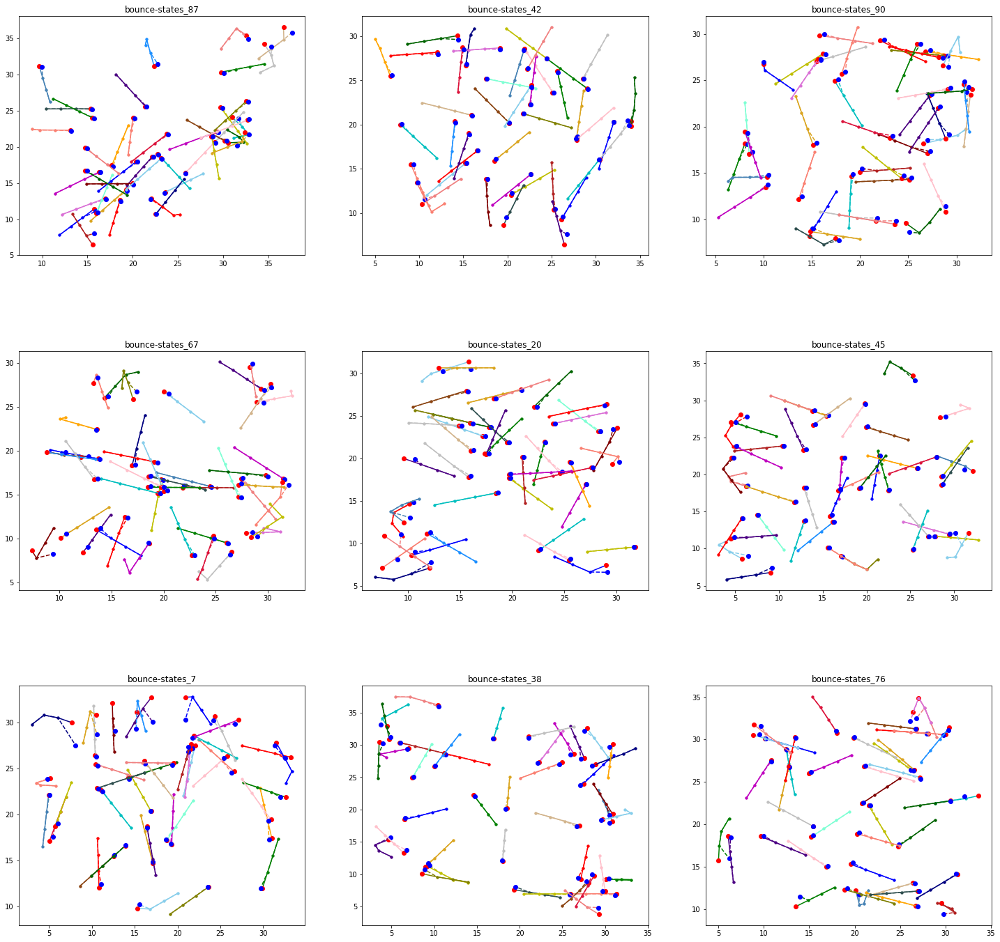


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


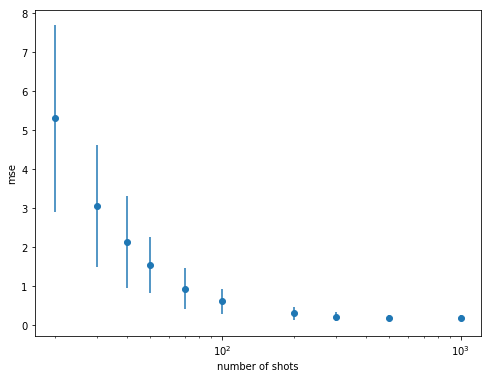

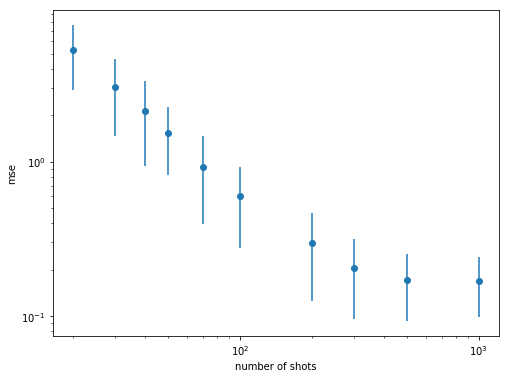

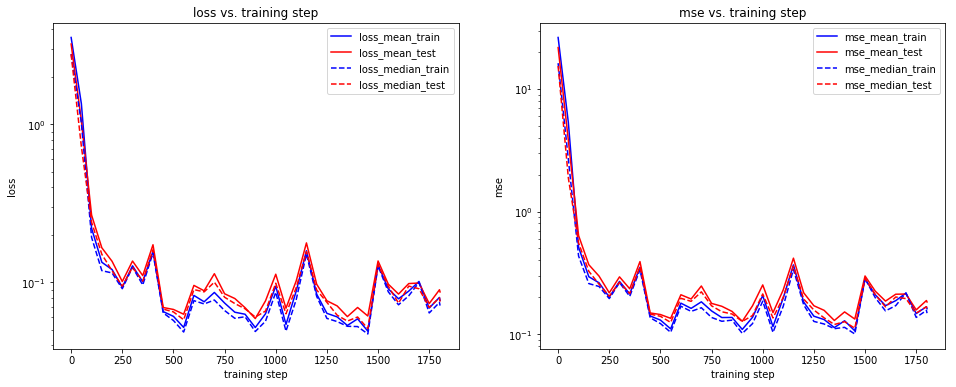

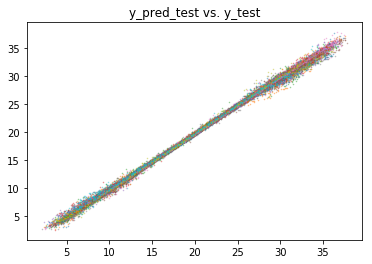

test statistics vs. z:


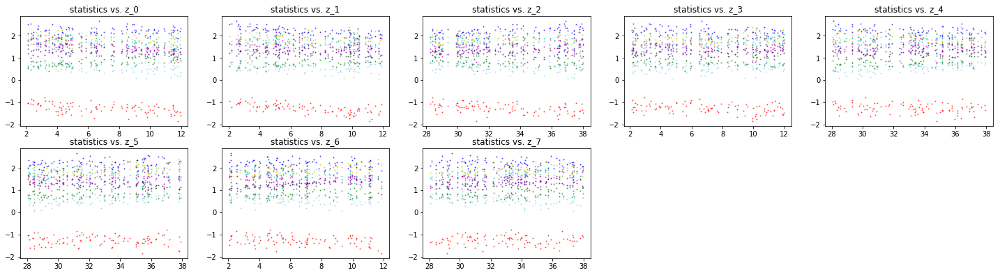

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


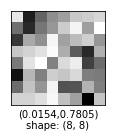


statistics correlation matrix:


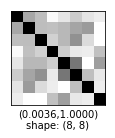


pca explained variance ratio:
[ 0.33388463  0.15780592  0.13892794  0.1264514   0.09227946  0.07222243
  0.05853352  0.01989464]


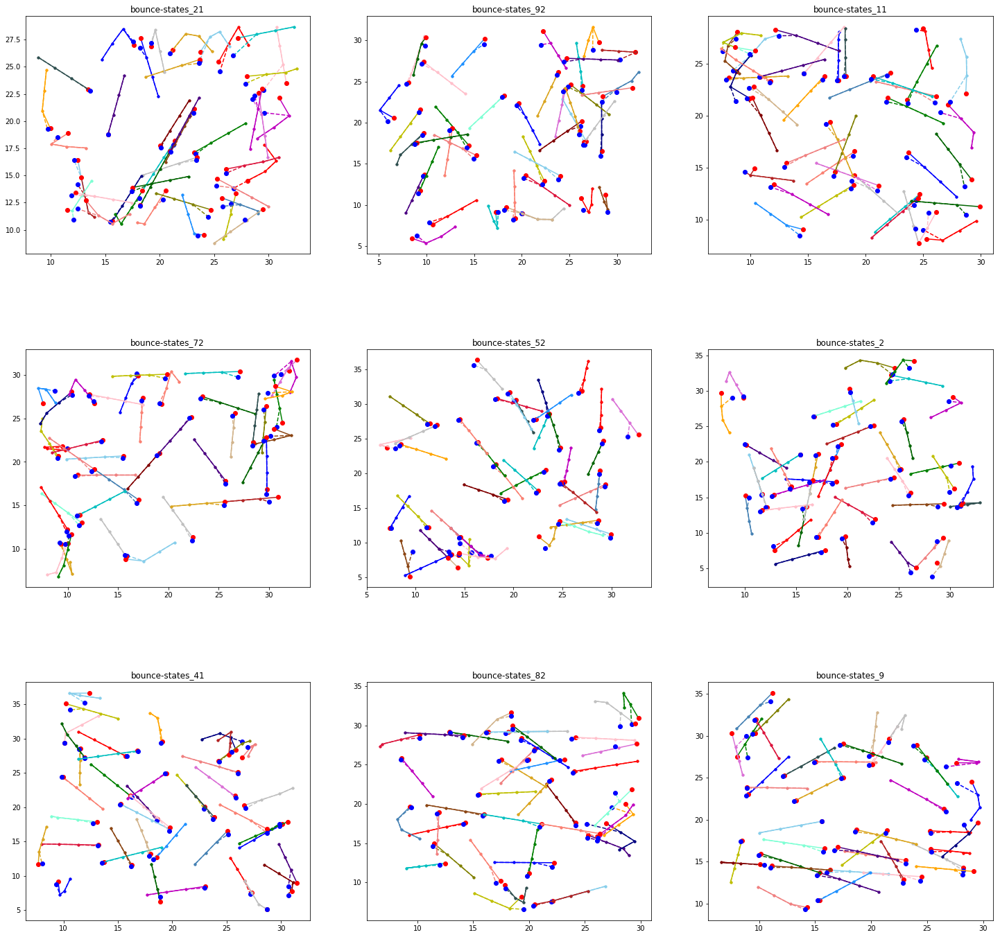


Net_('bounce-states',)_input_6_(100,50)_stat_16_pre_200_pool_max_context_0_hid_(40, 40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


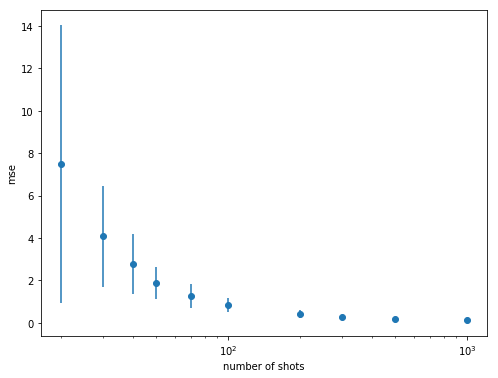

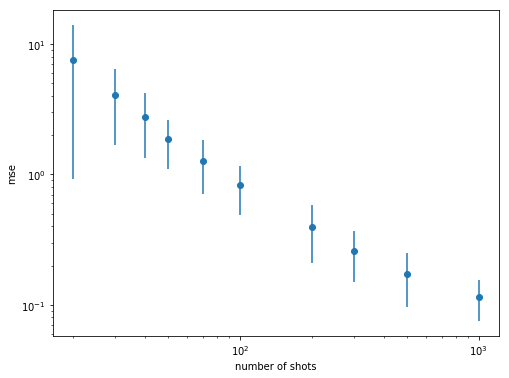

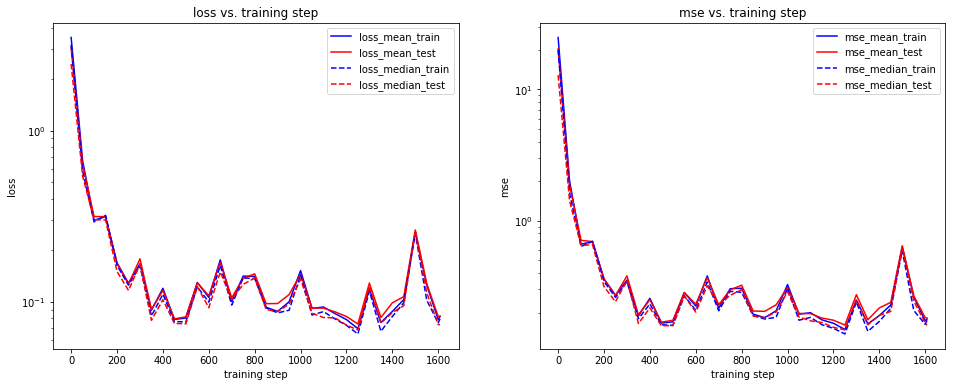

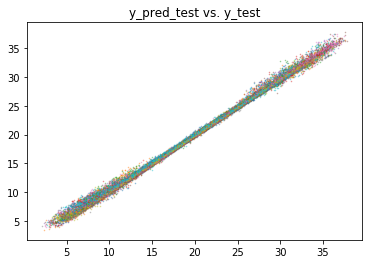

test statistics vs. z:


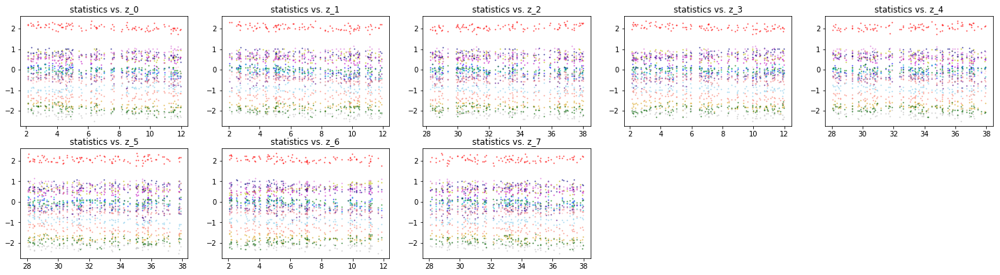

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


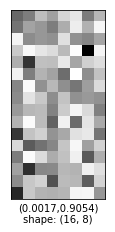


statistics correlation matrix:


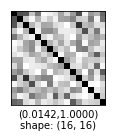


pca explained variance ratio:
[  2.54413784e-01   1.96962446e-01   1.56485170e-01   1.15510464e-01
   8.35276097e-02   7.37937614e-02   5.26431203e-02   4.11526933e-02
   1.39171975e-02   5.42608695e-03   2.19959440e-03   1.85508560e-03
   8.41994770e-04   6.45797583e-04   4.50863939e-04   1.74352157e-04]


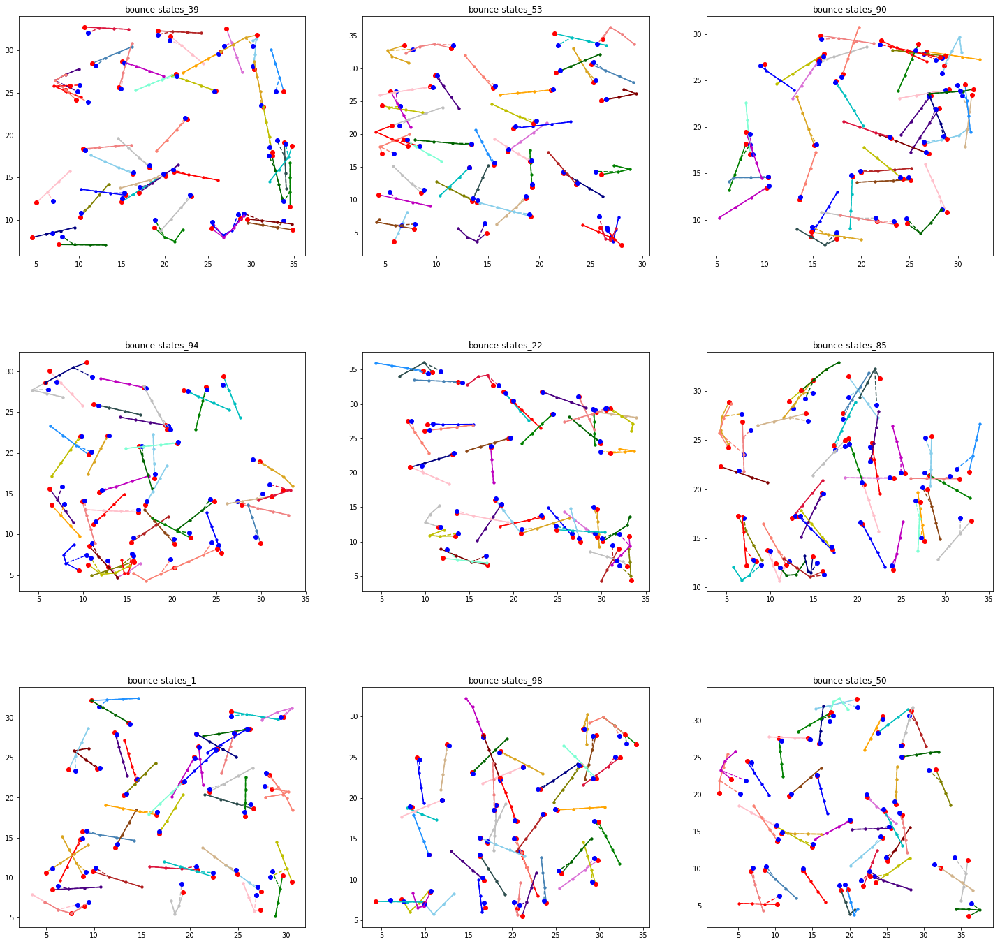


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


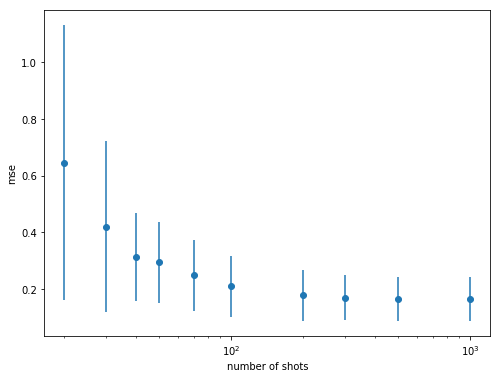

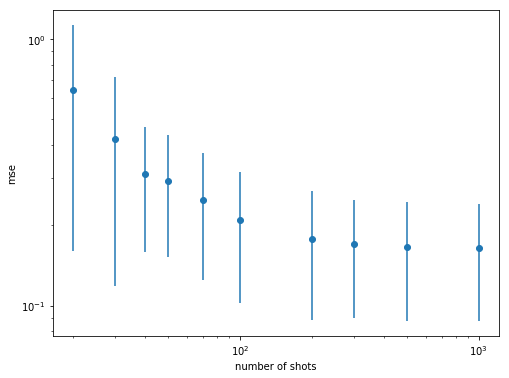

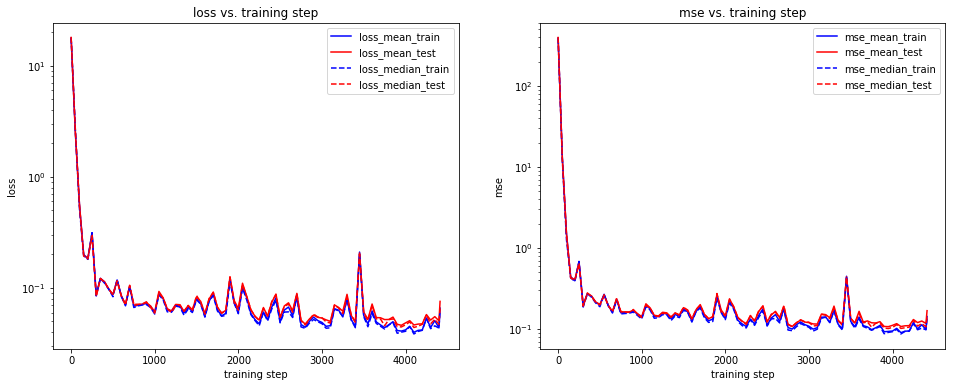

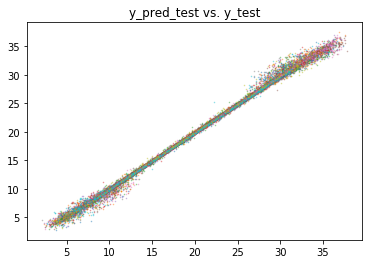

test statistics vs. z:


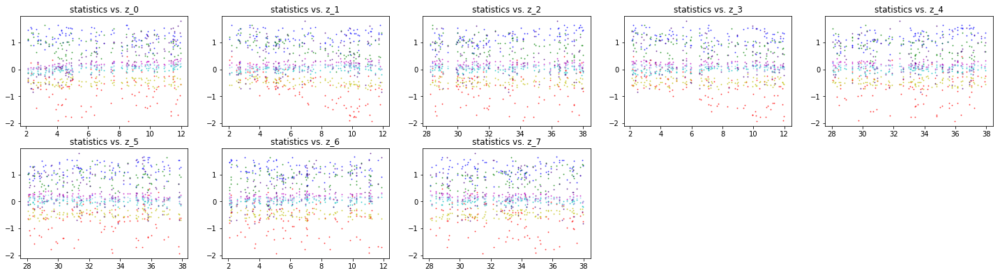

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


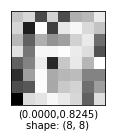


statistics correlation matrix:


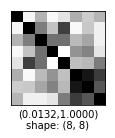


pca explained variance ratio:
[  4.63806689e-01   3.61888379e-01   1.07375227e-01   5.10839485e-02
   1.30353505e-02   2.00939737e-03   4.49121348e-04   3.51892435e-04]


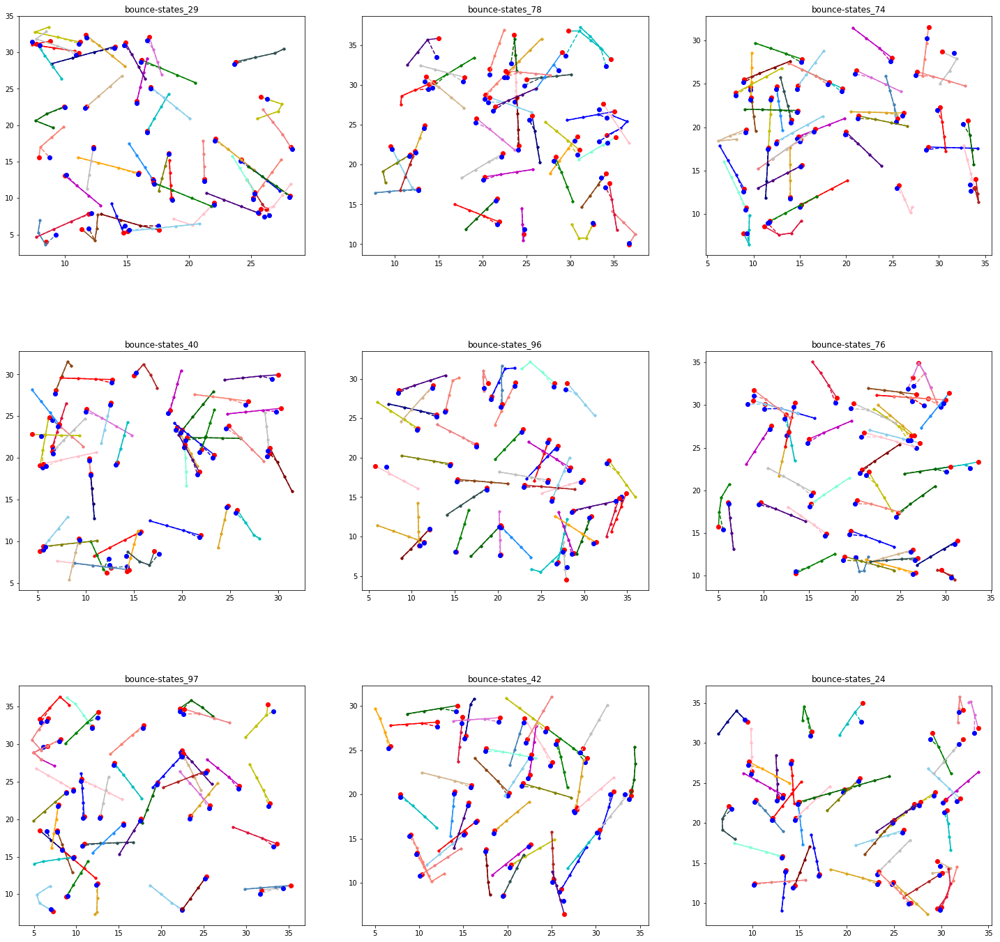


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(80, 80)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


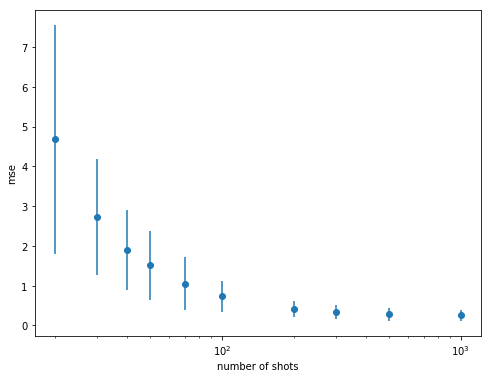

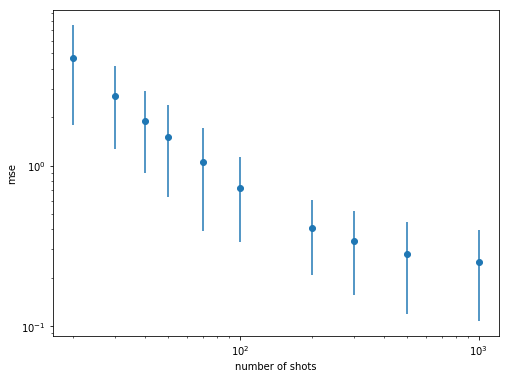

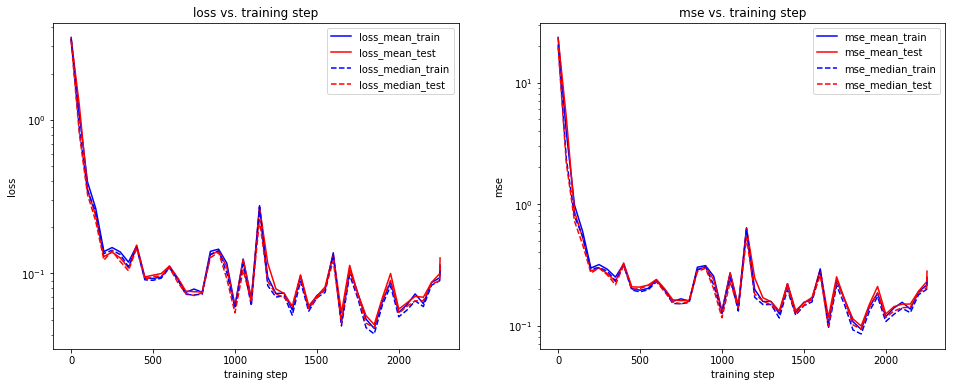

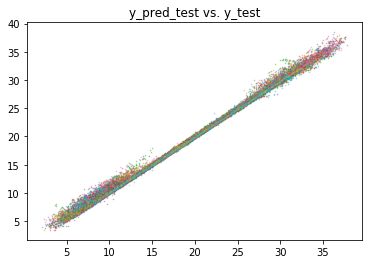

test statistics vs. z:


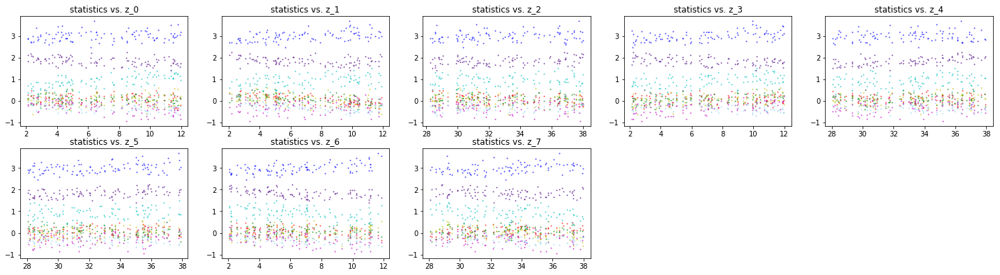

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


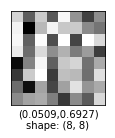


statistics correlation matrix:


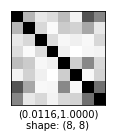


pca explained variance ratio:
[ 0.31505093  0.18696852  0.1468838   0.11724769  0.10277776  0.06984104
  0.03453257  0.02669767]


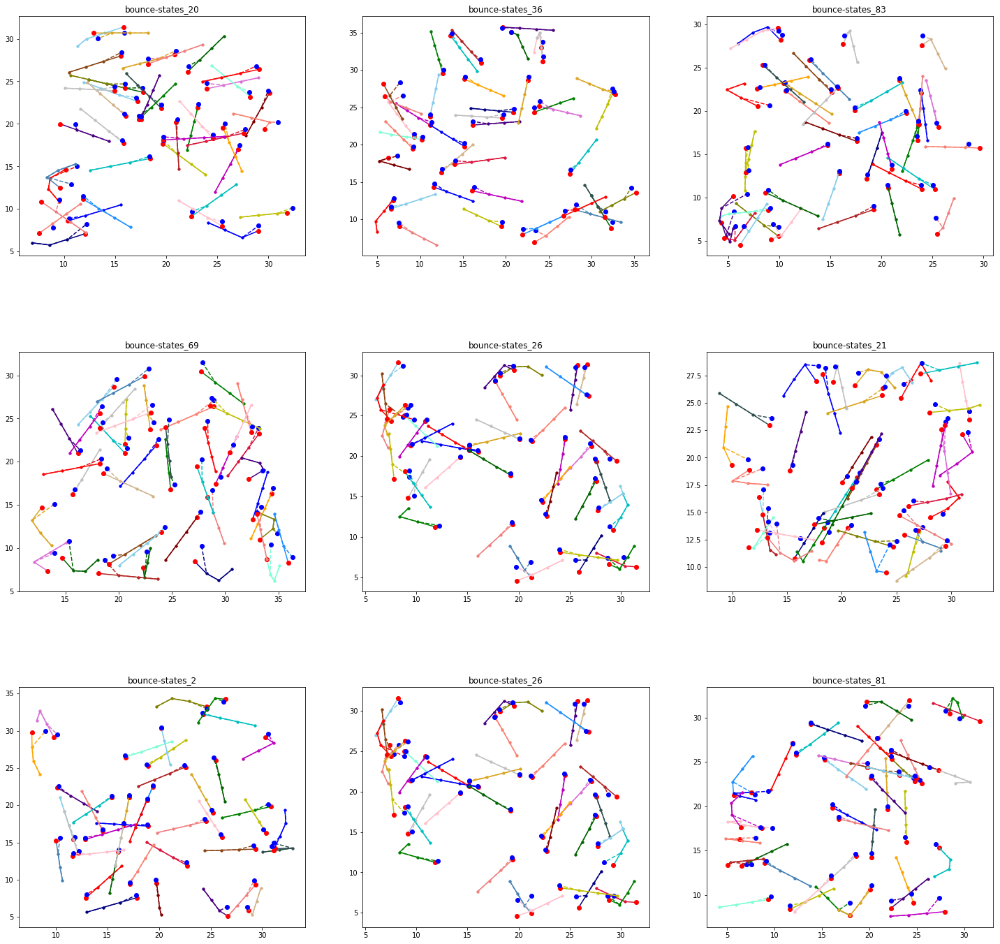


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-07_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


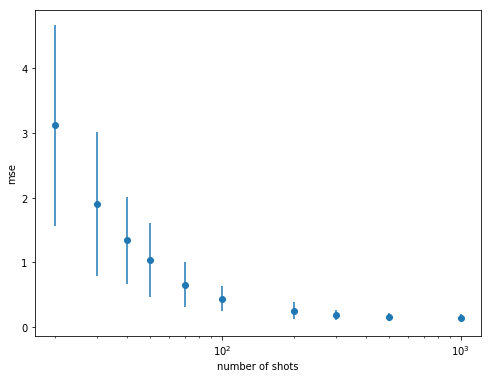

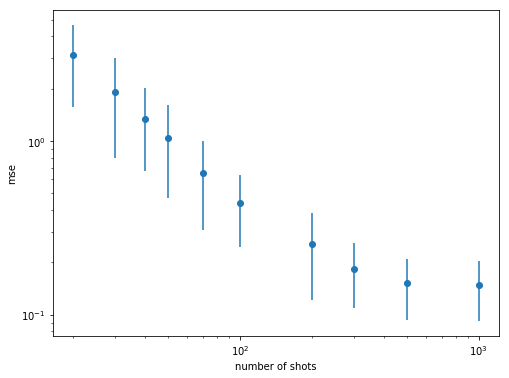

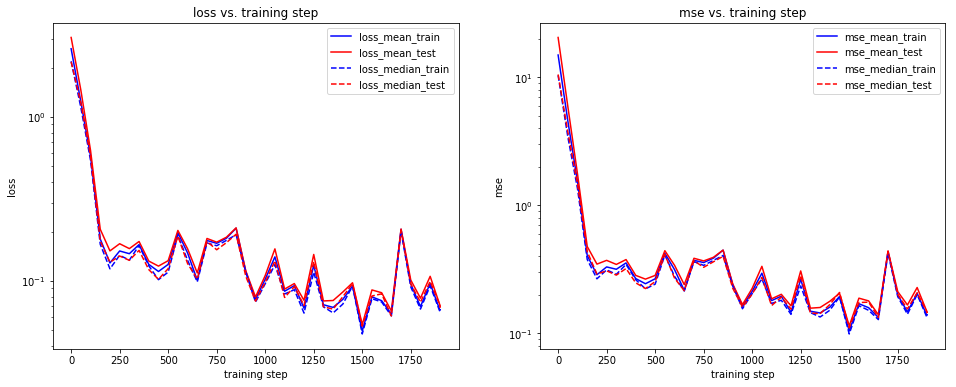

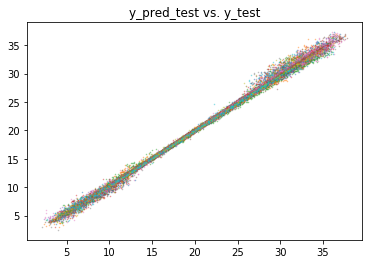

test statistics vs. z:


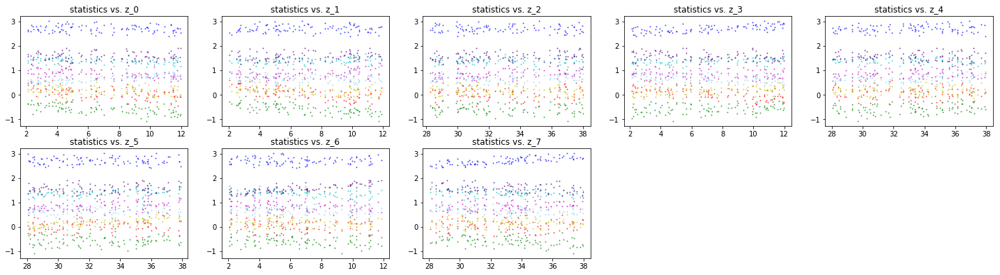

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


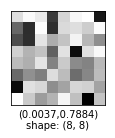


statistics correlation matrix:


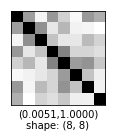


pca explained variance ratio:
[ 0.32539666  0.2319345   0.13760802  0.10215947  0.08024833  0.0700276
  0.0381242   0.01450119]


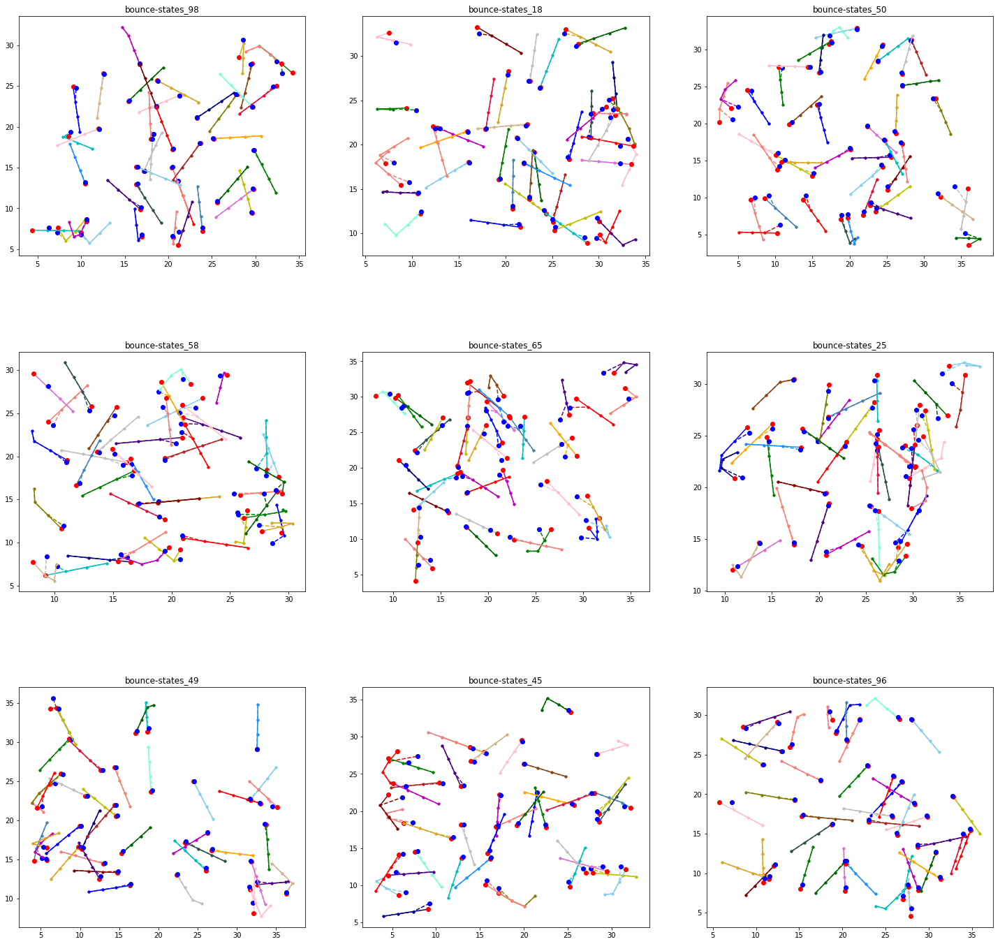


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_2e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


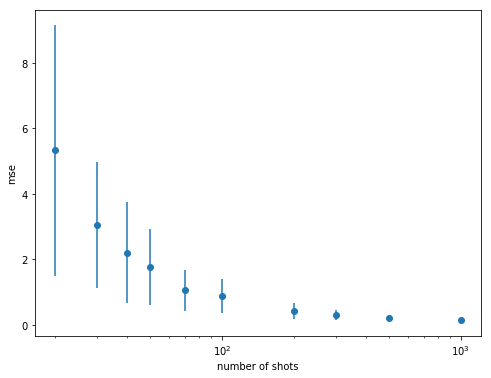

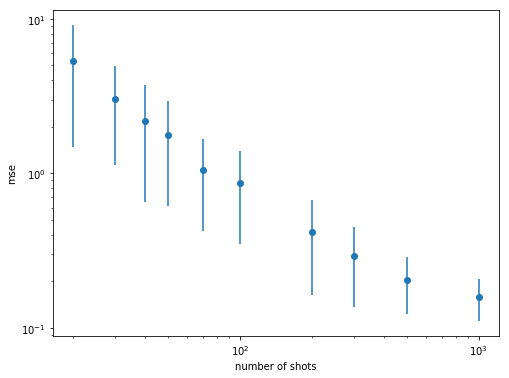

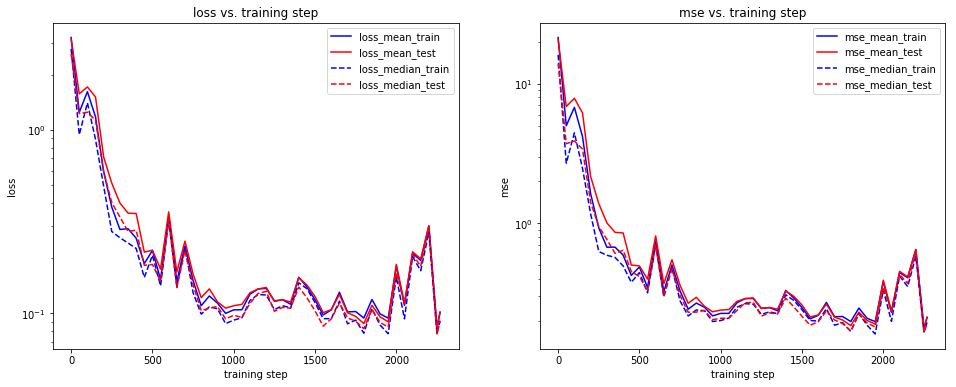

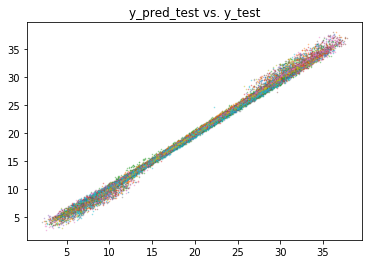

test statistics vs. z:


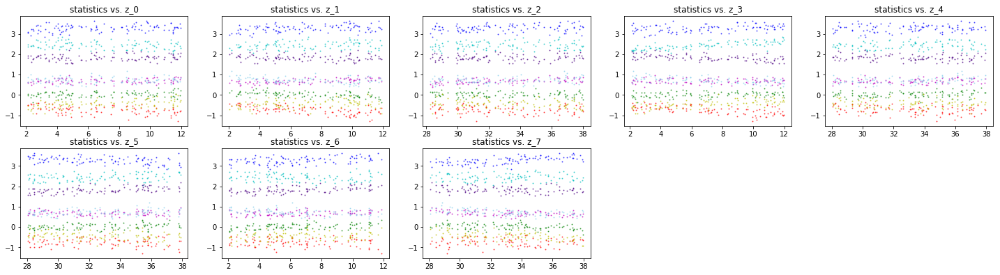

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


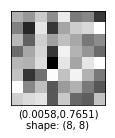


statistics correlation matrix:


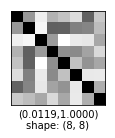


pca explained variance ratio:
[ 0.46484122  0.16786517  0.11929026  0.08450219  0.07025321  0.04590662
  0.03740274  0.00993857]


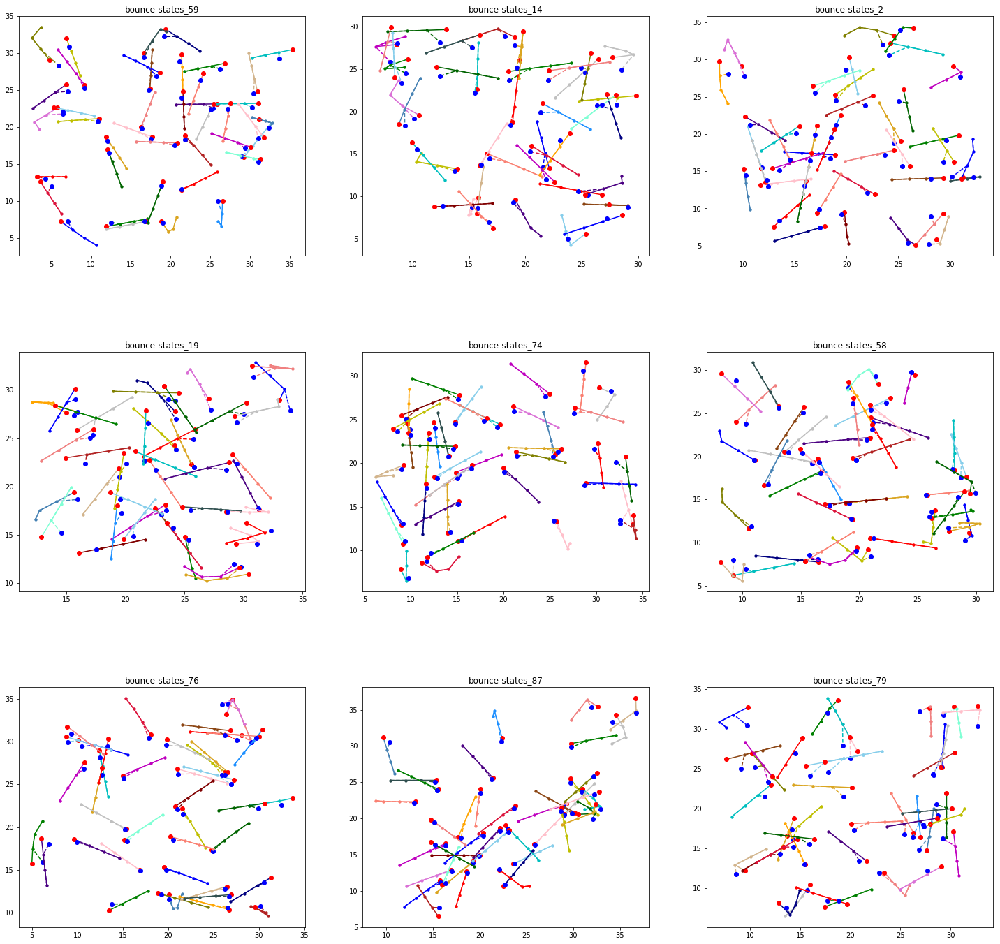


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_8_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


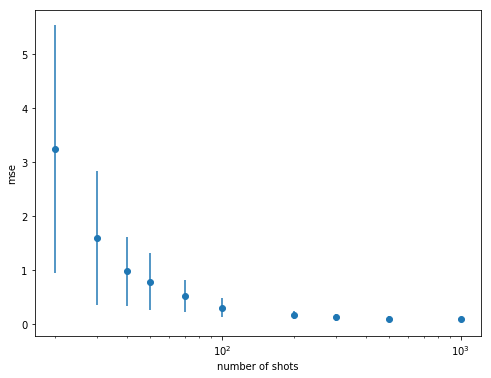

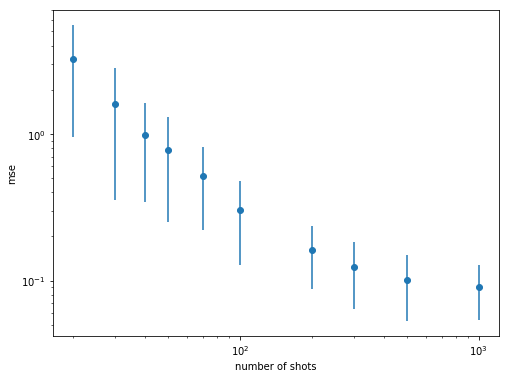

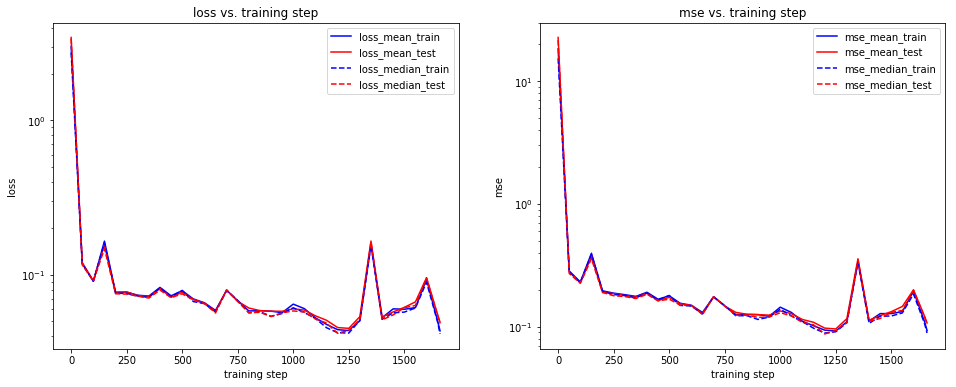

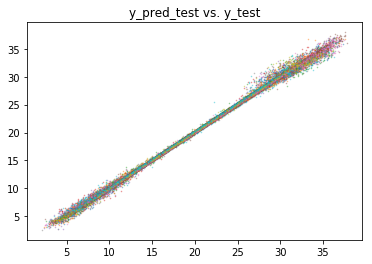

test statistics vs. z:


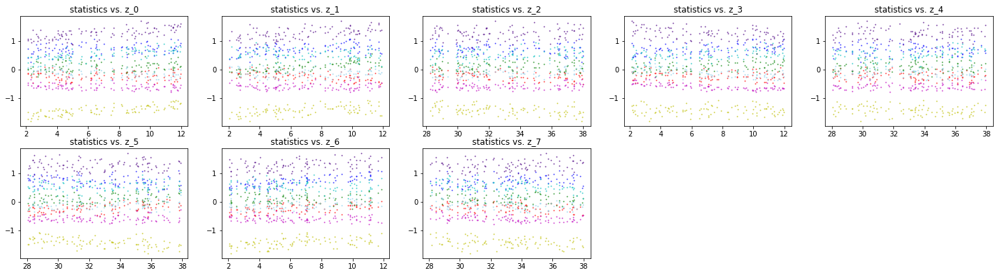

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


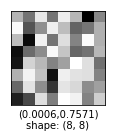


statistics correlation matrix:


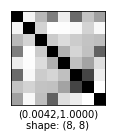


pca explained variance ratio:
[ 0.35847771  0.17813109  0.13674633  0.12929389  0.08967219  0.05522144
  0.04529369  0.00716368]


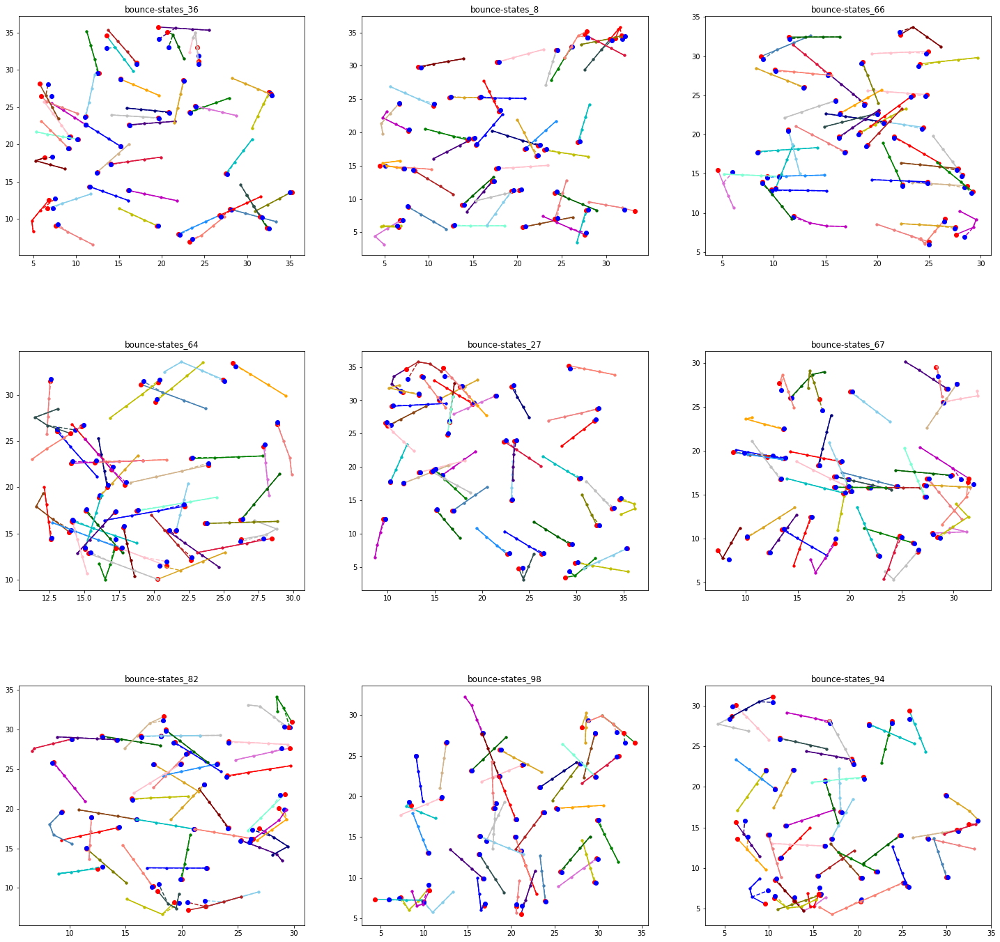

In [15]:
exp_id = "May3"  # First experiment
df = load_df(exp_id)

In [27]:
df.sort_values(by = "median_last")[["mean_last", "median_last", "mean_min", "median_min", "filename", "pre_pooling_neurons", "statistics_output_neurons", "is_VAE", "loss_core", "lr", "main_hidden_neurons", "num_context_neurons"]]

,mean_last,median_last,mean_min,median_min,filename,pre_pooling_neurons,statistics_output_neurons,is_VAE,loss_core,lr,main_hidden_neurons,num_context_neurons
9,0.120632,0.113055,0.106825,0.101293,"Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",200,8,True,huber,5e-05,"(40, 40, 40)",0
3,0.139831,0.126982,0.122202,0.103124,"Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",200,8,False,huber,5e-05,"(40, 80, 40)",0
13,0.144728,0.140287,0.095929,0.087319,"Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_8_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",200,8,False,huber,5e-05,"(40, 40)",8
6,0.159319,0.142708,0.106815,0.096428,"Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_mse_May3_info.p",200,8,False,mse,5e-05,"(40, 40)",0
10,0.173039,0.160985,0.099222,0.093562,"Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(80, 80)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",200,8,False,huber,5e-05,"(80, 80)",0
1,0.166228,0.162095,0.138576,0.132984,"Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(20, 20)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",200,8,False,huber,5e-05,"(20, 20)",0
7,0.190969,0.175504,0.127146,0.111533,"Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",200,8,False,huber,5e-05,"(40, 40, 40)",0
2,0.202113,0.178495,0.115864,0.112514,"Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",200,8,False,huber,5e-05,"(40, 40)",0
5,0.184504,0.180214,0.120915,0.118507,"Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",200,8,True,huber,5e-05,"(40, 40)",0
4,0.199227,0.184034,0.162655,0.146848,"Net_('bounce-states',)_input_6_(100,50)_stat_16_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",200,16,False,huber,5e-05,"(40, 40)",0



Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


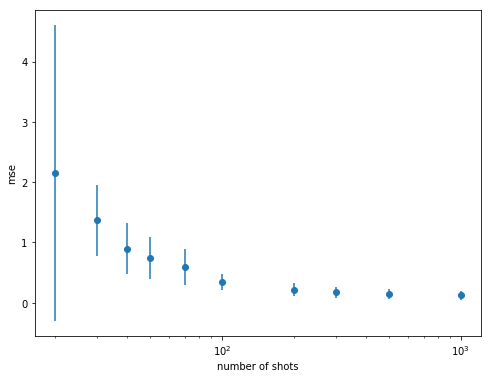

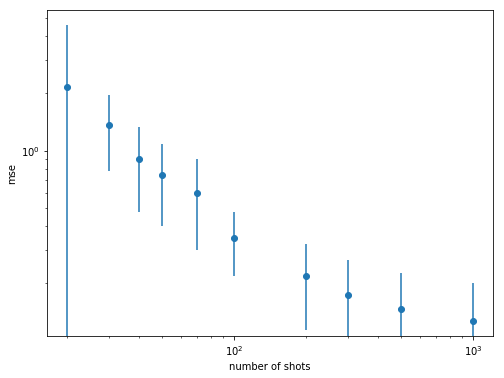

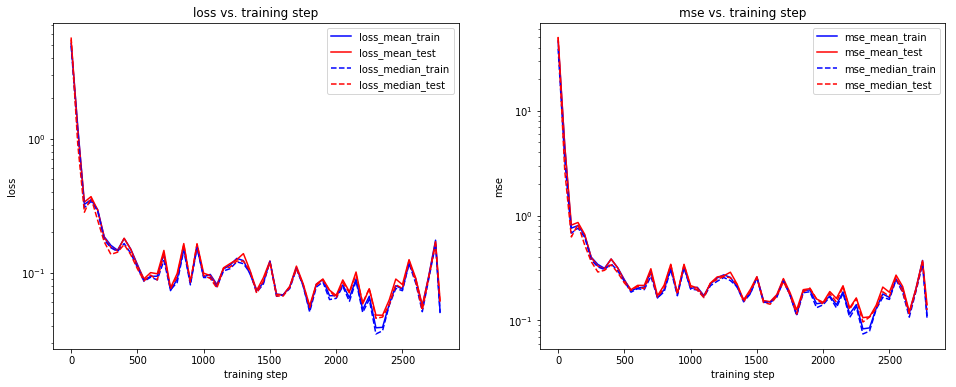

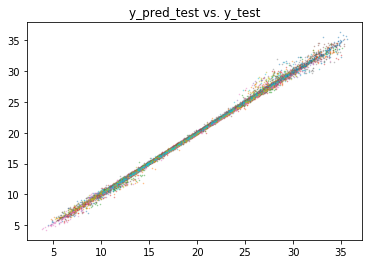

test statistics vs. z:


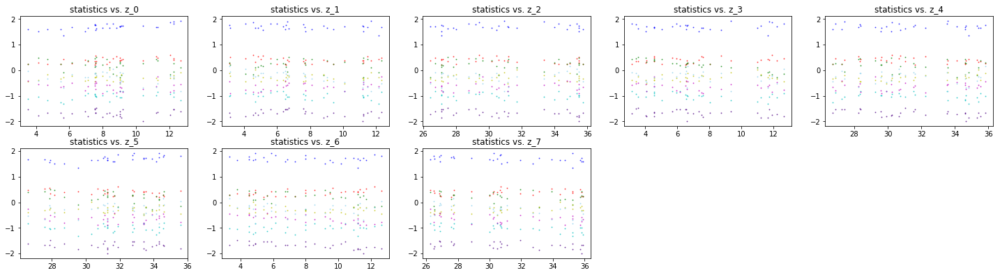

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


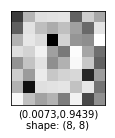


statistics correlation matrix:


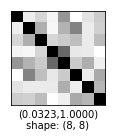


pca explained variance ratio:
[ 0.33174318  0.25739661  0.15452094  0.10382903  0.06483077  0.04483815
  0.0341878   0.00865347]


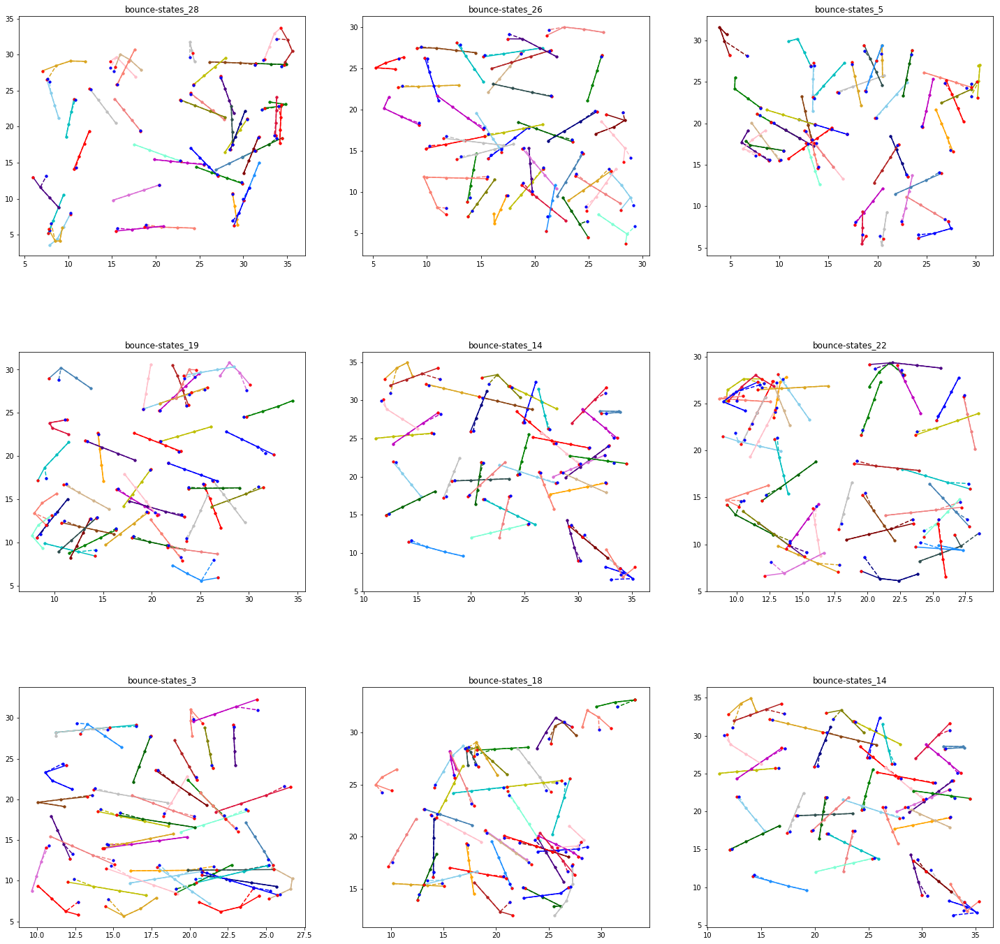

In [113]:
filename = "Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p"
# filename = "Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p"
master_model, info_dict, data_dict = load_file(filename)


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


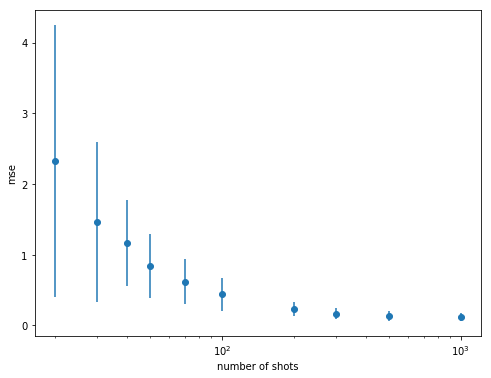

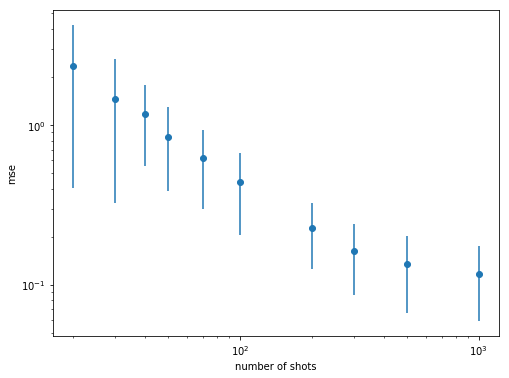

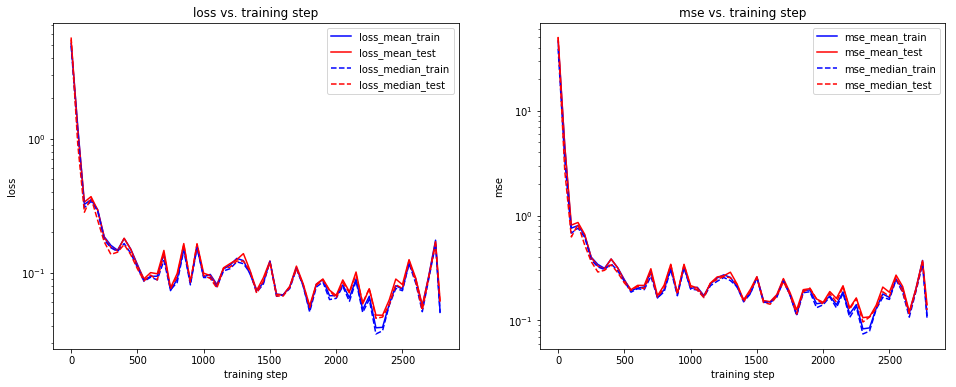

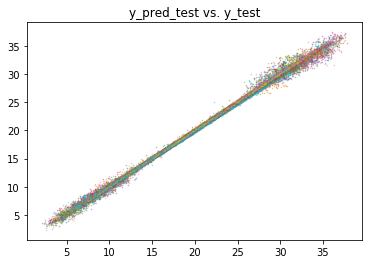

test statistics vs. z:


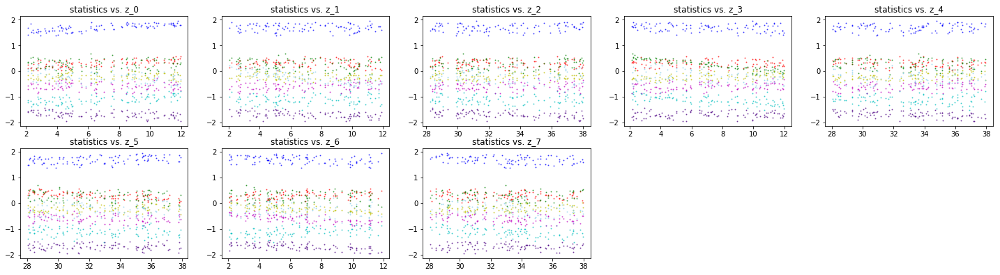

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


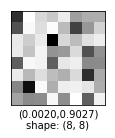


statistics correlation matrix:


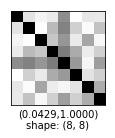


pca explained variance ratio:
[ 0.34906662  0.25864583  0.12558424  0.09799623  0.06532656  0.04728384
  0.04128087  0.01481584]


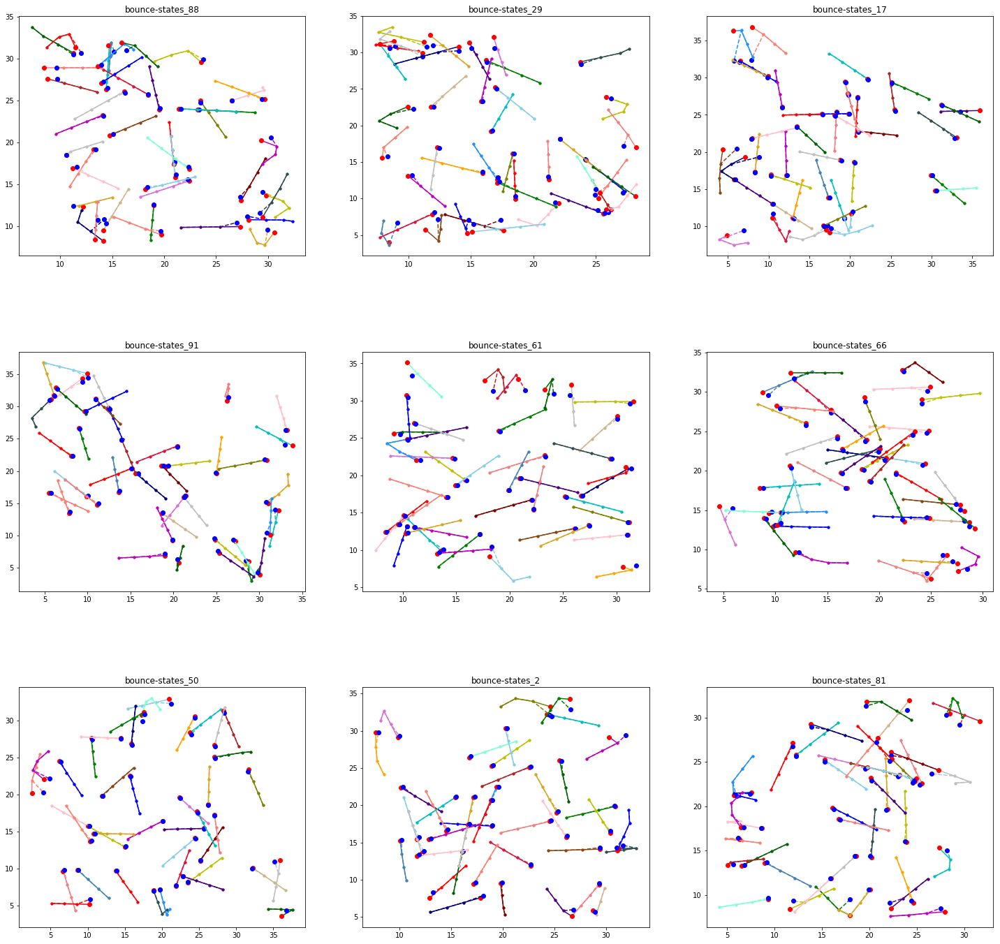

In [32]:
filename = "Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p"
master_model, info_dict, data_dict = load_file(filename)

In [ ]:
filename = "Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p"
master_model, info_dict, data_dict = load_file(filename)


Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


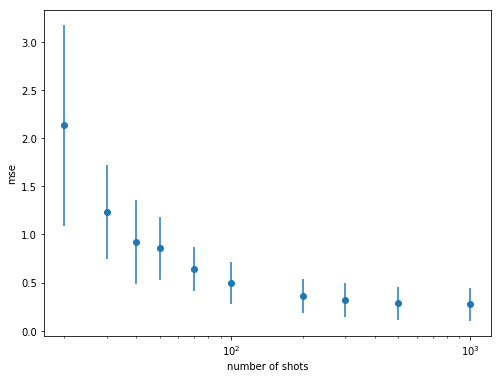

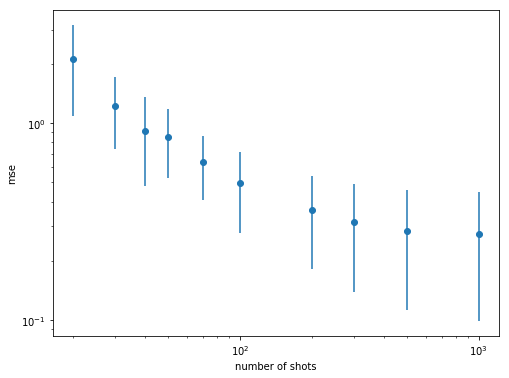

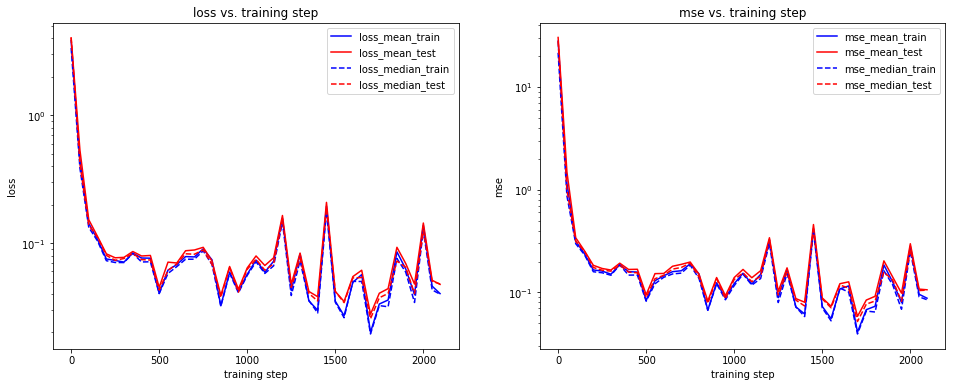

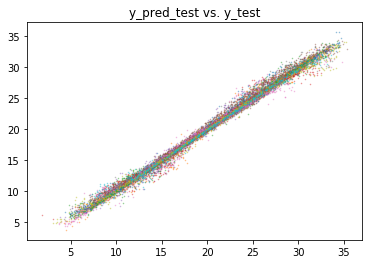

test statistics vs. z:


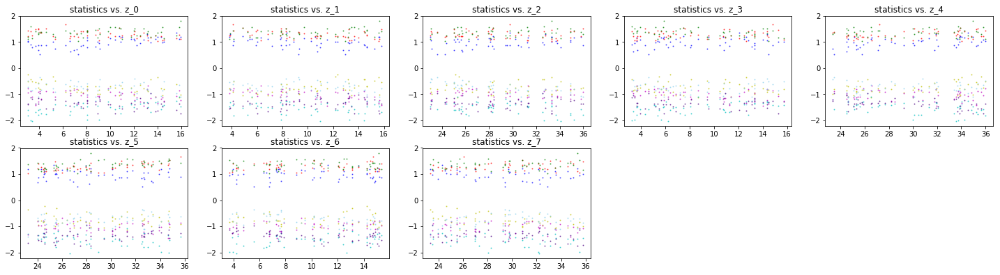

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


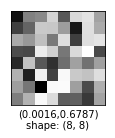


statistics correlation matrix:


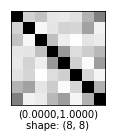


pca explained variance ratio:
[ 0.28773549  0.22109984  0.16062178  0.09775836  0.0778309   0.06744425
  0.04893316  0.03857625]


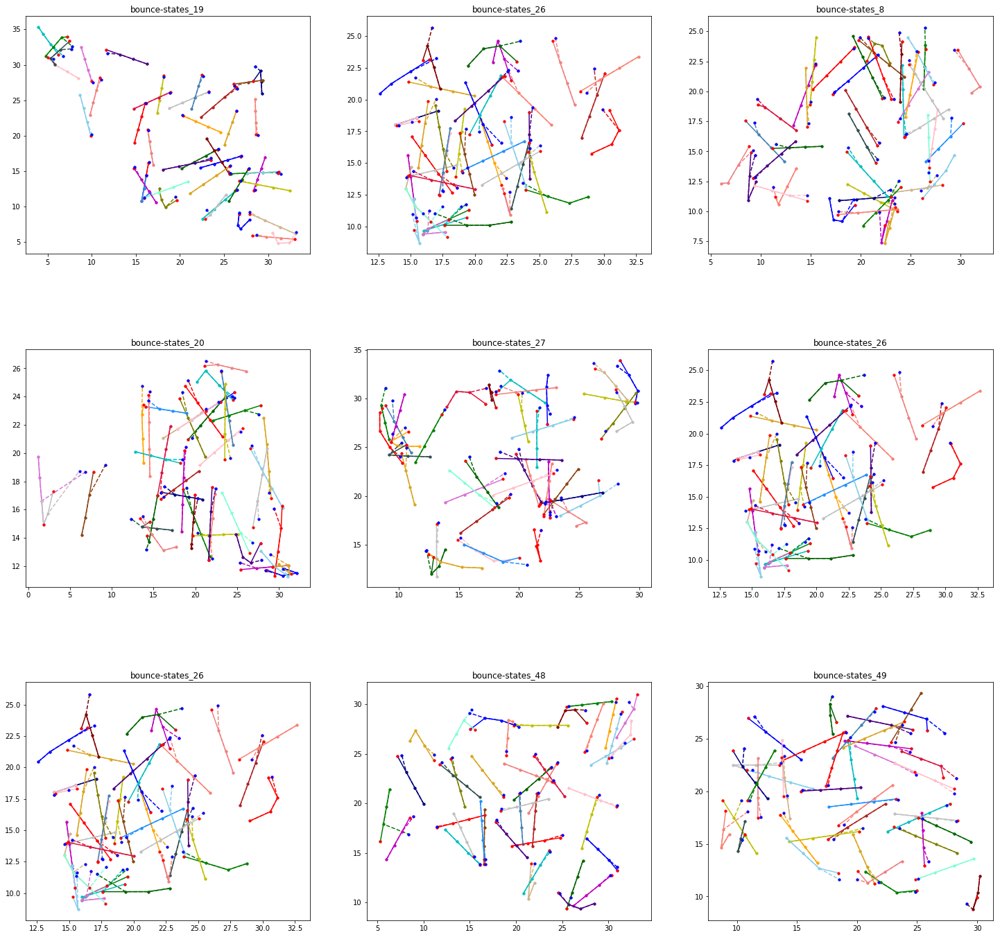


Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


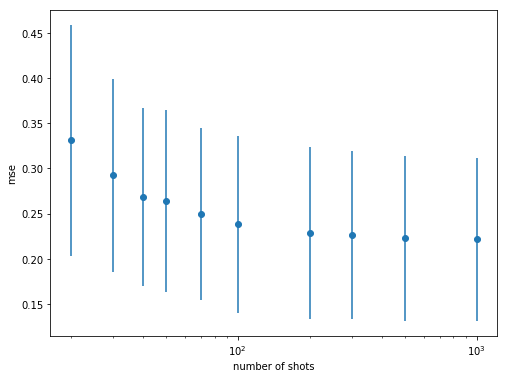

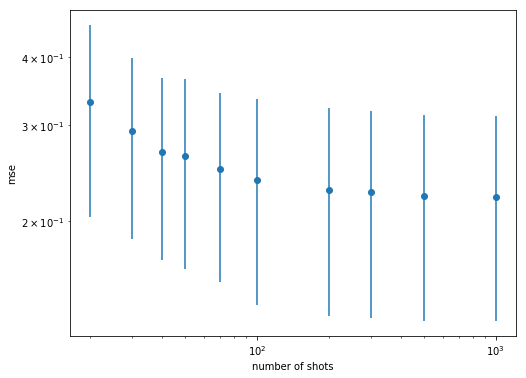

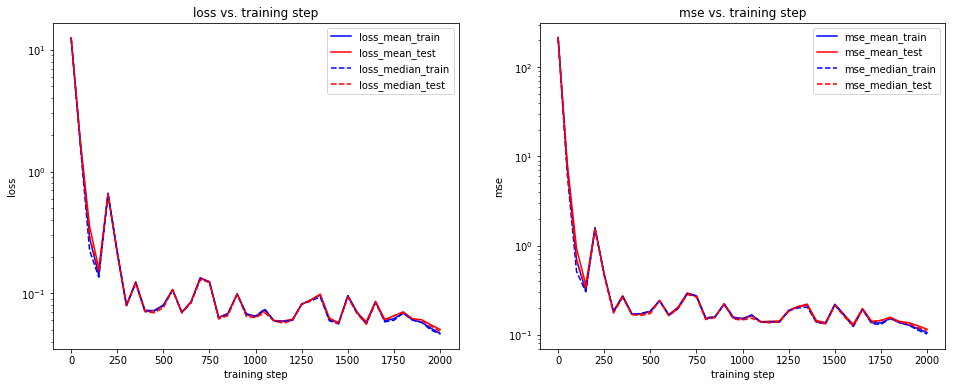

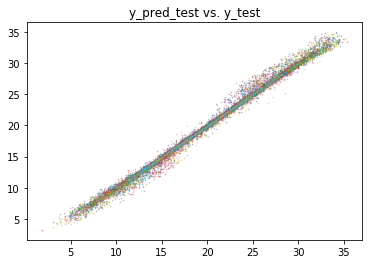

test statistics vs. z:


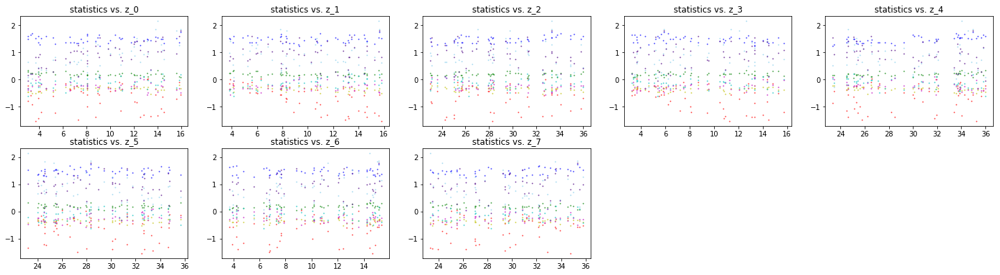

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


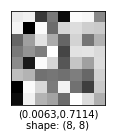


statistics correlation matrix:


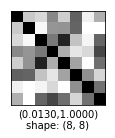


pca explained variance ratio:
[  4.94378716e-01   3.06625634e-01   1.59100026e-01   2.80213375e-02
   9.72981285e-03   1.10398047e-03   7.53046654e-04   2.87457602e-04]


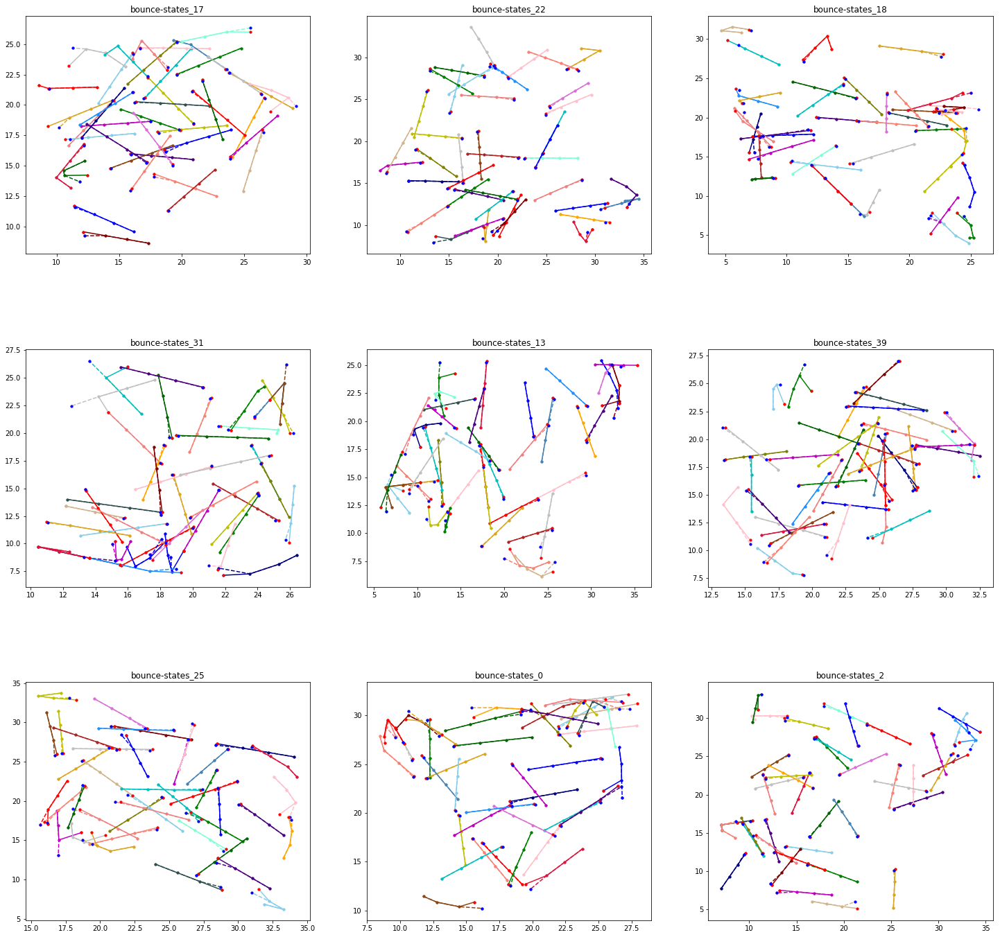


Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_600_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


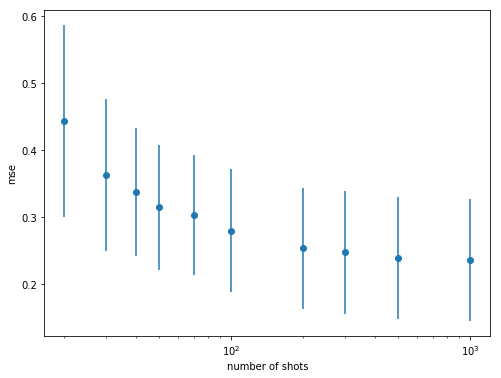

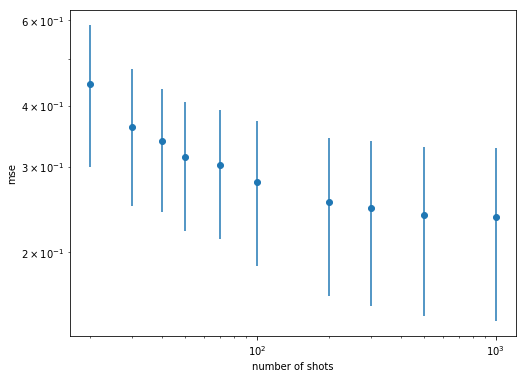

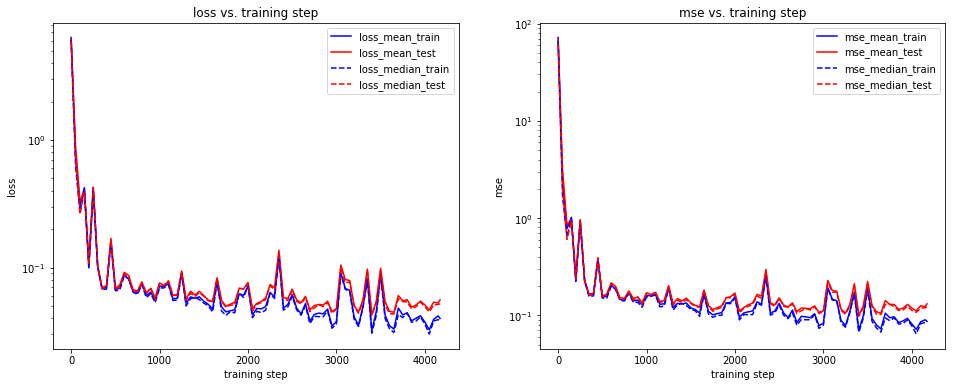

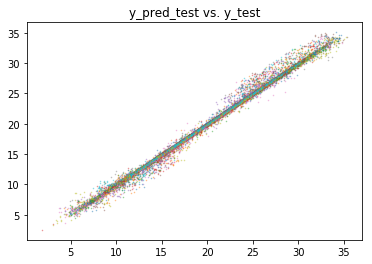

test statistics vs. z:


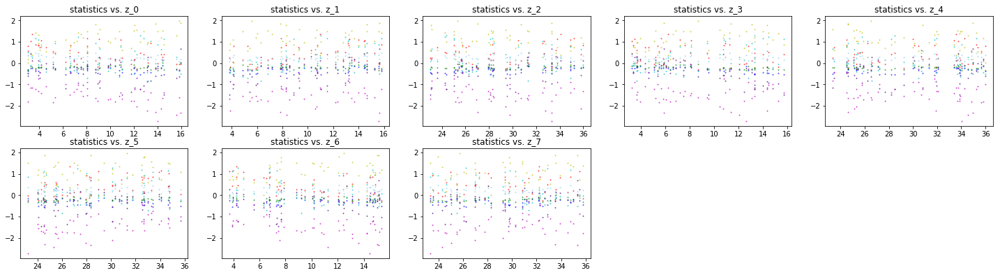

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


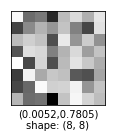


statistics correlation matrix:


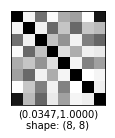


pca explained variance ratio:
[ 0.35916966  0.33827451  0.17113884  0.10588504  0.01886314  0.00557233
  0.00064431  0.00045215]


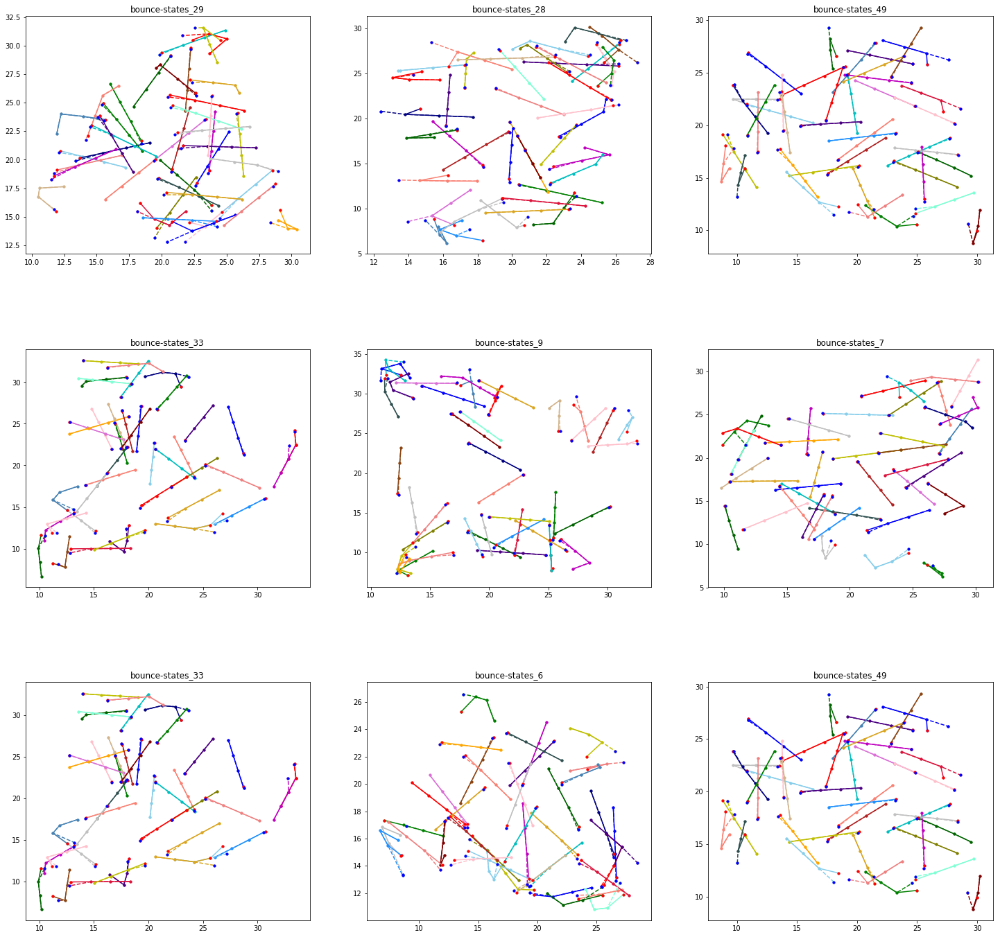


Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


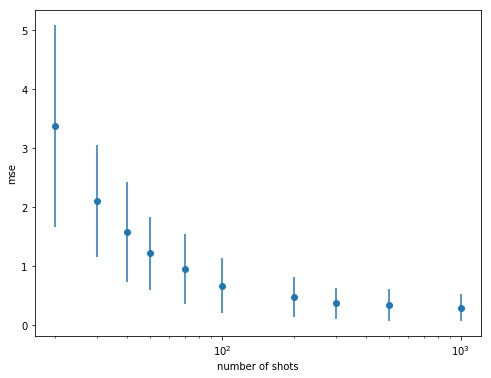

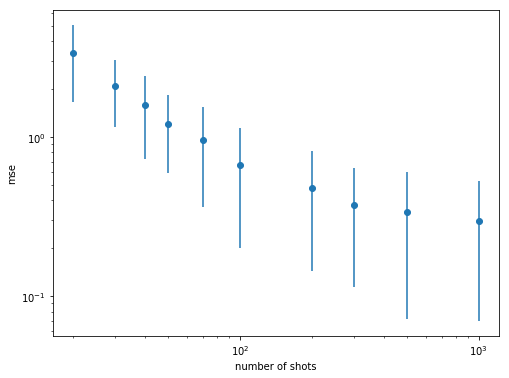

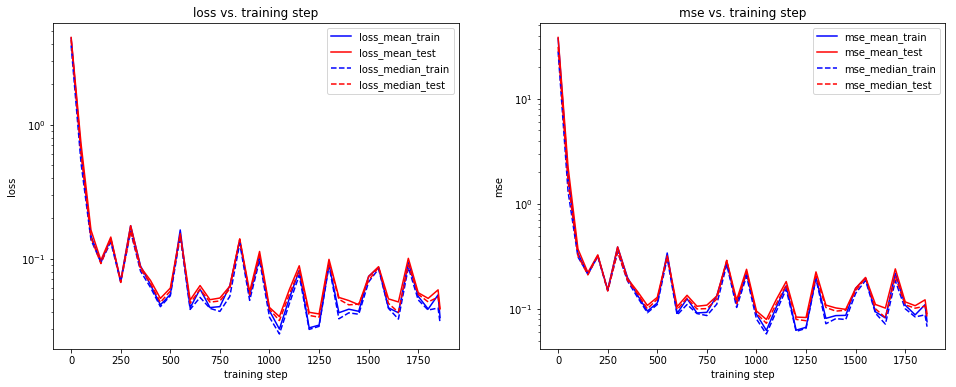

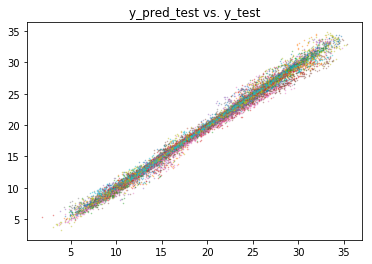

test statistics vs. z:


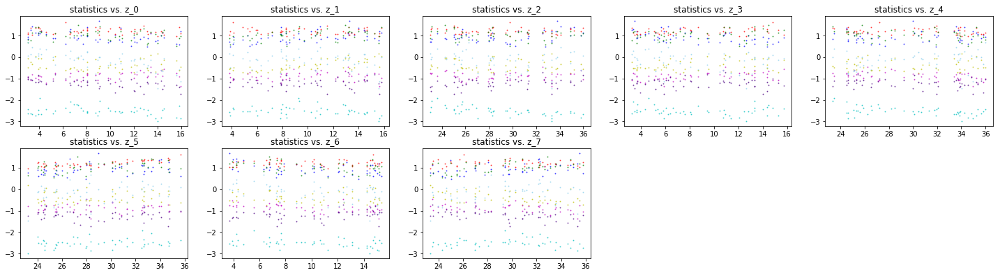

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


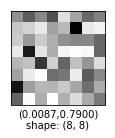


statistics correlation matrix:


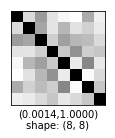


pca explained variance ratio:
[ 0.40940234  0.18389942  0.1374584   0.11579847  0.05488269  0.0437181
  0.03648487  0.01835568]


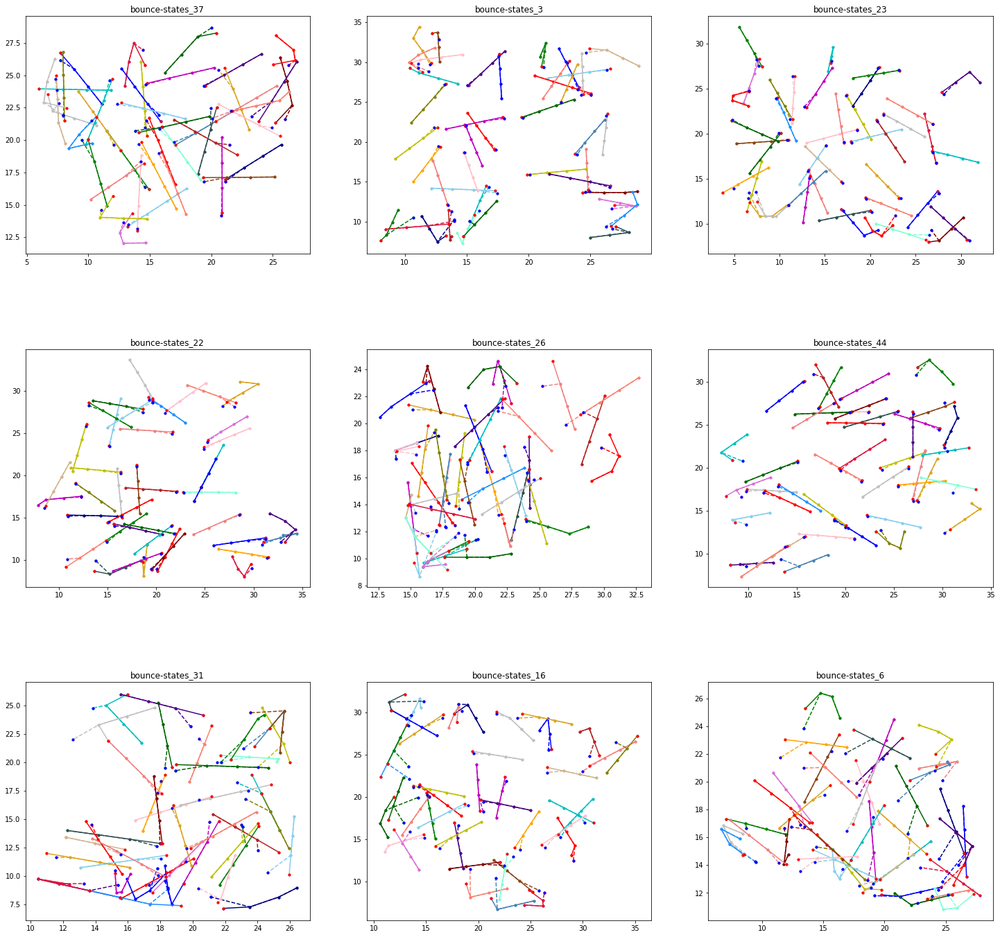


Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


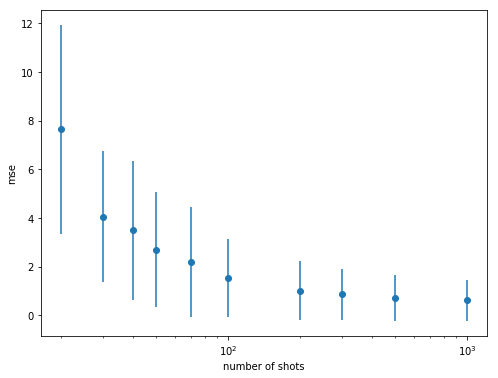

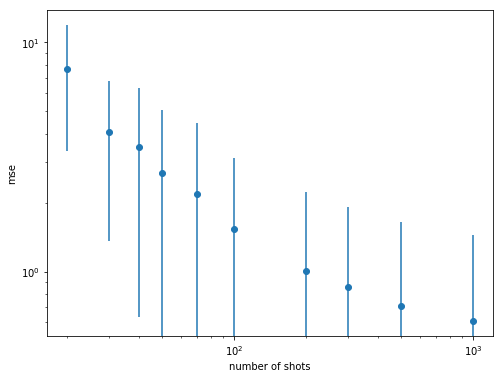

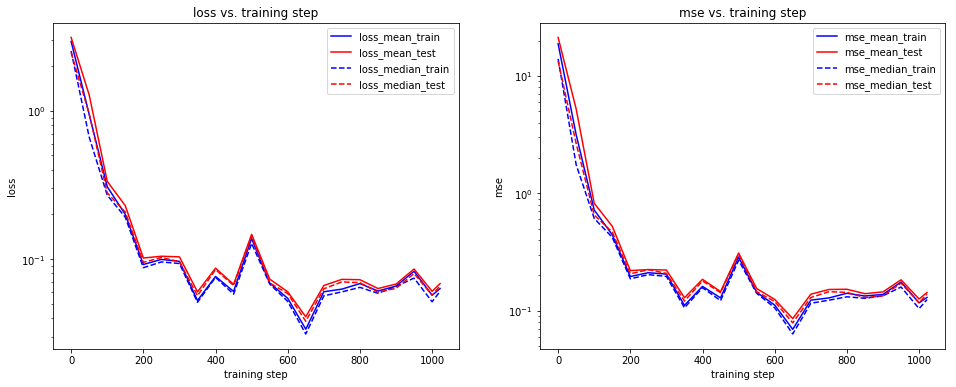

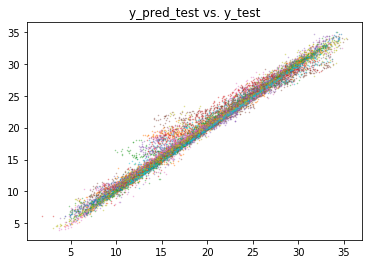

test statistics vs. z:


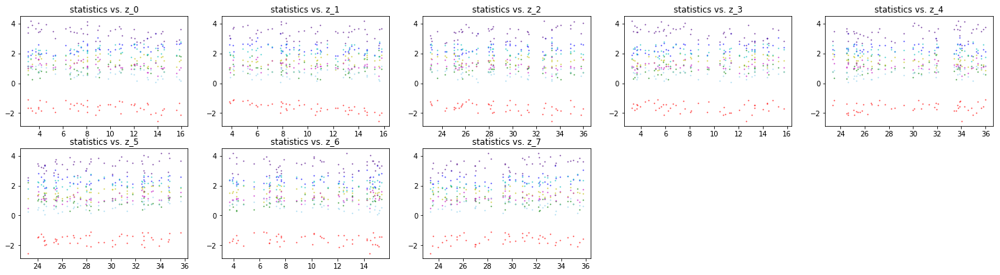

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


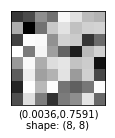


statistics correlation matrix:


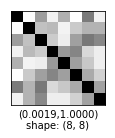


pca explained variance ratio:
[ 0.36880845  0.18760148  0.16448735  0.10076396  0.07097632  0.04727878
  0.03193222  0.02815144]


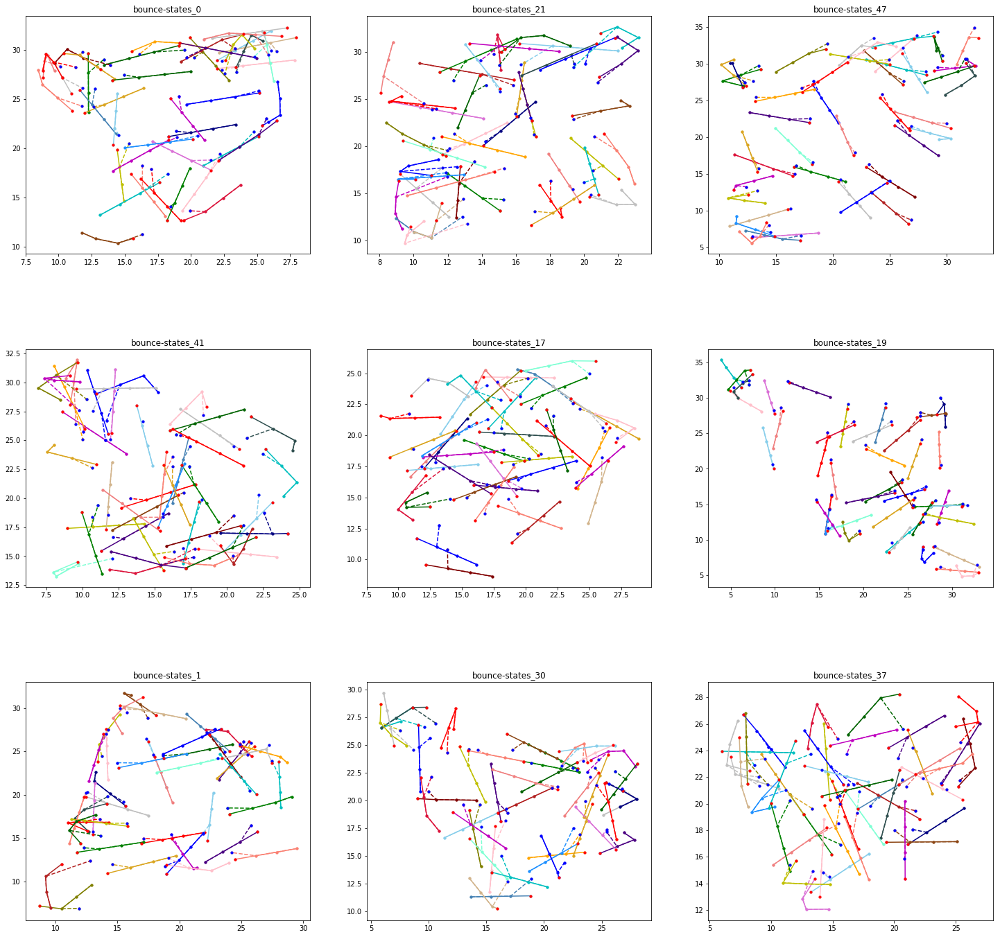


Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


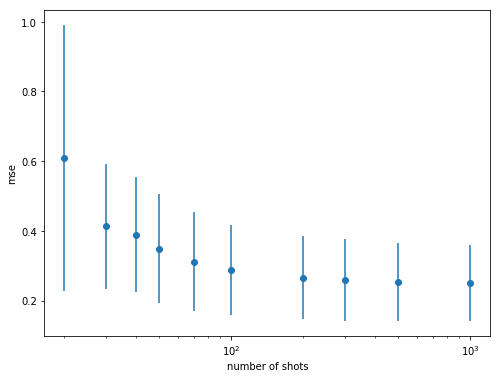

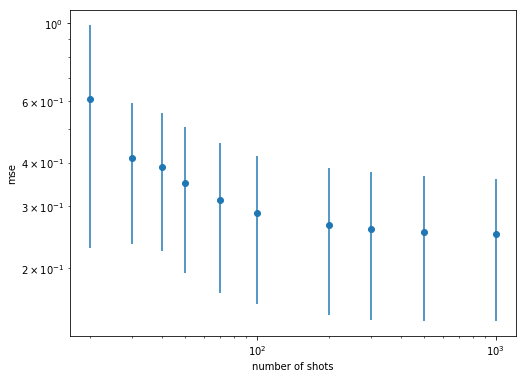

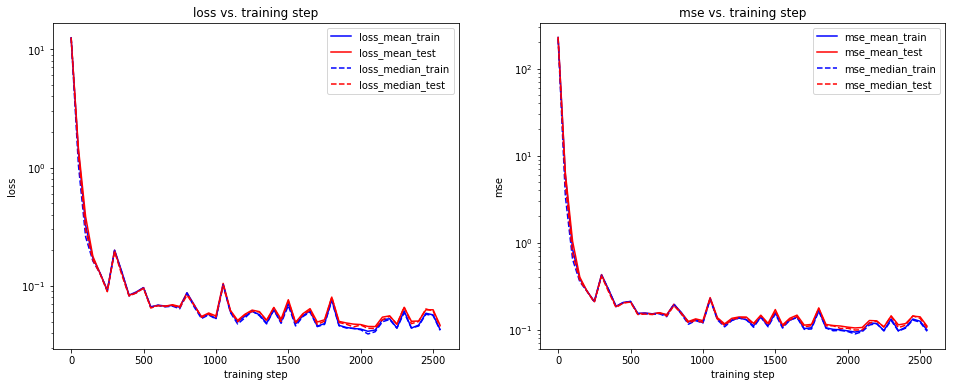

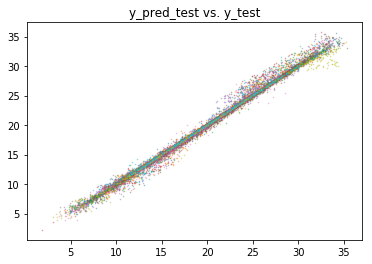

test statistics vs. z:


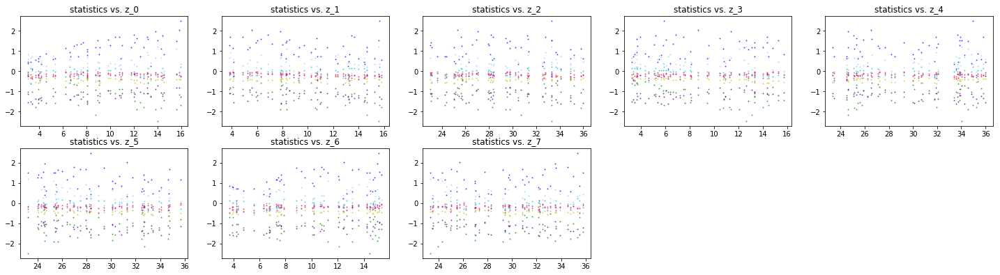

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


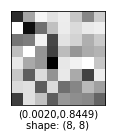


statistics correlation matrix:


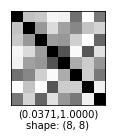


pca explained variance ratio:
[  4.59027410e-01   2.59657621e-01   2.22742200e-01   3.77112217e-02
   1.48940980e-02   5.39381430e-03   3.60558042e-04   2.13084641e-04]


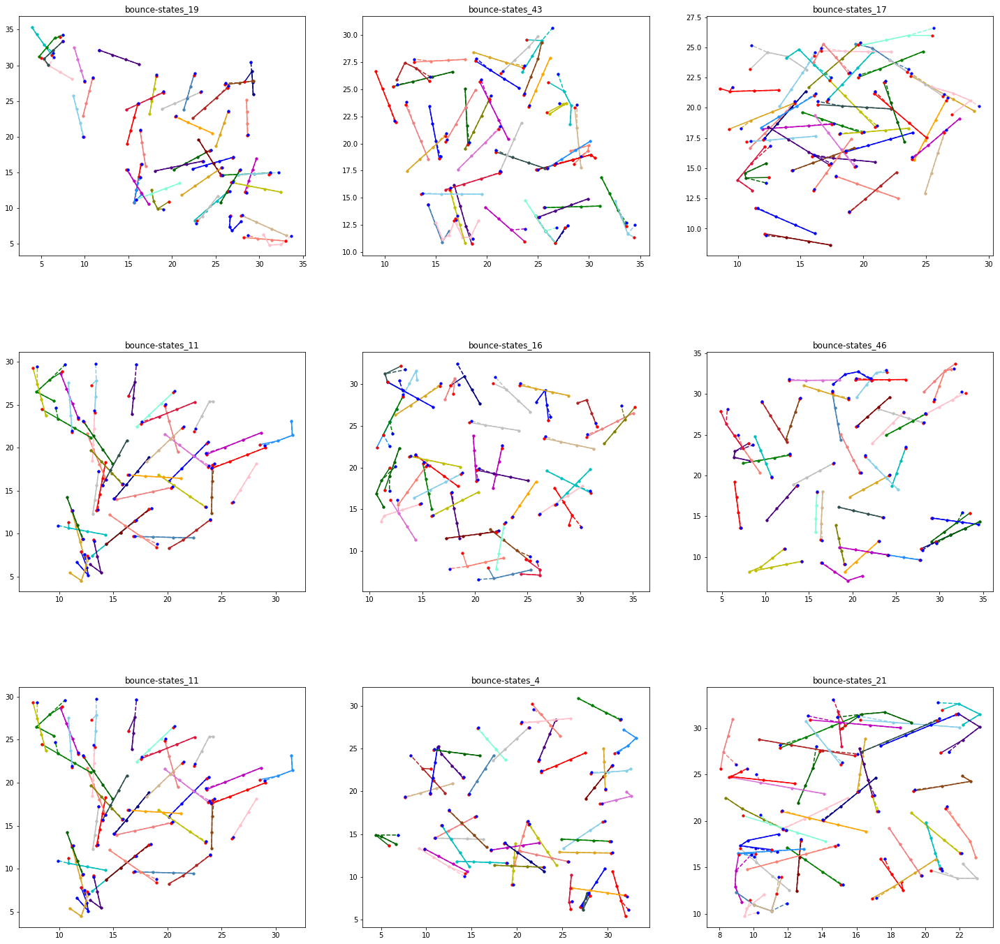


Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_relu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


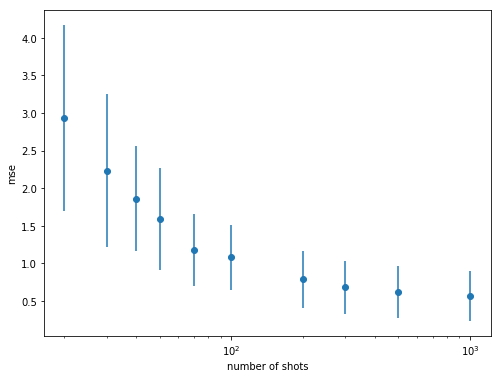

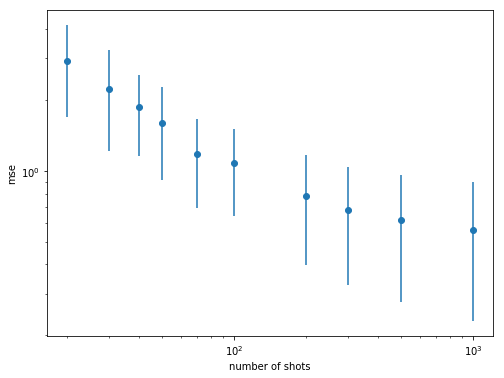

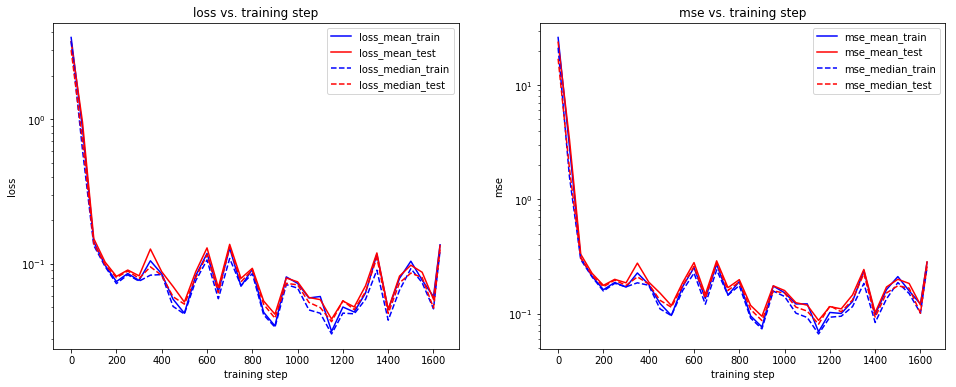

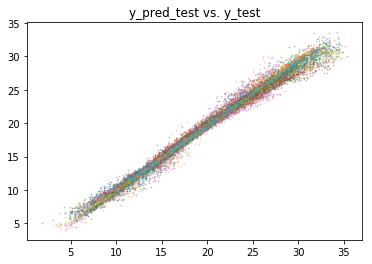

test statistics vs. z:


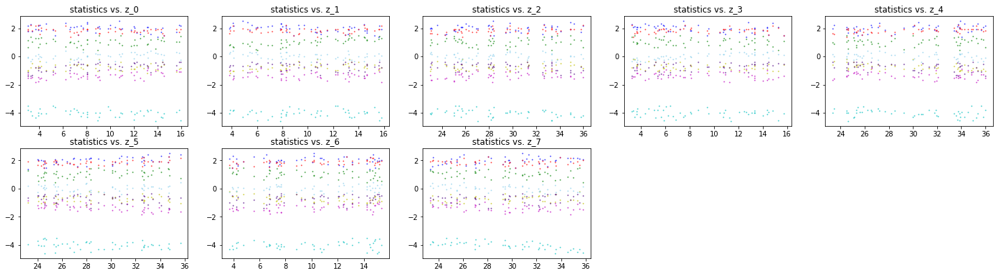

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


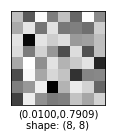


statistics correlation matrix:


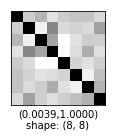


pca explained variance ratio:
[ 0.24962123  0.21818802  0.1711347   0.1273438   0.09735441  0.0683859
  0.04765148  0.02032047]


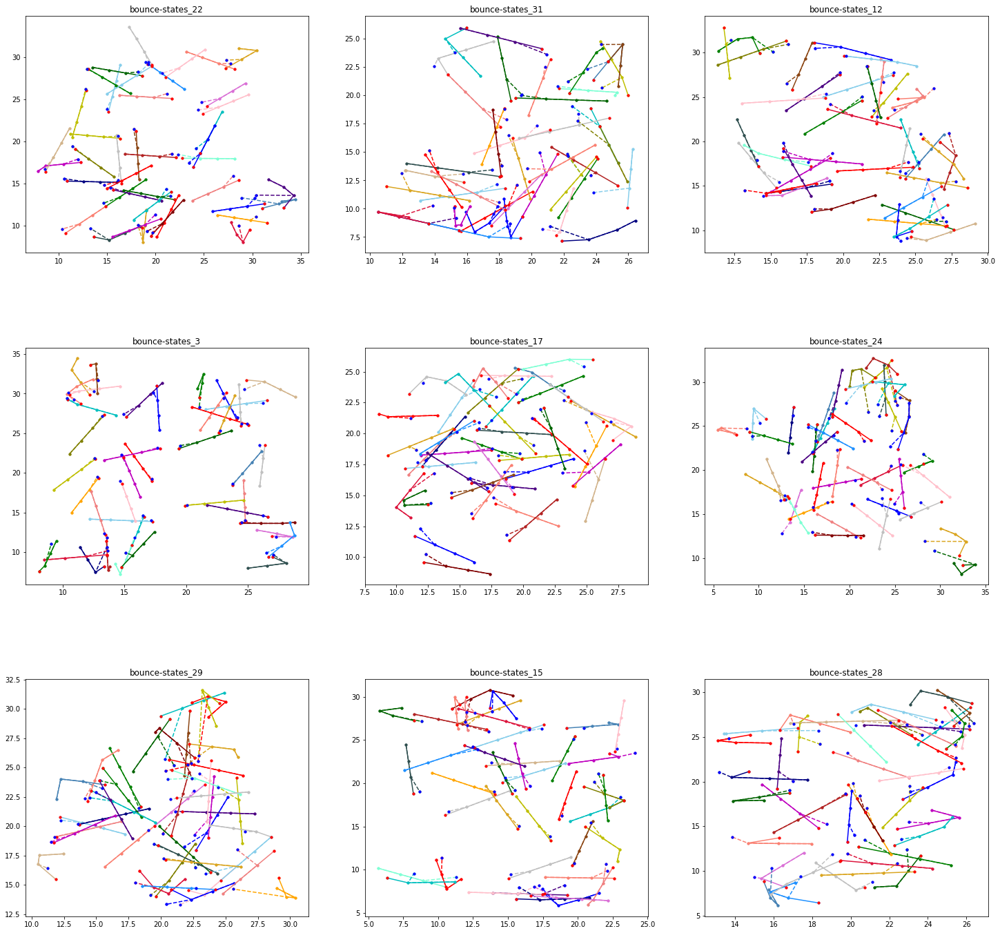


Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_relu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


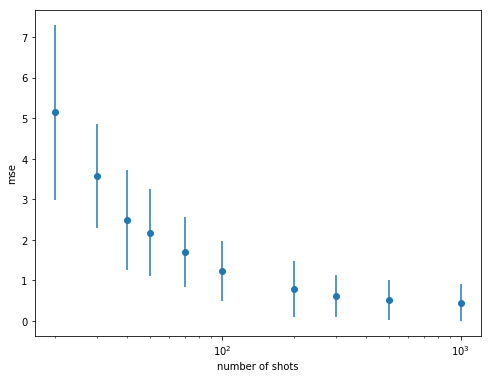

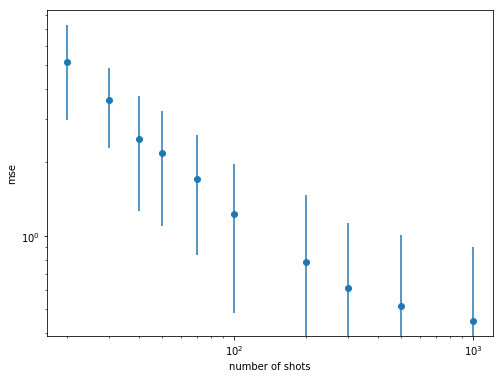

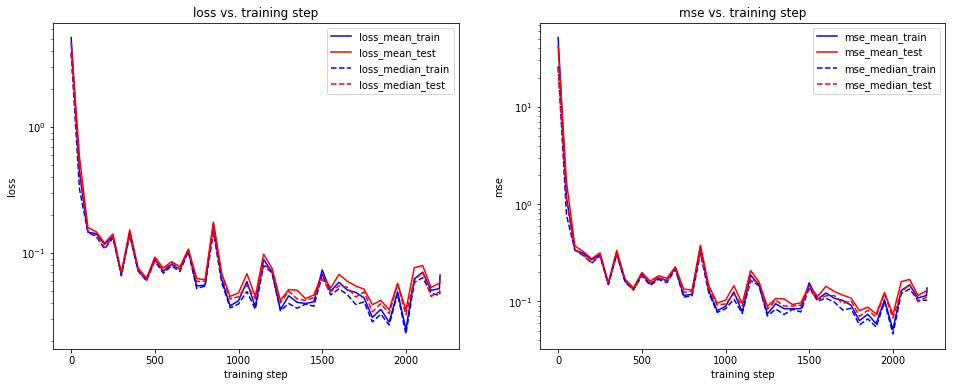

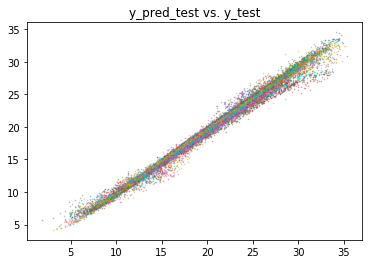

test statistics vs. z:


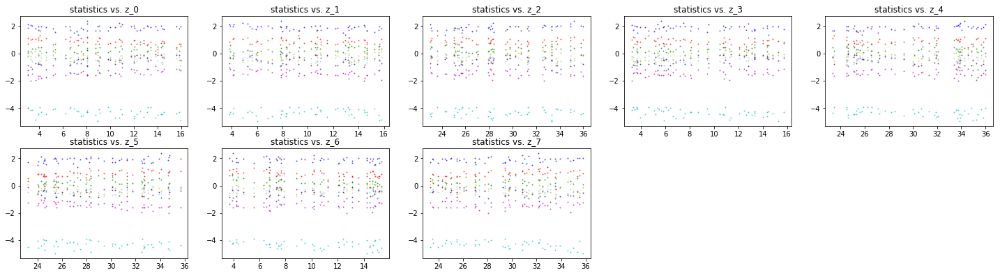

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


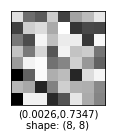


statistics correlation matrix:


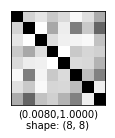


pca explained variance ratio:
[ 0.35117474  0.18265136  0.14423038  0.10158957  0.08607274  0.06879869
  0.04015791  0.0253246 ]


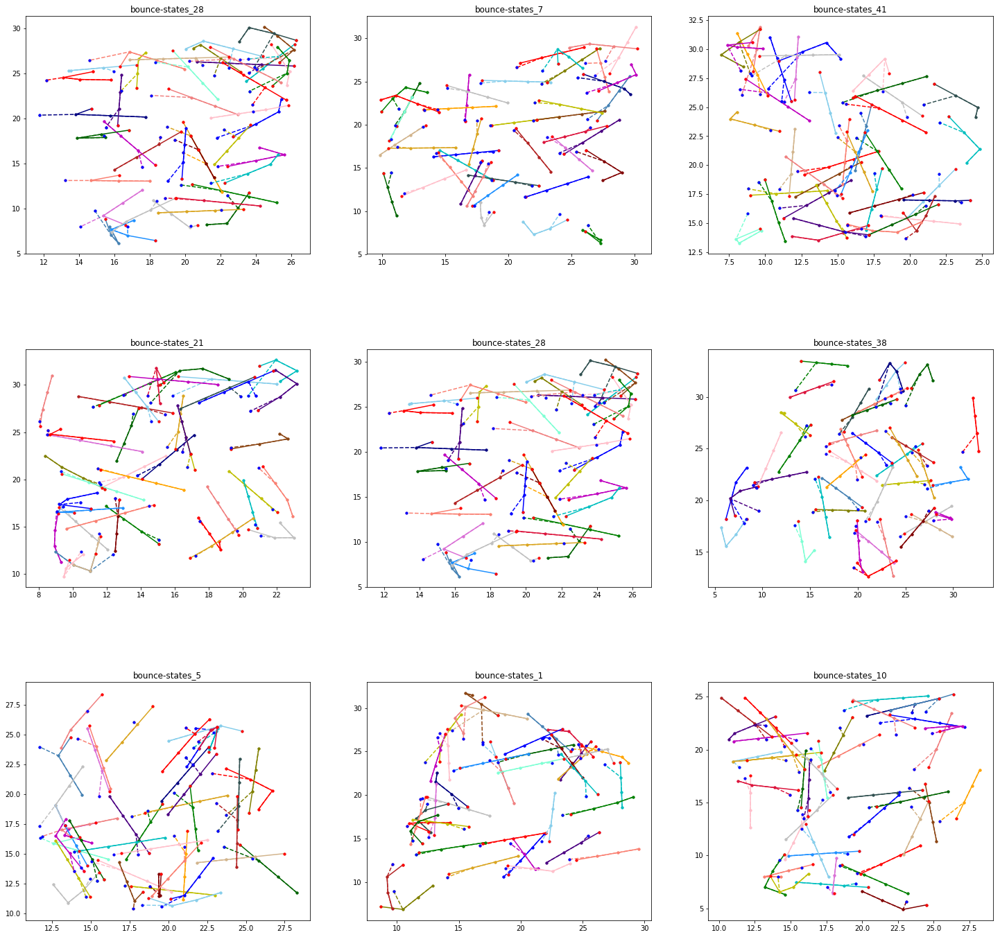

In [7]:
exp_id = "May3.1"  # First experiment
df = load_df(exp_id)

In [9]:
df.sort_values(by = "median_last")[["mean_last", "median_last", "mean_min", "median_min", "filename", "pre_pooling_neurons", "statistics_output_neurons", "is_VAE", "loss_core", "lr", "main_hidden_neurons", "num_context_neurons", "activation_gen", "activation_model"]]

,mean_last,median_last,mean_min,median_min,filename,pre_pooling_neurons,statistics_output_neurons,is_VAE,loss_core,lr,main_hidden_neurons,num_context_neurons,activation_gen,activation_model
7,0.128693,0.110109,0.073097,0.067422,"Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_relu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",400,8,False,huber,5e-05,"(40, 80, 40)",0,relu,leakyRelu
2,0.121362,0.116186,0.099948,0.097306,"Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_600_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",600,8,True,huber,5e-05,"(40, 80, 40)",0,leakyRelu,leakyRelu
3,0.137684,0.120645,0.079368,0.072962,"Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",400,8,False,huber,5e-05,"(40, 80, 40)",0,leakyRelu,leakyRelu
5,0.131244,0.127548,0.104311,0.098587,"Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",400,8,True,huber,5e-05,"(40, 80, 40)",0,leakyRelu,leakyRelu
6,0.155280,0.137708,0.087374,0.080968,"Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_relu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",400,8,False,huber,5e-05,"(40, 80, 40)",0,relu,relu
1,0.141014,0.137790,0.115318,0.110703,"Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",200,8,True,huber,5e-05,"(40, 80, 40)",0,leakyRelu,leakyRelu
4,0.148932,0.138753,0.085527,0.078612,"Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",200,8,False,huber,5e-05,"(40, 80, 40)",0,leakyRelu,relu
0,0.169753,0.147686,0.058606,0.052199,"Net_('bounce-states',)_input_6_(100,100)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p",400,8,False,huber,5e-05,"(40, 80, 40)",0,leakyRelu,relu


## Specific test:


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


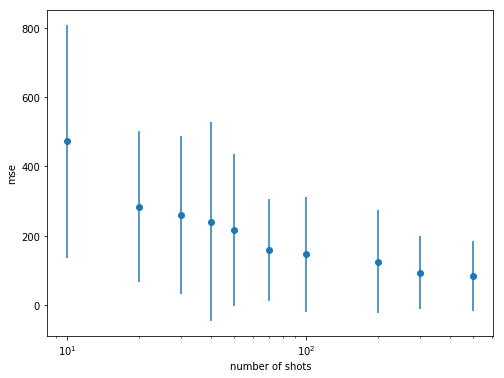

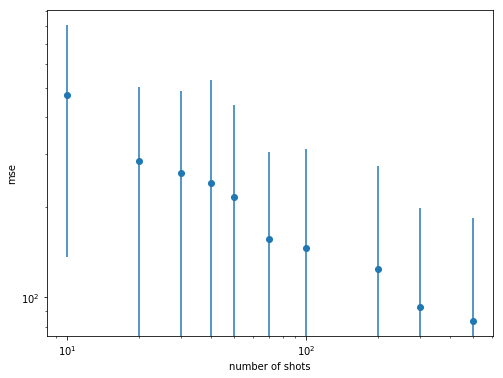

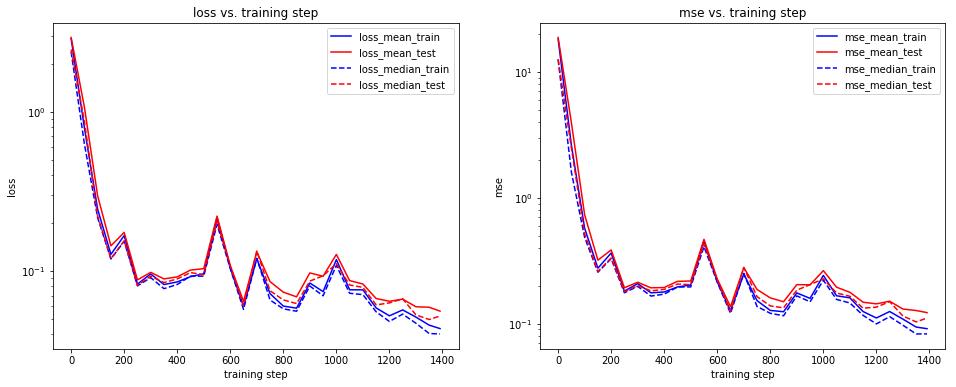

mean_last: 0.139831	mean_min: 0.122202	median_last: 0.126982	median_min: 0.103124


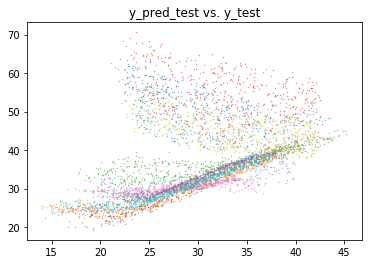

test statistics vs. z:


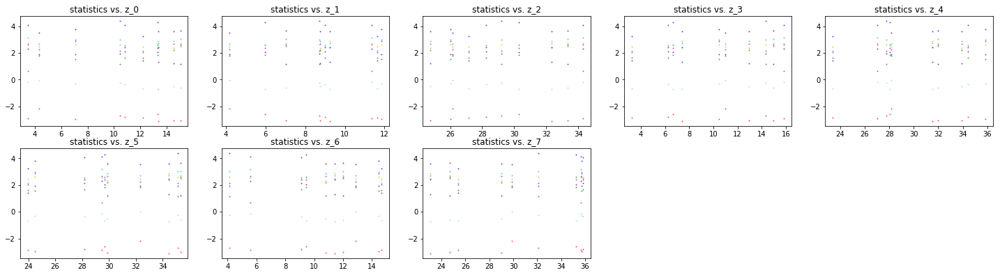

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


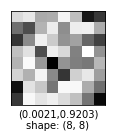


statistics correlation matrix:


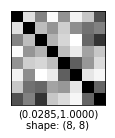


pca explained variance ratio:
[ 0.59309781  0.16503865  0.09725397  0.08042566  0.0395144   0.01739466
  0.00606304  0.00121177]


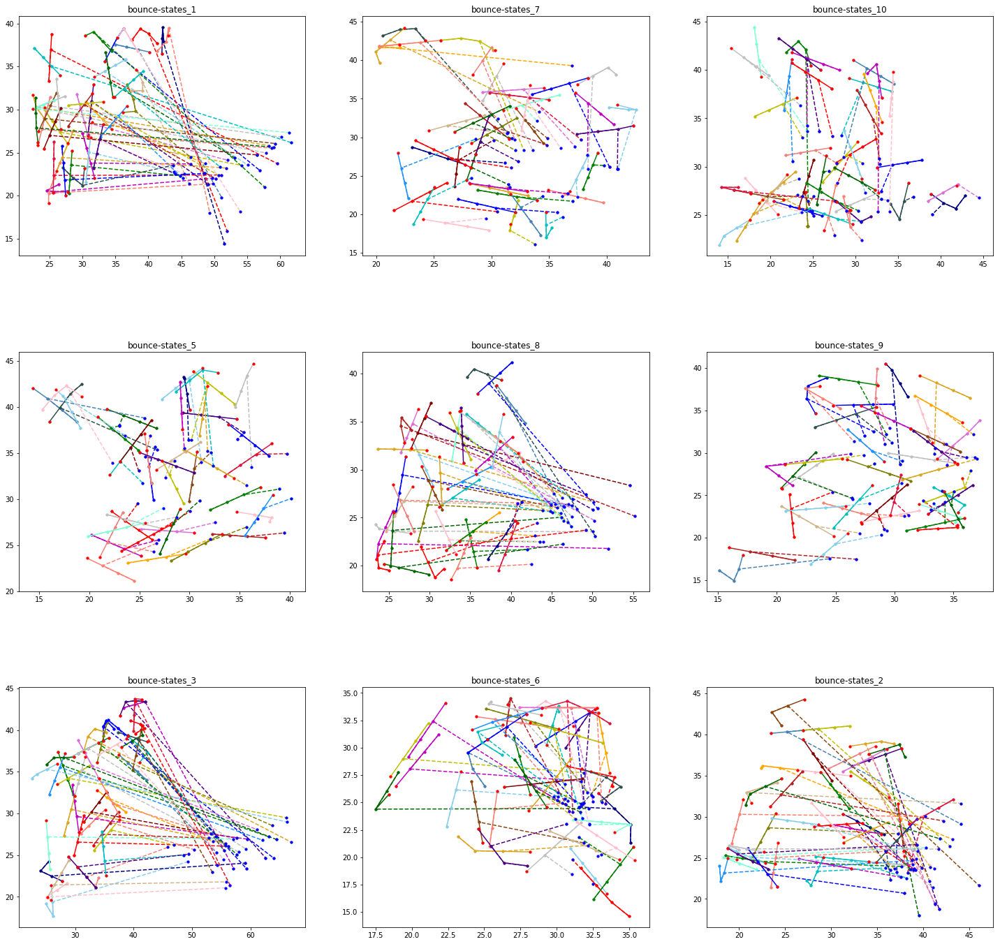

In [4]:
exp_id = "May3"
filename = "Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p"
master_model, info_dict, data_dict = load_file(exp_id, filename)

In [ ]:
task_id_list = [
# "latent-linear",
# "polynomial-3",
# "Legendre-3",
# "M-sawtooth",
# "M-sin",
# "M-Gaussian",
# "M-tanh",
# "M-softplus",
"bounce-states",
# "bounce-images",
]
input_size = 6
task_settings = {
    "num_examples": 1000,
    "test_size": 0.5
}
is_VAE = False
print("task_settings:\n", task_settings)
num_test_tasks = 10
tasks_train, tasks_test = get_tasks(task_id_list, 1, num_test_tasks, task_settings = task_settings, 
                                    step_dt = 0.5, is_flatten = True, bounce_focus = False, normalize = False,
                                    translation = (-10,10))

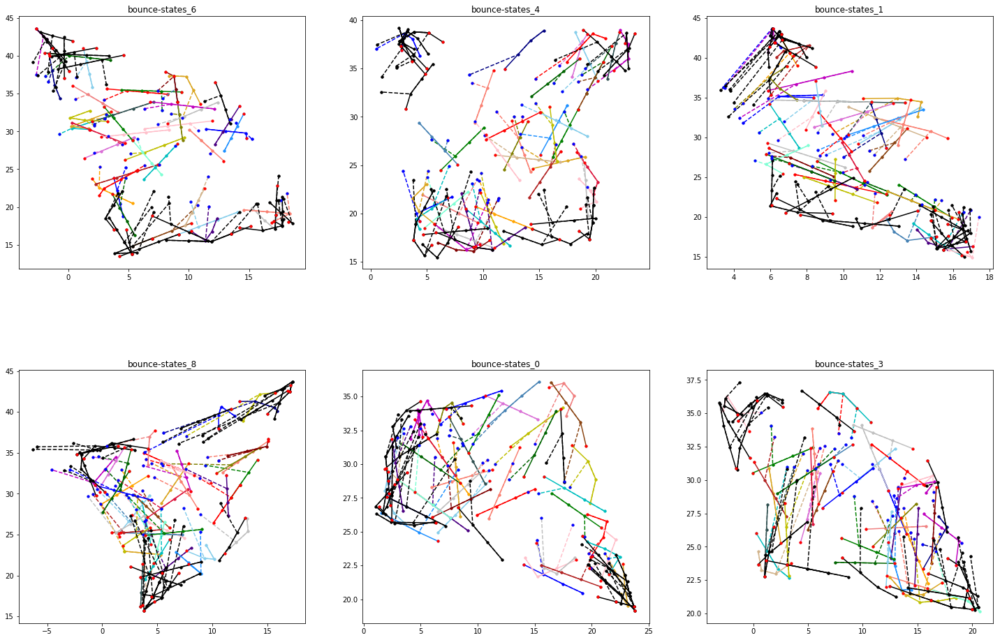

In [14]:
plot_individual_tasks_bounce(tasks_test, num_examples_show = 40, num_tasks_show = 6, master_model = master_model, num_shots = None, highlight_top = 20)

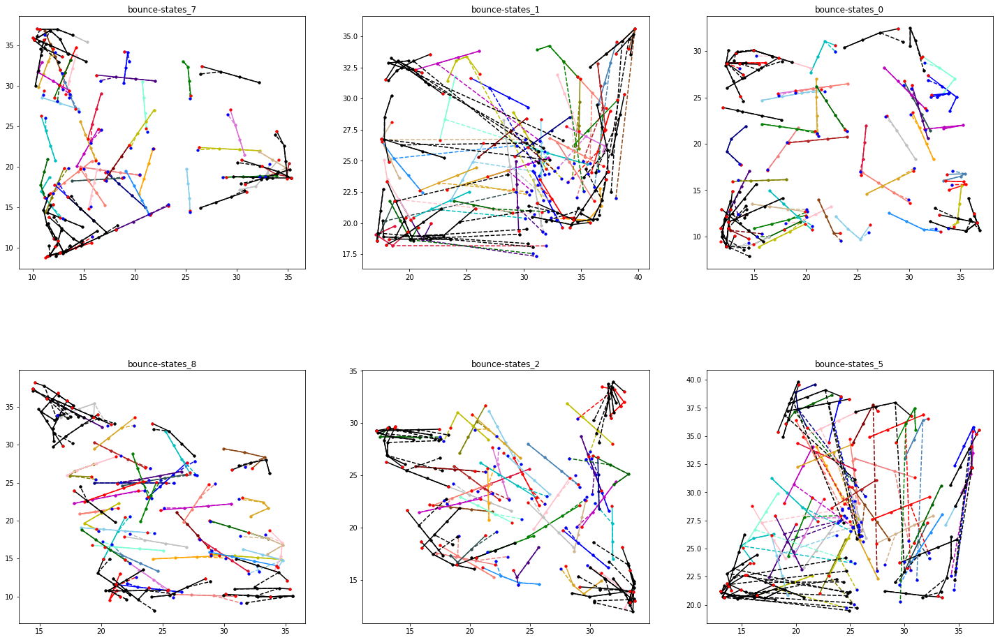

In [8]:
plot_individual_tasks_bounce(tasks_test, num_examples_show = 40, num_tasks_show = 6, master_model = master_model, num_shots = None, highlight_top = 20)

In [7]:
task = tasks_train[list(tasks_train.keys())[0]]
((X_train, y_train), (X_test, y_test)), _ = task

In [8]:
master_model.get_statistics(X_train, y_train)
master_model.use_clone_net()
model = master_model.cloned_net

master_model.use_clone_net(clone_parameters=False)
model2 = master_model.cloned_net

In [12]:
from mela.pytorch.util_pytorch import get_activation, get_optimizer, get_criterion, Loss_Fun, to_Variable, to_np_array
import torch.utils.data as data_utils
from mela.variational.variational_meta_learning import quick_learn, plot_quick_learn_performance
mse_list = quick_learn(model, X_train, y_train, validation_data = (X_test, y_test), loss_core = "huber", batch_size = 128, epochs = 50, lr = 1e-3, optim_type = "adam")

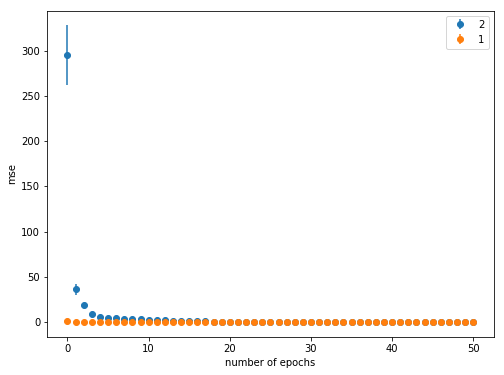

In [13]:
mse_dict = plot_quick_learn_performance(models = {"1": model, "2": model2}, tasks = tasks_test, lr = 5e-4)

In [7]:
is_VAE = False

In [16]:
task_id_list = [
# "latent-linear",
# "polynomial-3",
# "Legendre-3",
# "M-sawtooth",
# "M-sin",
# "M-Gaussian",
# "M-tanh",
# "M-softplus",
"bounce-states",
# "bounce-images",
]
input_size = 6
task_settings = {
    "num_examples": 1000,
    "test_size": 0.5
}
is_VAE = False
print("task_settings:\n", task_settings)
num_test_tasks = 10
tasks_train, tasks_test = get_tasks(task_id_list, 1, num_test_tasks, task_settings = task_settings, 
                                    step_dt = 0.5, is_flatten = True, bounce_focus = False, normalize = False,
                                    translation = None)

[2018-05-10 11:54:36,070] Making new env: Breakout_Custom-v0


task_settings:
 {'test_size': 0.5, 'num_examples': 1000}
corrected boundaries: [(11.354721383318145, 15.179795341432525), (30.59470040188632, 3.3906653669351536), (31.393327339253155, 29.907203689881783), (7.042367907974069, 33.2638708311823)]
corrected step_dt: 0.5
0 break for going outsize the max_range
1 break for going outsize the max_range
4 break for going outsize the max_range
5 break for going outsize the max_range
6 break for going outsize the max_range
6 break for going outsize the max_range


Exception ignored in: <bound method Env.__del__ of <TimeLimit<Breakout_Custom<Breakout_Custom-v0>>>>
Traceback (most recent call last):
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 203, in __del__
    self.close()
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 166, in close
    self._close()
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 290, in _close
    return self.env.close()
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 164, in close
    self.render(close=True)
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 150, in render
    return self._render(mode=mode, close=close)
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/envs/my_games/Atari/Breakout.py", line 607, in _render
    self.viewer = Viewer(height = self.height, width = self.width, resize_ratio = 3)
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/envs/my_games/Atari/Breakout.py", line 620, in __init__
    from pyglet.

corrected boundaries: [(12.55540368199669, 11.46469578789026), (25.531214044921526, 3.018160128149469), (30.866943878687032, 31.438544028014903), (5.3269771828768615, 33.19670302148503)]
corrected step_dt: 0.5
1 break for going outsize the max_range
1 break for going outsize the max_range
4 break for going outsize the max_range


Exception ignored in: <bound method Env.__del__ of <TimeLimit<Breakout_Custom<Breakout_Custom-v0>>>>
Traceback (most recent call last):
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 203, in __del__
    self.close()
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 166, in close
    self._close()
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 290, in _close
    return self.env.close()
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 164, in close
    self.render(close=True)
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 150, in render
    return self._render(mode=mode, close=close)
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/envs/my_games/Atari/Breakout.py", line 607, in _render
    self.viewer = Viewer(height = self.height, width = self.width, resize_ratio = 3)
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/envs/my_games/Atari/Breakout.py", line 620, in __init__
    from pyglet.

7 break for going outsize the max_range
7 break for going outsize the max_range
corrected boundaries: [(6.5494194546894349, 12.063172051512989), (31.018382614642704, 4.065843516900906), (31.491886808073744, 33.802968344615124), (12.840918408805793, 33.15426987716149)]
corrected step_dt: 0.5


Exception ignored in: <bound method Env.__del__ of <TimeLimit<Breakout_Custom<Breakout_Custom-v0>>>>
Traceback (most recent call last):
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 203, in __del__
    self.close()
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 166, in close
    self._close()
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 290, in _close
    return self.env.close()
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 164, in close
    self.render(close=True)
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/core.py", line 150, in render
    return self._render(mode=mode, close=close)
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/envs/my_games/Atari/Breakout.py", line 607, in _render
    self.viewer = Viewer(height = self.height, width = self.width, resize_ratio = 3)
  File "/home/euler/.tmps/.tmp/AI_scientist/gym/gym/envs/my_games/Atari/Breakout.py", line 620, in __init__
    from pyglet.

corrected boundaries: [(14.783221557632855, 14.057265592431262), (29.434981340672074, 8.339422440625235), (28.57249565235972, 27.789282473607983), (13.563114532080293, 30.910284495762248)]
corrected step_dt: 0.5
0 break for going outsize the max_range
0 break for going outsize the max_range
0 break for going outsize the max_range
0 break for going outsize the max_range
1 break for going outsize the max_range
1 break for going outsize the max_range


KeyboardInterrupt: 

In [4]:
plot_individual_tasks_bounce(tasks_train, num_examples_show = 40, num_tasks_show = 6, master_model = master_model, num_shots = None, highlight_top = 20)

NameError: name 'master_model' is not defined

## New test tasks with step_dt = 1

In [5]:
df.sort_values(by = "median_last")[["mean_last", "median_last", "mean_min", "median_min", "filename", "pre_pooling_neurons", "statistics_output_neurons", "is_VAE", "loss_core", "lr", "main_hidden_neurons", "num_context_neurons", "activation_gen", "activation_model"]]

,mean_last,median_last,mean_min,median_min,filename,pre_pooling_neurons,statistics_output_neurons,is_VAE,loss_core,lr,main_hidden_neurons,num_context_neurons,activation_gen,activation_model
4,1.029231,0.921048,0.683999,0.583130,"Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p",400,8,True,huber,5e-05,"(40, 80, 40)",0,leakyRelu,leakyRelu
6,1.116991,0.948585,0.650016,0.555196,"Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_8_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p",200,8,False,huber,5e-05,"(40, 40)",8,leakyRelu,leakyRelu
3,1.251676,1.028748,0.694665,0.573012,"Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_True_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p",200,8,True,huber,5e-05,"(40, 80, 40)",0,leakyRelu,leakyRelu
7,1.127365,1.030707,0.830543,0.807290,"Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p",200,8,False,huber,5e-05,"(40, 80, 40)",0,leakyRelu,relu
0,1.152288,1.056659,0.878365,0.767482,"Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_relu_actmodel_relu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p",400,8,False,huber,5e-05,"(40, 80, 40)",0,relu,relu
8,1.201448,1.074859,0.768926,0.651588,"Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(60, 60, 60)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_2e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p",400,8,False,huber,2e-05,"(60, 60, 60)",0,leakyRelu,leakyRelu
5,1.419330,1.298942,0.988116,0.917082,"Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(80, 80, 80)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_2e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p",400,8,False,huber,2e-05,"(80, 80, 80)",0,leakyRelu,leakyRelu
2,1.542691,1.331221,0.724036,0.633975,"Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_mse_comparisonMay7_info.p",200,8,False,mse,5e-05,"(40, 40)",0,leakyRelu,leakyRelu
1,2.120242,1.869640,0.985669,0.973898,"Net_meta_('bounce-states',)_input_6_(100,50)_stat_8_pre_400_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_relu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_comparisonMay7_info.p",400,8,False,huber,5e-05,"(40, 80, 40)",0,relu,leakyRelu


## Specific testing:


Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p


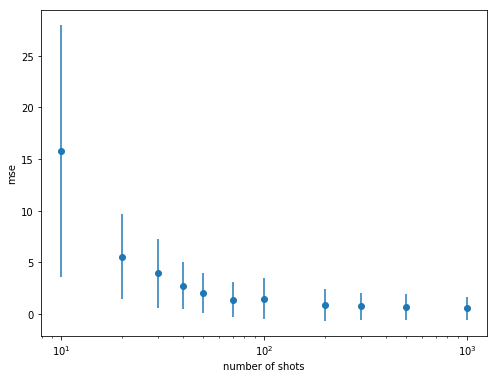

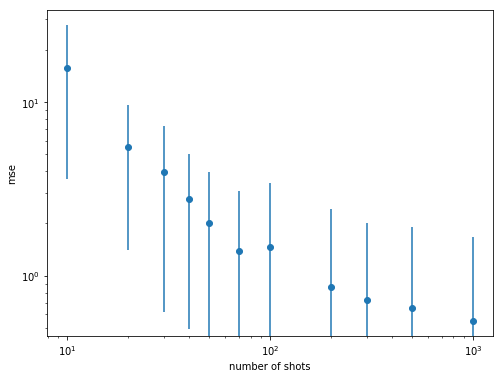

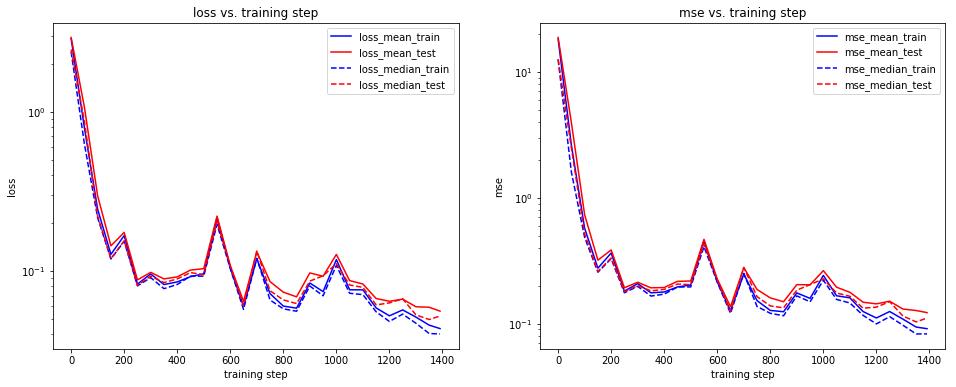

mean_last: 0.139831	mean_min: 0.122202	median_last: 0.126982	median_min: 0.103124


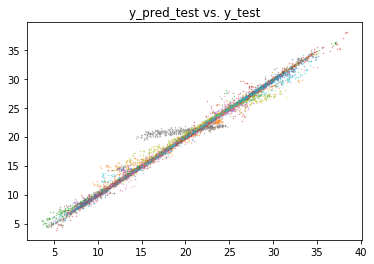

test statistics vs. z:


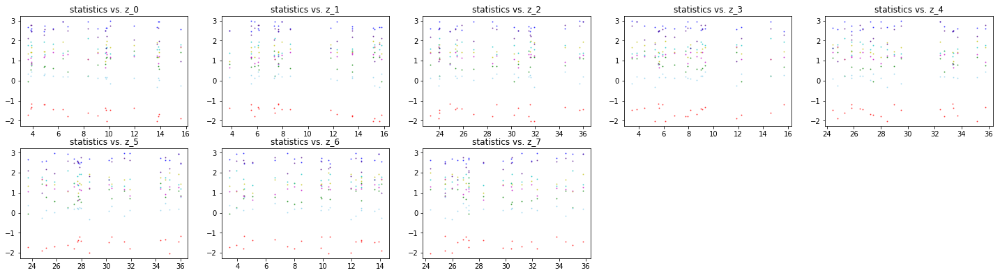

statistics (row) vs. z (column) pearsonr correlation coefficient (abs value):


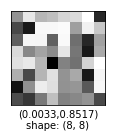


statistics correlation matrix:


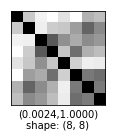


pca explained variance ratio:
[ 0.48569068  0.21453038  0.11136483  0.07482389  0.04630358  0.03649296
  0.01766679  0.01312691]


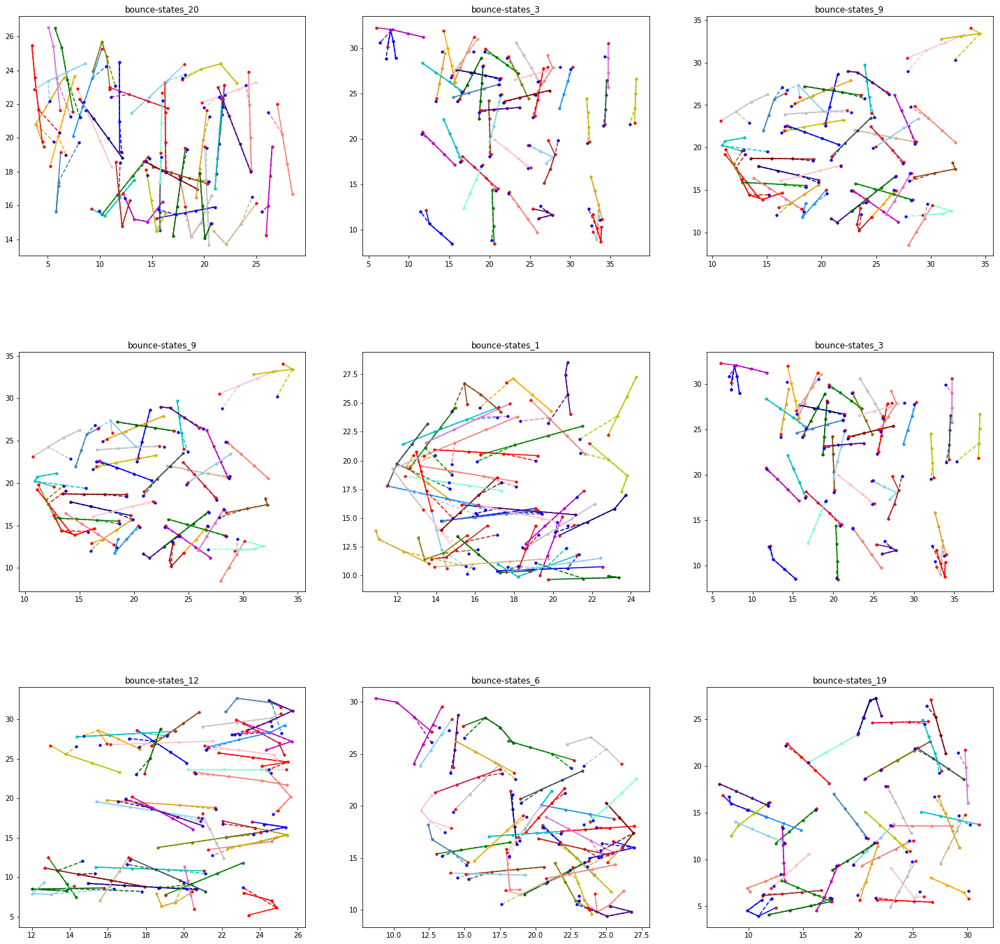

In [4]:
exp_id = "May3"
filename = "Net_('bounce-states',)_input_6_(100,50)_stat_8_pre_200_pool_max_context_0_hid_(40, 80, 40)_batch_100_back_1_VAE_False_0.2_uncer_False_lr_5e-05_reg_1e-06_actgen_leakyRelu_actmodel_leakyRelu_struct_60Si-60Si-60Si_indi_core_huber_May3_info.p"
master_model, info_dict, data_dict = load_file(exp_id, filename)

## Three different analysis:

In [ ]:
# plot_types = ["standard"]
plot_types = ["gradient"]
# plot_types = ["slider"]

for plot_type in plot_types:
    if plot_type == "standard":
        plot_data_record(data_record, is_VAE = is_VAE)

        statistics_list_test, z_list_test = plot_task_ensembles(tasks_test, statistics_Net, generative_Net, is_VAE = is_VAE, title = "y_pred_test vs. y_test")
        print("test statistics vs. z:")
        plot_statistics_vs_z(z_list_test, statistics_list_test)
        _ = plot_individual_tasks(tasks_test, statistics_Net, generative_Net, is_VAE = is_VAE, xlim = task_settings["xlim"])

    elif plot_type == "gradient":
        batch_size = 256
        sample_task_id = task_id_list[0] + "_{0}".format(np.random.randint(num_test_tasks))
        print("sample_task_id: {0}".format(sample_task_id))
        ((X_train, y_train), (X_test, y_test)), _ = tasks_test[sample_task_id]
        epochs_statistics = 50
        lr_statistics = 1e-3
        optim_type_statistics = "adam"

        # epochs = 50
        # lr = 1e-3
        # optimizer = "adam"

        epochs = 50
        lr = 1e-3
        optim_type = "adam"

        master_model.get_statistics(X_train, y_train)
        y_pred = master_model(X_test)
        loss_list_0 = master_model.latent_param_quick_learn(X_train, y_train, validation_data = (X_test, y_test), batch_size = batch_size, 
                                                            epochs = epochs_statistics, lr = lr_statistics, optim_type = optim_type_statistics)
        y_pred_new = master_model(X_test)
        plt.plot(X_test.data.numpy(), y_test.data.numpy(), ".b", label = "target", markersize = 2, alpha = 0.6)
        plt.plot(X_test.data.numpy(), y_pred.data.numpy(), ".r", label = "initial", markersize = 2, alpha = 0.6)
        plt.plot(X_test.data.numpy(), y_pred_new.data.numpy(), ".y", label = "optimized", markersize = 2, alpha = 0.6)
        plt.plot(X_train.data.numpy(), y_train.data.numpy(), ".k", markersize = 5, label = "training points")
        plt.title("Only optimizing latent variable, validation")
        plt.legend()
        plt.show()

        master_model.get_statistics(X_train, y_train)
        master_model.use_clone_net(clone_parameters = True)
        y_pred = master_model(X_test)
        loss_list_1 = master_model.clone_net_quick_learn(X_train, y_train, validation_data = (X_test, y_test), batch_size = batch_size, 
                                                         epochs = epochs, lr = lr, optim_type = optim_type)
        y_pred_new = master_model(X_test)
        plt.plot(X_test.data.numpy(), y_test.data.numpy(), ".b", label = "target", markersize = 2, alpha = 0.6)
        plt.plot(X_test.data.numpy(), y_pred.data.numpy(), ".r", label = "initial", markersize = 2, alpha = 0.6)
        plt.plot(X_test.data.numpy(), y_pred_new.data.numpy(), ".y", label = "optimized", markersize = 2, alpha = 0.6)
        plt.plot(X_train.data.numpy(), y_train.data.numpy(), ".k", markersize = 5, label = "training points")
        plt.legend()
        plt.title("Optimizing cloned net, validation")
        plt.show()

        master_model.get_statistics(X_train, y_train)
        master_model.use_clone_net(clone_parameters = False)
        W_core, _ = master_model.cloned_net.get_weights_bias(W_source = "core")
        y_pred = master_model(X_test)
        loss_list_2 = master_model.clone_net_quick_learn(X_train, y_train, validation_data = (X_test, y_test), batch_size = batch_size, 
                                                         epochs = epochs, lr = lr, optim_type = optim_type)
        y_pred_new = master_model(X_test)
        plt.plot(X_test.data.numpy(), y_test.data.numpy(), ".b", label = "target", markersize = 3, alpha = 0.6)
        plt.plot(X_test.data.numpy(), y_pred.data.numpy(), ".r", label = "initial", markersize = 3, alpha = 0.6)
        plt.plot(X_test.data.numpy(), y_pred_new.data.numpy(), ".y", label = "optimized", markersize = 3, alpha = 0.6)
        plt.plot(X_train.data.numpy(), y_train.data.numpy(), ".k", markersize = 5, label = "training points")
        plt.xlabel("epochs")
        plt.ylabel("mse loss")
        plt.legend()
        plt.title("Optimizing from_scratch, validation")
        plt.show()

        plt.plot(range(len(loss_list_0)), loss_list_0, label = "loss_optim_latent_param")
        plt.plot(range(len(loss_list_1)), loss_list_1, label = "loss_clone")
        plt.plot(range(len(loss_list_2)), loss_list_2, label = "loss_scratch")
        plt.legend()
        plt.show()
        plt.semilogy(range(len(loss_list_0)), loss_list_0, label = "loss_optim_latent_param")
        plt.semilogy(range(len(loss_list_1)), loss_list_1, label = "loss_clone")
        plt.semilogy(range(len(loss_list_2)), loss_list_2, label = "loss_scratch")

        plt.legend()
        plt.show()

    elif plot_type == "slider":
        from matplotlib.widgets import Slider, Button, RadioButtons
        import matplotlib
        num_tasks_sampled = 10
        rand_id = sorted(np.random.randint(num_test_tasks, size = num_tasks_sampled))
        task_dict = {}
        sample_task_ids = []
        for i, idx in enumerate(rand_id):
            sample_task_id = task_id_list[0] + "_{0}".format(idx)
            sample_task_ids.append(sample_task_id)
            ((X_train, y_train), (X_test, y_test)), _ = tasks_test[sample_task_id]
            if i == 0:
                X_test_0, y_test_0 = X_test, y_test
                X_train_0, y_train_0 = X_train, y_train
            task_dict[sample_task_id] = [[X_train, y_train], [X_test, y_test]]
        X_train, y_train = X_train_0, y_train_0
        X_test, y_test = X_test_0, y_test_0

        if is_VAE:
            statistics = statistics_Net(torch.cat([X_train, y_train], 1))[0][0]
        else:
            statistics = statistics_Net(torch.cat([X_train, y_train], 1))[0]
        statistics_numpy = statistics.data.numpy()
        relevance = get_relevance(X_train, y_train, statistics_Net)
        pred = generative_Net(X_test, statistics)
        W_core, _ = generative_Net.get_weights_bias(W_source = "core")
        num_layers = len(W_core)

        fig, ax = plt.subplots(figsize = (9, 7.5))
        plt.subplots_adjust(left=0.25, bottom=0.27)
        ss0, ss1, ss2, ss3 = statistics_numpy.squeeze().tolist()
        subplt1 = plt.subplot2grid((3, num_layers), (0,0), rowspan = 2, colspan = num_layers)

        l_button_test, = subplt1.plot(X_test.data.numpy(), y_test.data.numpy(), ".r", markersize = 2, alpha = 0.6, label = "testing target")
        l_button, = subplt1.plot(X_train.data.numpy(), y_train.data.numpy(), ".k", markersize = 4, alpha = 0.6, label = "training point")
        # subplt1.scatter(X_train.data.numpy(), y_train.data.numpy(), s = relevance * 5 + 1, c = "k", alpha = 0.6)
        if is_uncertainty_net:
            statistics_logvar = statistics_Net(torch.cat([X_train, y_train], 1))[1]
            pred_std = torch.exp(master_model.generative_Net_logstd(X_test, statistics_logvar))
            l_errormean, _, l_errorbar = subplt1.errorbar(X_test.data.numpy().squeeze(), pred.data.numpy().squeeze(), yerr = pred_std.data.numpy().squeeze(), color = "b", fmt = ".", markersize = 1, alpha = 0.2)
        else:
            l, = subplt1.plot(X_test.data.numpy(), pred.data.numpy(),'.b', markersize = 2, alpha = 0.6, label = "predicted")
        subplt1.axis([task_settings["xlim"][0], task_settings["xlim"][1], -5, 5])
        subplt1.legend()

        subplt2s = []
        for i in range(num_layers):
            subplt2 = plt.subplot2grid((3, num_layers), (2, i))
            scale_min = np.floor(np.min(W_core[i]))
            scale_max = np.ceil(np.max(W_core[i]))
            subplt2.matshow(W_core[i], cmap = matplotlib.cm.binary, vmin = scale_min, vmax = scale_max)
            subplt2.set_xticks(np.array([]))
            subplt2.set_yticks(np.array([]))
            subplt2.set_xlabel("({0:.3f}, {1:.3f})".format(scale_min, scale_max), fontsize = 10)

        axcolor = 'lightgoldenrodyellow'
        ax0 = plt.axes([0.25, 0.08, 0.65, 0.025], facecolor=axcolor)
        ax1 = plt.axes([0.25, 0.12, 0.65, 0.025], facecolor=axcolor)
        ax2 = plt.axes([0.25, 0.16, 0.65, 0.025], facecolor=axcolor)
        ax3 = plt.axes([0.25, 0.2, 0.65, 0.025], facecolor=axcolor)

        s0 = Slider(ax0, 'Statistics[0]', -3, 3, valinit=ss0)
        s1 = Slider(ax1, 'Statistics[1]', -3, 3, valinit=ss1)
        s2 = Slider(ax2, 'Statistics[2]', -3, 3, valinit=ss2)
        s3 = Slider(ax3, 'Statistics[3]', -3, 3, valinit=ss3)

        def update(val):
            (X_train, y_train), (X_test, y_test) = task_dict[radio.value_selected]
            statistics_numpy = np.array([[s0.val, s1.val, s2.val, s3.val]])
            statistics = Variable(torch.FloatTensor(statistics_numpy))
            pred = generative_Net(X_test, statistics)
            l.set_ydata(pred.data.numpy())
            l.set_xdata(X_test.data.numpy())
            W_core, _ = generative_Net.get_weights_bias(W_source = "core")
            for i in range(num_layers):
                subplt2 = plt.subplot2grid((3, num_layers), (2, i))
                scale_min = np.floor(np.min(W_core[i]))
                scale_max = np.ceil(np.max(W_core[i]))
                subplt2.matshow(W_core[i], cmap = matplotlib.cm.binary, vmin = scale_min, vmax = scale_max)
                subplt2.set_xticks(np.array([]))
                subplt2.set_yticks(np.array([]))
                subplt2.set_xlabel("({0:.3f}, {1:.3f})".format(scale_min, scale_max), fontsize = 10)
            fig.canvas.draw_idle()
        s0.on_changed(update)
        s1.on_changed(update)
        s2.on_changed(update)
        s3.on_changed(update)

        resetax = plt.axes([0.8, 0.025, 0.1, 0.04])
        button = Button(resetax, 'Reset', color=axcolor, hovercolor='0.975')
        button.label.set_fontsize(8)

        def reset(event):
            s0.reset()
            s1.reset()
            s2.reset()
            s3.reset()
        button.on_clicked(reset)

        rax = plt.axes([0.025, 0.5 - 0.01 * num_tasks_sampled, 0.18, 0.03 * num_tasks_sampled], facecolor = axcolor)
        radio = RadioButtons(rax, sample_task_ids, active=0)

        def update_y_test(label):
            # Update the target_data:
            (X_train, y_train), (X_test, y_test) = task_dict[label]
            l_button.set_ydata(y_train.data.numpy())
            l_button.set_xdata(X_train.data.numpy())
            l_button_test.set_ydata(y_test.data.numpy())
            l_button_test.set_xdata(X_test.data.numpy())

            # Update the fitted data:
            if is_VAE:
                statistics = statistics_Net(torch.cat([X_train, y_train], 1))[0][0]
            else:
                statistics = statistics_Net(torch.cat([X_train, y_train], 1))[0]
            pred = generative_Net(X_test, statistics)
            if is_uncertainty_net:
                statistics_logvar = statistics_Net(torch.cat([X_test, y_test], 1))[1]
                pred_std = torch.exp(master_model.generative_Net_logstd(X_test, statistics_logvar))
                l_errormean.set_xdata(X_test.data.numpy())
                l_errormean.set_ydata(pred.data.numpy())
                print(torch.cat([pred-pred_std, pred+pred_std], 1).data.numpy().shape)
                l_errorbar[0].set_verts(torch.cat([pred-pred_std, pred+pred_std], 1).data.numpy())
            else:
                l.set_xdata(X_test.data.numpy())
                l.set_ydata(pred.data.numpy())


            # Update the slider
            ss0, ss1, ss2, ss3 = statistics.data.numpy().squeeze().tolist()
            s0.set_val(ss0)
            s1.set_val(ss1)
            s2.set_val(ss2)
            s3.set_val(ss3)

            fig.canvas.draw_idle()
        radio.on_clicked(update_y_test)

        plt.show()

## Interpretability, active learning:

In [8]:
def get_grad_statistics(statistics_Net, X_to_predict, X, y):
    """Obtain gradient of output w.r.t. latent parameters"""
    grads = {}
    def save_grad(name):
        def hook(grad):
            grads[name] = grad
        return hook
    for parameter in statistics_Net.parameters():
        parameter.requires_grad = True
    statistics_few = statistics_Net.forward_inputs(X, y)[0]
    statistics_few.register_hook(save_grad("grad_statistics"))
    y_pred = generative_Net(X_to_predict, statistics_few)
    y_pred.backward()
    grad_statistics = grads['grad_statistics']
    return grad_statistics


def get_sensitivity_ele(statistics_Net, generative_Net, X_to_measure, X_to_predict, X, y):
    statistics_few = statistics_Net.forward_inputs(X, y)[0]
    y_new_estimate = generative_Net(X_to_measure, statistics_few)
    grad_statistics_few = get_grad_statistics(statistics_Net, X_to_predict, X, y)
    for parameter in statistics_Net.parameters():
        parameter.requires_grad = False
    y_new_perturb = Variable(y_new_estimate.data, requires_grad = True)
    y_concat = torch.cat([y_sorted, y_new_perturb], 0)
    X_concat = torch.cat([X_sorted, X_to_measure])
    statistics_new_perturb = statistics_Net.forward_inputs(X_concat, y_concat)[0]
    torch.autograd.backward([statistics_new_perturb], [grad_statistics_few])
    return y_new_perturb.grad


def get_sensitivity(statistics_Net, generative_Net, X_to_measure, X_to_predict, X, y):
    sensitivity_list = []
    for x in X_to_measure:
        x = x.unsqueeze(1)
        sensitivity = get_sensitivity_ele(statistics_Net, generative_Net, X_to_measure = x, X_to_predict = X_to_predict, X = X, y = y)
        sensitivity_list.append(sensitivity)
    sensitivity_list = torch.cat(sensitivity_list, 0)
    return sensitivity_list


def measure_next_point(X_to_predict, X_current, y_current, relevance_current, dataset):
    (X_train, y_train), (X_test, y_test) = dataset

    # Plot current datapoints:
    plt.figure(figsize = (8,6))
    plt.scatter(X_current, y_current, s = 17 * relevance_current + 0.1, c = "r", label = "top-{0} relevant points".format(len(X_current)))

    # Plot current predictions:
    statistics_few = statistics_Net.forward_inputs(X_current, y_current)[0]
    y_pred_few = generative_Net(X_test, statistics_few)
    plt.plot(X_test.data.numpy(), y_pred_few.data.numpy(), ".", c = "orange", markersize = 2, label = "predition with top {0} relevant data points".format(len(X_current)))

    # Plot estimate of prediction point:
    y_to_predict_estimate = generative_Net(X_to_predict, statistics_few)
    plt.scatter(X_to_predict.data.numpy(), y_to_predict_estimate.data.numpy(), s = 100, c = "k", label = "Point to better estimate")

    # Get sensitivity of prediction point w.r.t. each training point:
    sensitivity_list = get_sensitivity(statistics_Net, generative_Net, X_train, X_to_predict, X_current, y_current)
    X_sensitivity_sorted, y_sensitivity_sorted, sensitivity_sorted = sort_datapoints(X_train, y_train, sensitivity_list)
    X_to_measure = X_sensitivity_sorted[:1]
    y_to_measure = y_sensitivity_sorted[:1]

    # Plot the next top point to measure:
    plt.scatter(X_train.data.numpy(), y_train.data.numpy(), s = 10 * np.abs(sensitivity_list.data.numpy()))
    plt.scatter(X_to_measure, y_to_measure, s = sensitivity_sorted[0] * 100, c = "b", label = "New point to measure")
    plt.title("Relevance of each example for determining the latent parameter z")

    # Plot the predictions after measuring the new point:
    X_with_new_measurement = deepcopy(torch.cat([X_current, X_to_measure]))
    y_with_new_measurement = deepcopy(torch.cat([y_current, y_to_measure]))
    statistics_with_new_measurement = statistics_Net.forward_inputs(X_with_new_measurement, y_with_new_measurement)[0]
    y_pred_with_new_measurement = generative_Net(X_test, statistics_with_new_measurement)
    plt.plot(X_test.data.numpy(), y_pred_with_new_measurement.data.numpy(), ".", c = "b", markersize = 2, label = "Predition with new measurement point")
    plt.legend()
    plt.show()
    return X_with_new_measurement, y_with_new_measurement

In [114]:
task = tasks_test[list(tasks_test.keys())[0]]
((X_train, y_train), (X_test, y_test)), info = task
statistics_Net = master_model.statistics_Net
generative_Net = master_model.generative_Net

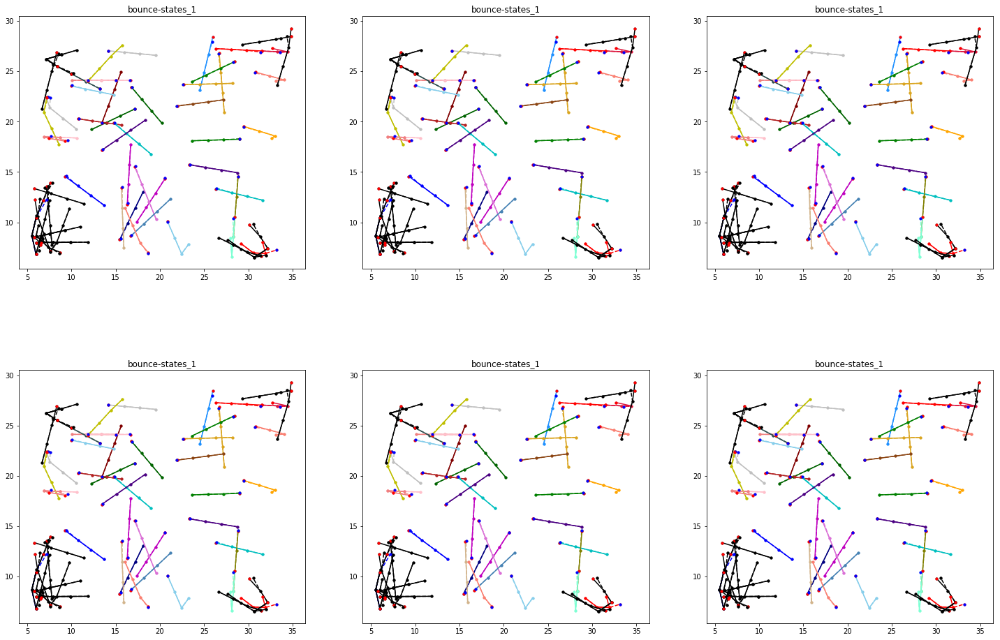

In [116]:
plot_individual_tasks_bounce(tasks_train, num_examples_show = 40, num_tasks_show = 6, master_model = master_model, num_shots = None, highlight_top = 20)

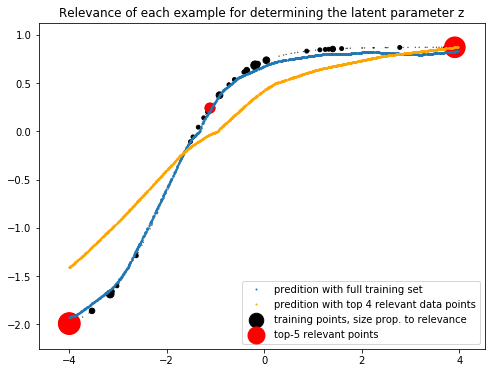

In [5]:
top = 3
plt.figure(figsize = (8,6))
# Get sorted data points according to relevance:
relevance_train = get_relevance(X_train, y_train, statistics_Net)
X_sorted, y_sorted, relevance_sorted = sort_datapoints(X_train, y_train, relevance_train, top = top)

plt.scatter(X_train.data.numpy(), y_train.data.numpy(),  s = 15 * relevance_train + 0.1, c = "k", label = "training points, size prop. to relevance")
plt.scatter(X_sorted, y_sorted, s = 17 * relevance_sorted + 0.1, c = "r", label = "top-5 relevant points")

# Plot prediction with full training set:
statistics = statistics_Net.forward_inputs(X_train, y_train)
y_pred = generative_Net(X_test, statistics[0])
plt.plot(X_test.data.numpy(), y_pred.data.numpy(), ".", markersize = 2, label = "predition with full training set")

# Plot prediction with top few data points
statistics_few = statistics_Net.forward_inputs(X_sorted, y_sorted)
y_pred_few = generative_Net(X_test, statistics_few[0])
plt.plot(X_test.data.numpy(), y_pred_few.data.numpy(), ".", color = "orange", markersize = 2, label = "predition with top 4 relevant data points")
plt.title("Relevance of each example for determining the latent parameter z")
plt.legend()
plt.show()

In [8]:
X_to_predict = -2
X_to_predict = Variable(torch.FloatTensor([[X_to_predict]]))
dataset = tasks_test[sample_task_id][0]
(X_train, y_train), (X_test, y_test) = dataset

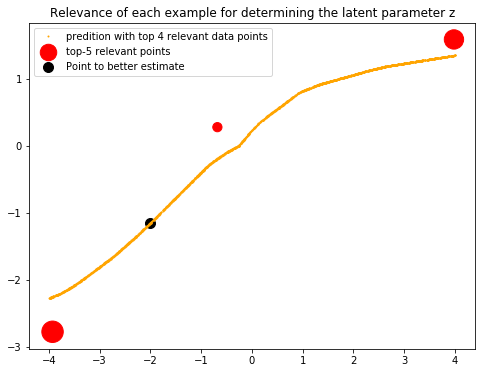

In [9]:
# Only plotting predictions with three points:
top = 3
plt.figure(figsize = (8,6))
# Get sorted data points according to relevance:
relevance_train = get_relevance(X_train, y_train, statistics_Net)
X_sorted, y_sorted, relevance_sorted = sort_datapoints(X_train, y_train, relevance_train, top = top)

plt.scatter(X_sorted, y_sorted, s = 17 * relevance_sorted + 0.1, c = "r", label = "top-5 relevant points")


# Plot prediction with top few data points
statistics_few = statistics_Net.forward_inputs(X_sorted, y_sorted)[0]
y_pred_few = generative_Net(X_test, statistics_few)

y_to_predict_estimate = generative_Net(X_to_predict, statistics_few)
plt.scatter(X_to_predict.data.numpy(), y_to_predict_estimate.data.numpy(), s = 100, c = "k", label = "Point to better estimate")

plt.plot(X_test.data.numpy(), y_pred_few.data.numpy(), ".", color = "orange", markersize = 2, label = "predition with top 4 relevant data points")
plt.title("Relevance of each example for determining the latent parameter z")
plt.legend()
plt.show()

In [11]:
X_current = X_sorted
y_current = y_sorted
relevance_current = relevance_sorted

In [ ]:
for i in range(10):
    X_current, y_current = measure_next_point(X_to_predict, X_current, y_current, relevance_current, dataset)